# Data mining project 22/23

## Import libraries

In [ ]:
#pip install --upgrade scikit-learn

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
# zscore
from scipy.stats import zscore
# kmeans, bisecting kmeans, dbscan, hierarchical (sklearn)
from sklearn.cluster import KMeans
# scaling, normalization
from sklearn.preprocessing import StandardScaler, MinMaxScaler
# distance matrix (dbscan elbow, hierarchical)
from scipy.spatial.distance import pdist, squareform

In [2]:
from sklearn.metrics import *
from sklearn.cluster import BisectingKMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering
from sklearn.neighbors import kneighbors_graph
from sklearn.neighbors import NearestNeighbors

In [3]:
df_ini = pd.read_csv("ravdess_features.csv") # read csv file (dataset)

In [4]:
df = df_ini.copy()

In [5]:
df.shape # shape of dataset (rows, columns)

(2452, 38)

In [6]:
nunique = df.nunique()
nunique

modality                  1
vocal_channel             2
emotion                   8
emotional_intensity       2
statement                 2
repetition                2
actor                    24
sex                       2
channels                  2
sample_width              1
frame_rate                1
frame_width               2
length_ms                95
frame_count             158
intensity               989
zero_crossings_sum     2176
mfcc_mean              2451
mfcc_std               2449
mfcc_min               2451
mfcc_max               2449
sc_mean                2451
sc_std                 2451
sc_min                 1431
sc_max                 2423
sc_kur                 2451
sc_skew                2451
stft_mean              2451
stft_std               2451
stft_min               1431
stft_max                  1
stft_kur               2451
stft_skew              2451
mean                   2450
std                    2451
min                    2148
max                 

In [7]:
to_delete = []
for key, value in nunique.items():
    if(value == 1):
        print("To delete: ", key)
        to_delete.append(key)
    if(value > 1 and value < 100):
        print("To evaluate: ", key)

To delete:  modality
To evaluate:  vocal_channel
To evaluate:  emotion
To evaluate:  emotional_intensity
To evaluate:  statement
To evaluate:  repetition
To evaluate:  actor
To evaluate:  sex
To evaluate:  channels
To delete:  sample_width
To delete:  frame_rate
To evaluate:  frame_width
To evaluate:  length_ms
To delete:  stft_max


In [8]:
df = df.drop(columns=to_delete)

In [9]:
df = df.drop(columns='mean')

In [10]:
def get_emotion_positivity(x):
    if(x == 'fearful' or x == 'angry' or x =='sad' or x == 'disgust'):
        return -1;
    if(x == 'happy' or x == 'surprised'): # is calm positive?
        return 1;
    return 0;

df["emotion_positivity"] = df["emotion"].map(get_emotion_positivity)
df["emotion_positivity"]

0      -1
1      -1
2       1
3       1
4       1
       ..
2447    0
2448    0
2449   -1
2450    1
2451    0
Name: emotion_positivity, Length: 2452, dtype: int64

In [11]:
df["length"] = df["length_ms"] / 1000
df = df.drop(columns=["length_ms"])

In [12]:
#replacement of one of the variables
df["zero_crossings_rate"] = df["zero_crossings_sum"] / df["length"]
df["zero_crossings_rate"]

0       4547.765587
1       3561.987705
2       4008.349390
3       3194.116030
4       3437.102634
           ...     
2447    2143.539631
2448    2148.885159
2449    1863.905325
2450    2599.946481
2451    2456.867344
Name: zero_crossings_rate, Length: 2452, dtype: float64

In [13]:
df = df.drop(columns=["zero_crossings_sum"])

In [14]:
df['statement'] = df['statement'].replace(['Dogs are sitting by the door'], '0')
df['statement'] = df['statement'].replace(['Kids are talking by the door'], '1')

## Pairwise correlations and eventual elimination of variables

We drop _frame_rate_ column because there is just _length_ that measures the length of audio and of course _frame_rate_ is proportional to _length_.

In [15]:
df_num = df.copy() # copy of all numerical and ratio-scaled attributes

In [16]:
df_num = df_num.drop(columns = ["vocal_channel", "emotion", "emotional_intensity", "statement", "repetition", "actor", "sex", "channels", "frame_width"])
df_num.T

,0,1,2,3,4,5,6,7,8,9,...,2442,2443,2444,2445,2446,2447,2448,2449,2450,2451
frame_count,179379.000000,187387.000000,224224.000000,174575.000000,211411.000000,171371.000000,180980.000000,164965.000000,180981.000000,209810.000000,...,233834.000000,184184.000000,168168.000000,155356.000000,240240.000000,221021.000000,200200.000000,251451.000000,179379.000000,184184.000000
intensity,-36.793432,NaN,-32.290737,-49.019839,-31.214503,-36.312244,NaN,-49.095042,-45.906837,NaN,...,-29.512788,-47.141749,NaN,NaN,-36.811776,NaN,-43.342901,NaN,-45.751265,-40.018044
mfcc_mean,-33.485947,-29.502108,-30.532463,-36.059555,-31.405996,-30.500889,-30.177172,-36.048576,-33.899364,-29.462296,...,-22.787794,-28.682810,-25.771196,-25.815453,-24.805220,-30.225578,-31.160332,-26.135280,-28.242815,-29.019236
mfcc_std,134.654860,130.485630,126.577110,159.725160,122.125824,132.581730,139.507460,167.652130,159.197620,116.833786,...,113.349300,154.492430,157.241900,147.116780,138.314590,158.845500,157.499700,138.133210,159.943400,149.188950
mfcc_min,-755.223450,-713.985600,-726.060360,-842.946350,-700.702760,-719.165470,-767.193600,-910.497440,-879.260000,-645.926200,...,-659.389100,-859.211730,-821.105700,-798.653700,-782.337340,-855.924200,-825.374100,-768.365360,-868.095760,-799.510100
mfcc_max,171.690920,205.007700,165.456530,190.036090,161.134000,213.681920,228.327150,220.383730,207.632170,167.967530,...,202.859280,197.396960,251.228530,214.569700,219.623290,208.184970,220.794900,235.539380,219.843500,219.527800
sc_mean,5792.550744,5197.620555,4830.743037,5376.446478,5146.012474,4251.116912,5718.247598,6085.206268,6349.352394,5486.705835,...,3918.703428,4659.880471,5604.753887,4645.862618,4369.123635,5886.647366,6602.742127,4654.156076,5524.736973,6082.676123
sc_std,3328.055457,4040.931570,3332.131300,4053.663073,3442.724109,3833.178183,4008.803978,3737.829447,4014.630498,3602.202957,...,3149.520778,3663.074145,3300.232336,3055.279038,3194.246906,4114.260257,4191.727090,4231.511986,3596.031841,3963.725117
sc_min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,991.364402,...,979.297084,0.000000,818.317638,511.528673,840.068705,0.000000,0.000000,0.000000,760.822547,0.000000
sc_max,13541.959028,12000.290443,12007.751173,12048.223893,12025.582707,12063.200741,12840.225341,12000.006162,12081.507260,11999.999998,...,11981.598019,12192.374121,10834.058255,10919.537644,11191.358052,12210.517144,12064.561791,12207.179884,11981.912464,12199.773419


In [ ]:
#sns.pairplot(df_num)
#plt.savefig("pairplot_df_num.png")
#plt.show()

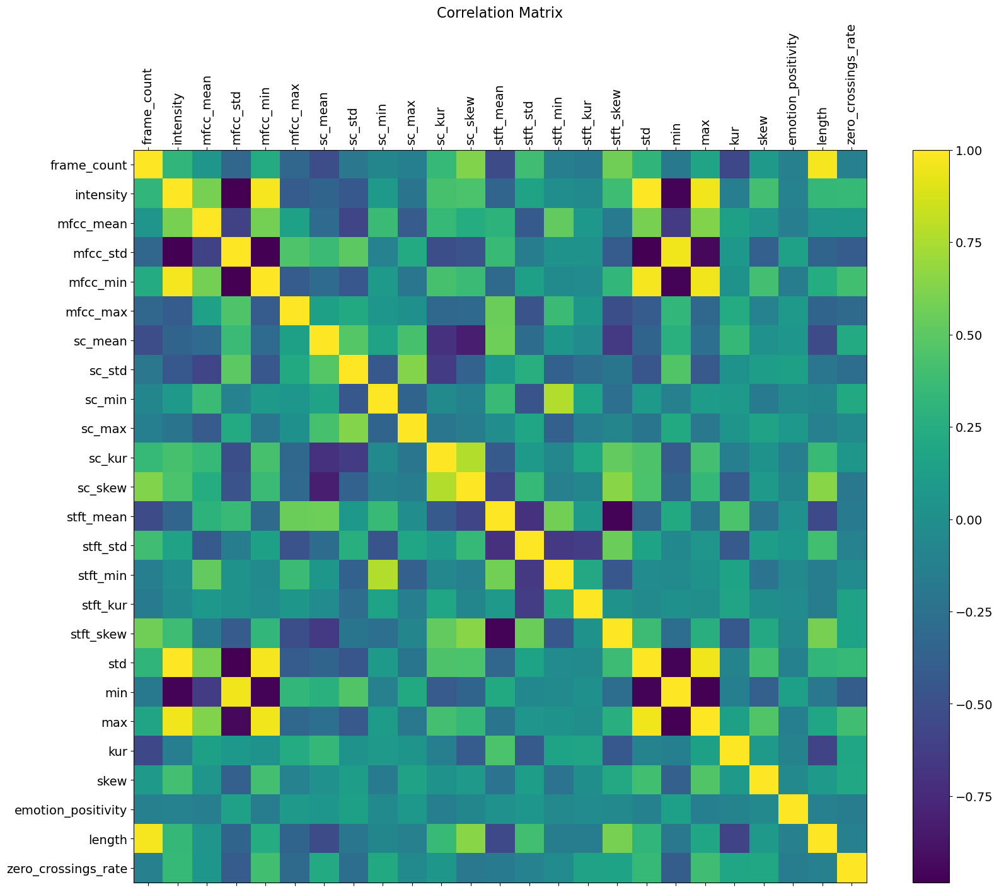

In [17]:
f = plt.figure(figsize=(19, 15))
plt.matshow(df_num.corr("spearman"), fignum=f.number)
plt.xticks(range(df_num.select_dtypes(['number']).shape[1]), df_num.select_dtypes(['number']).columns, fontsize=14, rotation=90)
plt.yticks(range(df_num.select_dtypes(['number']).shape[1]), df_num.select_dtypes(['number']).columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

In [18]:
corr = df_num[["intensity", "mfcc_min", "min"]].corr("spearman")
corr.style.background_gradient(cmap='coolwarm')

,intensity,mfcc_min,min
intensity,1.000000,0.972007,-0.961140
mfcc_min,0.972007,1.000000,-0.968147
min,-0.961140,-0.968147,1.000000


In [19]:
eps = 0.90
print("CORRELATION > ",eps,":")
corr = (df_num.corr())
for index, row in corr.iterrows():
    for k, v in row.items():
        if(v > eps and index != k):
            print(index, k, corr[index][k])
    
print("")
print("CORRELATION < -",eps,":")
neg_corr = (df_num.corr())
for index, row in neg_corr.iterrows():
    for k, v in row.items():
        if(v  < -eps and index != k):
            print(index, k, v)

CORRELATION >  0.9 :
intensity mfcc_min 0.9739806185030634
mfcc_min intensity 0.9739806185030634
std max 0.9528208795190594
max std 0.9528208795190594

CORRELATION < - 0.9 :
intensity mfcc_std -0.9787440246139893
mfcc_std intensity -0.9787440246139893
mfcc_std mfcc_min -0.9760982975983237
mfcc_min mfcc_std -0.9760982975983237
stft_mean stft_skew -0.9699787898983478
stft_skew stft_mean -0.9699787898983478
std min -0.9558475650435299
min std -0.9558475650435299
min max -0.9798894359969872
max min -0.9798894359969872


In [20]:
#df_num = df_num.drop(columns=["mfcc_min", "max", "mfcc_std", "stft_skew", "min"])
df_num.T

,0,1,2,3,4,5,6,7,8,9,...,2442,2443,2444,2445,2446,2447,2448,2449,2450,2451
frame_count,179379.000000,187387.000000,224224.000000,174575.000000,211411.000000,171371.000000,180980.000000,164965.000000,180981.000000,209810.000000,...,233834.000000,184184.000000,168168.000000,155356.000000,240240.000000,221021.000000,200200.000000,251451.000000,179379.000000,184184.000000
intensity,-36.793432,NaN,-32.290737,-49.019839,-31.214503,-36.312244,NaN,-49.095042,-45.906837,NaN,...,-29.512788,-47.141749,NaN,NaN,-36.811776,NaN,-43.342901,NaN,-45.751265,-40.018044
mfcc_mean,-33.485947,-29.502108,-30.532463,-36.059555,-31.405996,-30.500889,-30.177172,-36.048576,-33.899364,-29.462296,...,-22.787794,-28.682810,-25.771196,-25.815453,-24.805220,-30.225578,-31.160332,-26.135280,-28.242815,-29.019236
mfcc_std,134.654860,130.485630,126.577110,159.725160,122.125824,132.581730,139.507460,167.652130,159.197620,116.833786,...,113.349300,154.492430,157.241900,147.116780,138.314590,158.845500,157.499700,138.133210,159.943400,149.188950
mfcc_min,-755.223450,-713.985600,-726.060360,-842.946350,-700.702760,-719.165470,-767.193600,-910.497440,-879.260000,-645.926200,...,-659.389100,-859.211730,-821.105700,-798.653700,-782.337340,-855.924200,-825.374100,-768.365360,-868.095760,-799.510100
mfcc_max,171.690920,205.007700,165.456530,190.036090,161.134000,213.681920,228.327150,220.383730,207.632170,167.967530,...,202.859280,197.396960,251.228530,214.569700,219.623290,208.184970,220.794900,235.539380,219.843500,219.527800
sc_mean,5792.550744,5197.620555,4830.743037,5376.446478,5146.012474,4251.116912,5718.247598,6085.206268,6349.352394,5486.705835,...,3918.703428,4659.880471,5604.753887,4645.862618,4369.123635,5886.647366,6602.742127,4654.156076,5524.736973,6082.676123
sc_std,3328.055457,4040.931570,3332.131300,4053.663073,3442.724109,3833.178183,4008.803978,3737.829447,4014.630498,3602.202957,...,3149.520778,3663.074145,3300.232336,3055.279038,3194.246906,4114.260257,4191.727090,4231.511986,3596.031841,3963.725117
sc_min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,991.364402,...,979.297084,0.000000,818.317638,511.528673,840.068705,0.000000,0.000000,0.000000,760.822547,0.000000
sc_max,13541.959028,12000.290443,12007.751173,12048.223893,12025.582707,12063.200741,12840.225341,12000.006162,12081.507260,11999.999998,...,11981.598019,12192.374121,10834.058255,10919.537644,11191.358052,12210.517144,12064.561791,12207.179884,11981.912464,12199.773419


## Fixing missing values

### Intensity 

In [21]:
df_m = df.copy()
v1 = df.iloc[6]['intensity']
nanv = str(v1)
def isNan(value):
    return str(value) == nanv

In [22]:
for lab, row in df_m.iterrows() :
    inte = row['intensity']
    if (row['emotional_intensity'] =='normal') and (isNan(inte) == True) :
        df_m.loc[lab, 'intensity'] = -40.578409
    if (row['emotional_intensity'] =='strong') and (isNan(inte) == True) :
        df_m.loc[lab, 'intensity'] = -34.271315

### Vocal channel

In [23]:
for lab, row in df_m.iterrows() :
    inte = row['intensity']
    if (row['emotion'] =='surprised') and (row['vocal_channel'] !='speech') :
        df_m.loc[lab, 'vocal_channel'] = 'speech'
    if (row['emotion'] =='disgust') and (row['vocal_channel'] !='speech') :
        df_m.loc[lab, 'vocal_channel'] = 'speech'

In [24]:
eps = 0.90
print("CORRELATION > ",eps,":")
corr = (df_m.corr())
for index, row in corr.iterrows():
    for k, v in row.items():
        if(v > eps and index != k):
            print(index, k, corr[index][k])
    
print("")
print("CORRELATION < -",eps,":")
neg_corr = (df_m.corr())
for index, row in neg_corr.iterrows():
    for k, v in row.items():
        if(v  < -eps and index != k):
            print(index, k, v)

CORRELATION >  0.9 :
channels frame_width 1.0
frame_width channels 1.0
std max 0.9528208795190594
max std 0.9528208795190594

CORRELATION < - 0.9 :
mfcc_std mfcc_min -0.9760982975983237
mfcc_min mfcc_std -0.9760982975983237
stft_mean stft_skew -0.9699787898983478
stft_skew stft_mean -0.9699787898983478
std min -0.9558475650435299
min std -0.9558475650435299
min max -0.9798894359969872
max min -0.9798894359969872


In [25]:
df_num2 = df_m.copy()
df_num2 = df_num2.drop(columns = ["vocal_channel", "emotion", "emotional_intensity", "statement", "repetition", "actor", "sex", "channels", "frame_width","mfcc_min", "max", "mfcc_std", "stft_skew", "min"])
df_num2 = df_num2.drop(columns = ['frame_count'])

## DBScan

In [26]:
df_copy = df_num.copy()
df_copy = df_copy.drop(columns = ['frame_count'])
df_copy = df_copy.drop(columns = ['intensity'])
df_copy.T

,0,1,2,3,4,5,6,7,8,9,...,2442,2443,2444,2445,2446,2447,2448,2449,2450,2451
mfcc_mean,-33.485947,-29.502108,-30.532463,-36.059555,-31.405996,-30.500889,-30.177172,-36.048576,-33.899364,-29.462296,...,-22.787794,-28.682810,-25.771196,-25.815453,-24.805220,-30.225578,-31.160332,-26.135280,-28.242815,-29.019236
mfcc_std,134.654860,130.485630,126.577110,159.725160,122.125824,132.581730,139.507460,167.652130,159.197620,116.833786,...,113.349300,154.492430,157.241900,147.116780,138.314590,158.845500,157.499700,138.133210,159.943400,149.188950
mfcc_min,-755.223450,-713.985600,-726.060360,-842.946350,-700.702760,-719.165470,-767.193600,-910.497440,-879.260000,-645.926200,...,-659.389100,-859.211730,-821.105700,-798.653700,-782.337340,-855.924200,-825.374100,-768.365360,-868.095760,-799.510100
mfcc_max,171.690920,205.007700,165.456530,190.036090,161.134000,213.681920,228.327150,220.383730,207.632170,167.967530,...,202.859280,197.396960,251.228530,214.569700,219.623290,208.184970,220.794900,235.539380,219.843500,219.527800
sc_mean,5792.550744,5197.620555,4830.743037,5376.446478,5146.012474,4251.116912,5718.247598,6085.206268,6349.352394,5486.705835,...,3918.703428,4659.880471,5604.753887,4645.862618,4369.123635,5886.647366,6602.742127,4654.156076,5524.736973,6082.676123
sc_std,3328.055457,4040.931570,3332.131300,4053.663073,3442.724109,3833.178183,4008.803978,3737.829447,4014.630498,3602.202957,...,3149.520778,3663.074145,3300.232336,3055.279038,3194.246906,4114.260257,4191.727090,4231.511986,3596.031841,3963.725117
sc_min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,991.364402,...,979.297084,0.000000,818.317638,511.528673,840.068705,0.000000,0.000000,0.000000,760.822547,0.000000
sc_max,13541.959028,12000.290443,12007.751173,12048.223893,12025.582707,12063.200741,12840.225341,12000.006162,12081.507260,11999.999998,...,11981.598019,12192.374121,10834.058255,10919.537644,11191.358052,12210.517144,12064.561791,12207.179884,11981.912464,12199.773419
sc_kur,-1.120769,-1.531204,-1.130153,-1.497765,-1.167544,-1.114527,-1.503746,-1.601514,-1.609622,-1.288444,...,-0.083404,-0.959309,-1.540621,-1.178478,-1.478019,-1.588861,-1.614582,-1.337419,-1.465594,-1.501387
sc_skew,0.250940,0.219582,0.436699,0.098802,0.496066,0.555198,0.092211,-0.112737,-0.072671,0.542700,...,1.129704,0.506089,-0.184184,0.421965,0.424980,0.184390,-0.113920,0.619346,0.206481,0.147574


In [27]:
df_num2.T

,0,1,2,3,4,5,6,7,8,9,...,2442,2443,2444,2445,2446,2447,2448,2449,2450,2451
intensity,-36.793432,-40.578409,-32.290737,-49.019839,-31.214503,-36.312244,-40.578409,-49.095042,-45.906837,-34.271315,...,-29.512788,-47.141749,-40.578409,-34.271315,-36.811776,-34.271315,-43.342901,-34.271315,-45.751265,-40.018044
mfcc_mean,-33.485947,-29.502108,-30.532463,-36.059555,-31.405996,-30.500889,-30.177172,-36.048576,-33.899364,-29.462296,...,-22.787794,-28.682810,-25.771196,-25.815453,-24.805220,-30.225578,-31.160332,-26.135280,-28.242815,-29.019236
mfcc_max,171.690920,205.007700,165.456530,190.036090,161.134000,213.681920,228.327150,220.383730,207.632170,167.967530,...,202.859280,197.396960,251.228530,214.569700,219.623290,208.184970,220.794900,235.539380,219.843500,219.527800
sc_mean,5792.550744,5197.620555,4830.743037,5376.446478,5146.012474,4251.116912,5718.247598,6085.206268,6349.352394,5486.705835,...,3918.703428,4659.880471,5604.753887,4645.862618,4369.123635,5886.647366,6602.742127,4654.156076,5524.736973,6082.676123
sc_std,3328.055457,4040.931570,3332.131300,4053.663073,3442.724109,3833.178183,4008.803978,3737.829447,4014.630498,3602.202957,...,3149.520778,3663.074145,3300.232336,3055.279038,3194.246906,4114.260257,4191.727090,4231.511986,3596.031841,3963.725117
sc_min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,991.364402,...,979.297084,0.000000,818.317638,511.528673,840.068705,0.000000,0.000000,0.000000,760.822547,0.000000
sc_max,13541.959028,12000.290443,12007.751173,12048.223893,12025.582707,12063.200741,12840.225341,12000.006162,12081.507260,11999.999998,...,11981.598019,12192.374121,10834.058255,10919.537644,11191.358052,12210.517144,12064.561791,12207.179884,11981.912464,12199.773419
sc_kur,-1.120769,-1.531204,-1.130153,-1.497765,-1.167544,-1.114527,-1.503746,-1.601514,-1.609622,-1.288444,...,-0.083404,-0.959309,-1.540621,-1.178478,-1.478019,-1.588861,-1.614582,-1.337419,-1.465594,-1.501387
sc_skew,0.250940,0.219582,0.436699,0.098802,0.496066,0.555198,0.092211,-0.112737,-0.072671,0.542700,...,1.129704,0.506089,-0.184184,0.421965,0.424980,0.184390,-0.113920,0.619346,0.206481,0.147574
stft_mean,0.415250,0.417488,0.379758,0.407277,0.415974,0.349669,0.476312,0.487306,0.535030,0.506043,...,0.434530,0.493316,0.647158,0.575689,0.466211,0.573838,0.591010,0.467994,0.578854,0.554946


### Kth neighbor distance 

In [28]:
st = StandardScaler()
stdDf = pd.DataFrame(st.fit_transform(df_copy), columns=df_copy.columns)

In [ ]:
#df_copyn = StandardScaler().fit_transform(df_copy) this doesn't give a dataframe

In [ ]:
#another way to scale the data
#df_copyn = pd.DataFrame(st.fit_transform(df_copy), columns=df_copy.columns)

#### Option 1 

In [52]:
dist = pdist(stdDf, 'euclidean')
dist = squareform(dist)
k=5
kth_distances = []
for d in dist:  # d is a vector containing distances between the ith record and all the others
    index_kth_distance = np.argsort(d)[k]  # take the index of the kth nearest neighbor
    kth_distances.append(d[index_kth_distance])  # store the distance in a list

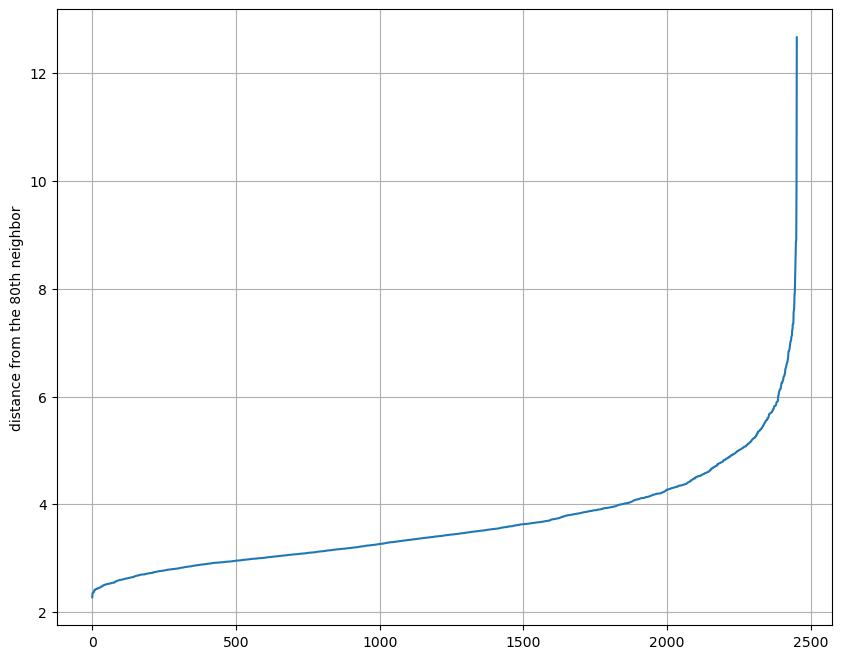

In [53]:
plt.figure(figsize=(10,8))
plt.plot(range(0, len(kth_distances)), sorted(kth_distances))
plt.ylabel('distance from the {}th neighbor'.format(k))
plt.grid()         
plt.show()

#### Option 2 

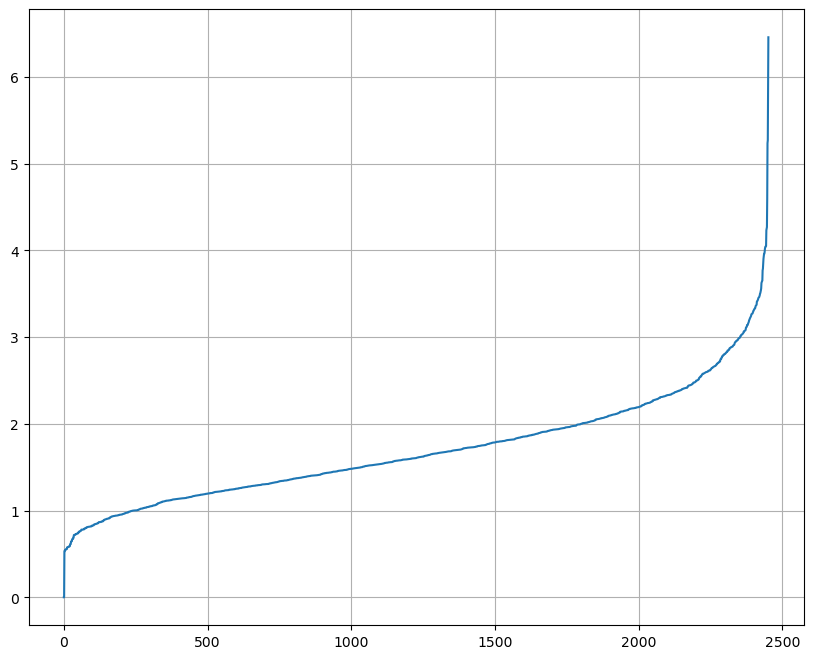

In [39]:
nn = NearestNeighbors(n_neighbors=201, metric='euclidean').fit(stdDf)
distances, indices = nn.kneighbors(stdDf)

distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.figure(figsize=(10,8))
plt.plot(distances)
plt.grid()
plt.show()


In [54]:
min_samples = np.arange(5,90,5)
eps = np.arange(2.2,6, 0.1)
output = []
for ms in min_samples:
    for ep in eps:
        labels = DBSCAN(min_samples=ms, eps = ep).fit(stdDf).labels_
        n_l = len(set(labels))
        if  n_l!= 2 and  n_l != 1:
            score = silhouette_score(stdDf, labels)
            output.append((ms, ep, score))

In [55]:
min_samples, eps, score = sorted(output, key=lambda x:x[-1])[-1]
print(f"Best silhouette_score: {score}")
print(f"min_samples: {min_samples}")
print(f"eps: {round(eps,0)}")

Best silhouette_score: 0.22912251300538178
min_samples: 5
eps: 3.0


### DBScan

In [71]:
#DBScan for the df without intensity
def DBScanTest(var1,var2):
    df_train = stdDf[[var1,var2]]
    
    dbscan = DBSCAN(eps=0.6, min_samples=5, metric='euclidean')
    dbscan.fit(df_train)

    hist, bins = np.histogram(dbscan.labels_, bins=range(-1, len(set(dbscan.labels_)) + 1))

    labels_c = dict(zip(bins, hist))
#    print(labels_c)
#    val_silh = silhouette_score(df_train, dbscan.labels_)
    
    df_clusters = df_train.copy()
    df_clusters['Labels'] = dbscan.labels_
#    print(df_clusters)

    if len(set(dbscan.labels_))!= 1:
        print('silhouette', silhouette_score(df_train, dbscan.labels_))
        sns.scatterplot(data=df_clusters, x=var1, y=var2, hue=dbscan.labels_, 
        style=dbscan.labels_, palette="bright")
        plt.show()
#        return 1
    else:
        print('labels', labels_c)
#        return 0

labels {-1: 0, 0: 2452}
labels {-1: 0, 0: 2452}
labels {-1: 0, 0: 2452}
silhouette 0.4450736372362226


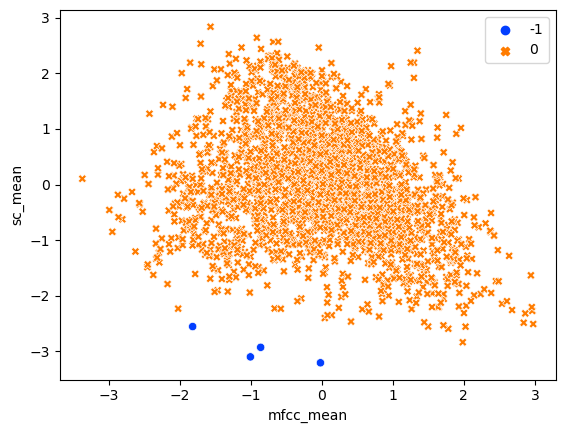

labels {-1: 0, 0: 2452}
labels {-1: 0, 0: 2452}
silhouette 0.6063227783467989


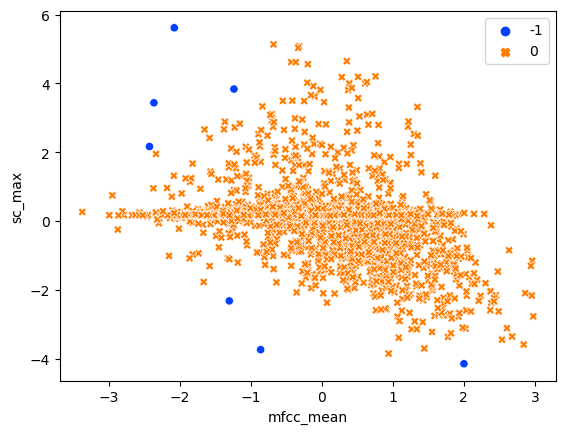

silhouette 0.7223502993021151


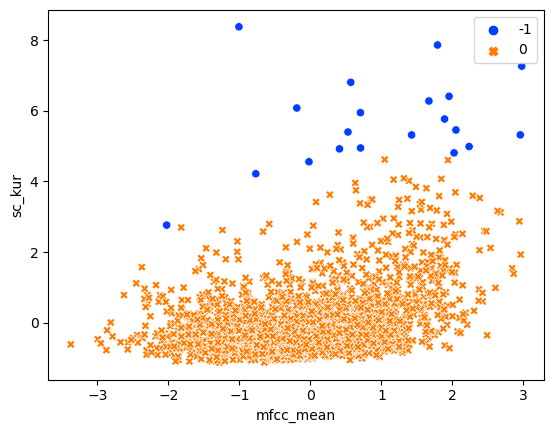

silhouette 0.5845918834163016


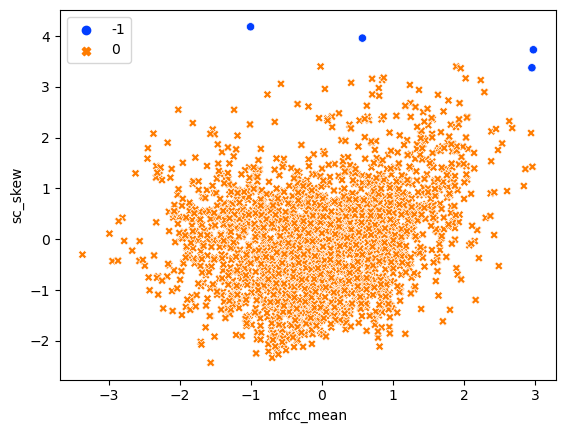

silhouette 0.43550780349713347


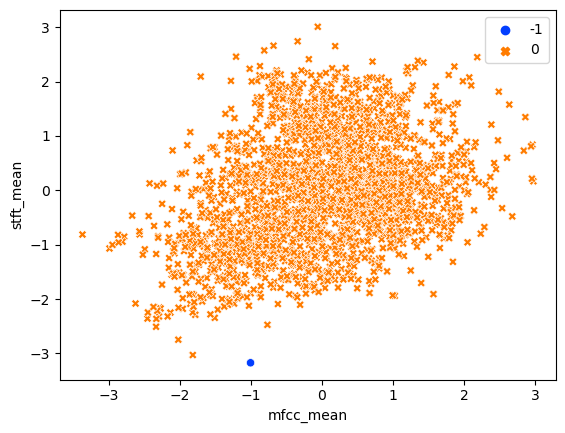

silhouette 0.5467774373936617


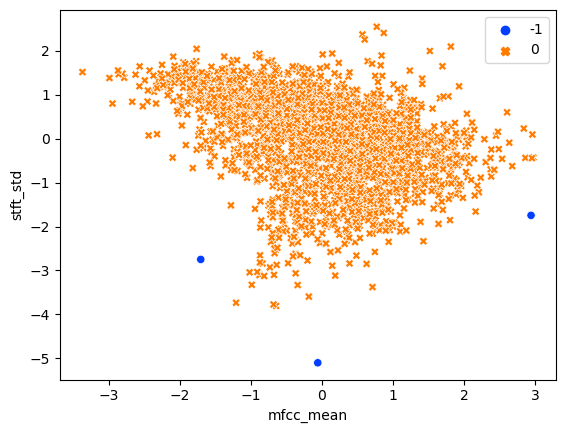

silhouette 0.77629958781789


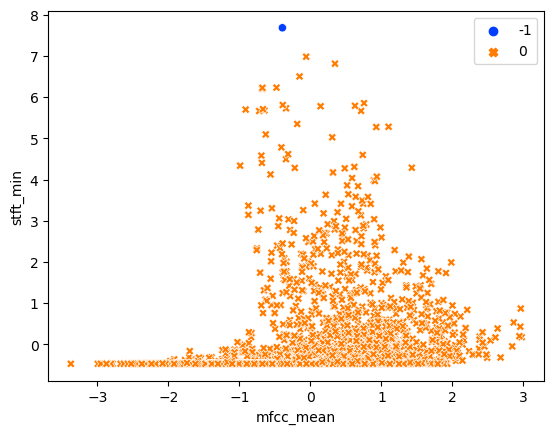

silhouette 0.6937152987536102


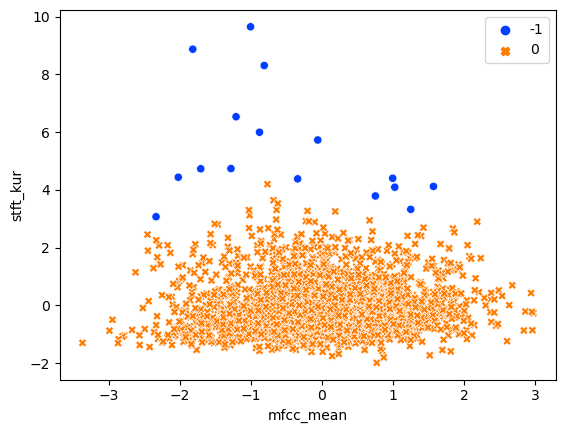

silhouette 0.5622607044193855


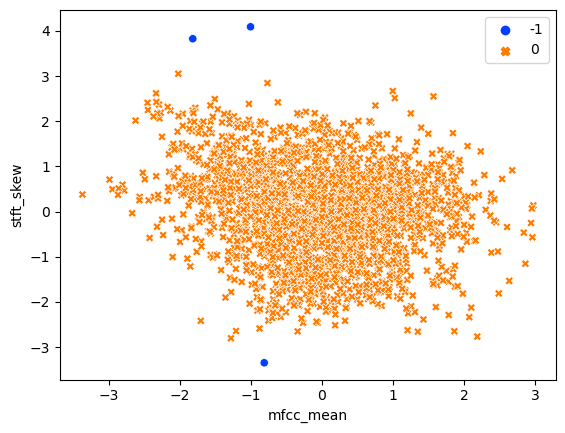

silhouette 0.7148118119474486


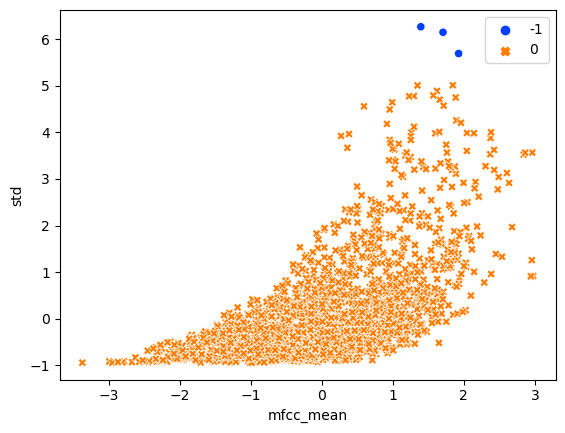

labels {-1: 0, 0: 2452}
silhouette 0.44817586901795237


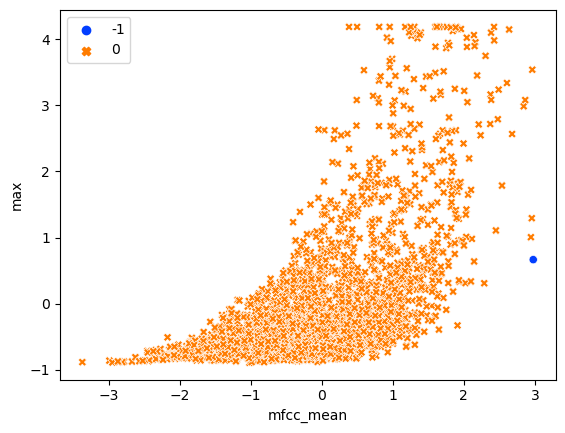

silhouette 0.6769834991217101


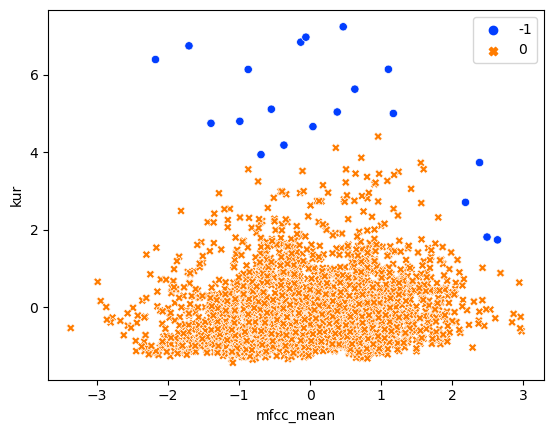

silhouette 0.5780714818213828


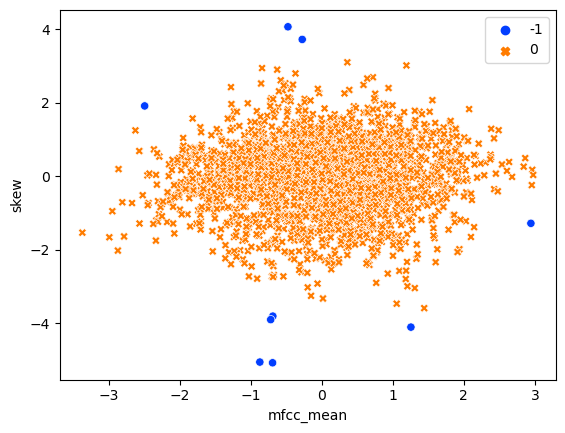

silhouette 0.40137927347788943


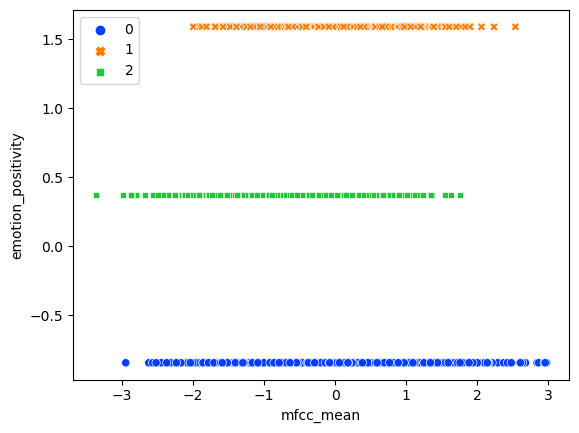

silhouette 0.5016615554554484


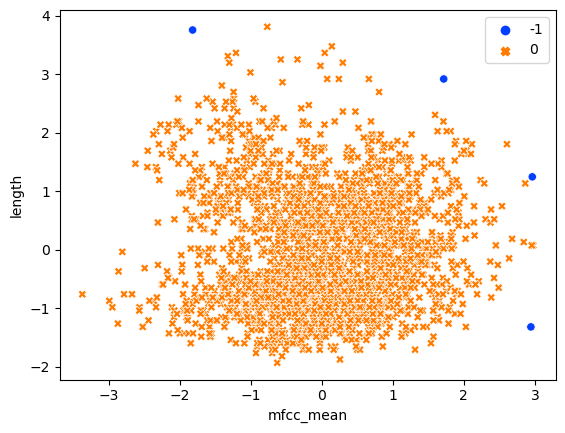

silhouette 0.6868250604274853


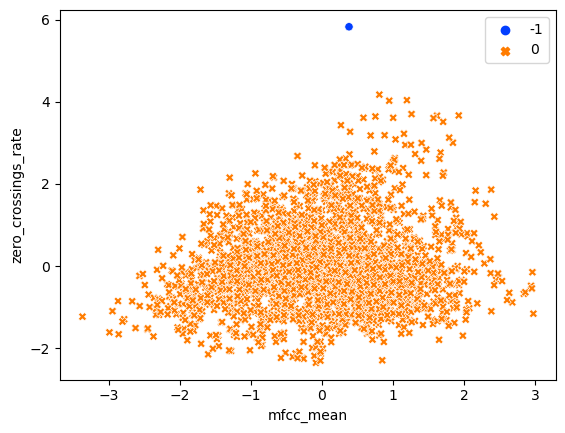

labels {-1: 0, 0: 2452}
labels {-1: 0, 0: 2452}
silhouette 0.4634456534427818


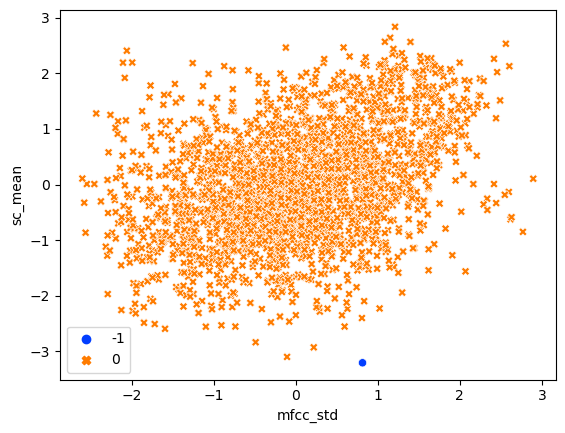

labels {-1: 0, 0: 2452}
labels {-1: 0, 0: 2452}
silhouette 0.5520220792465391


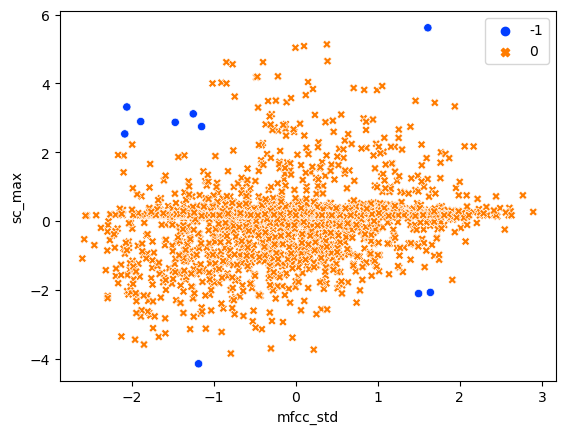

silhouette 0.7119059604116547


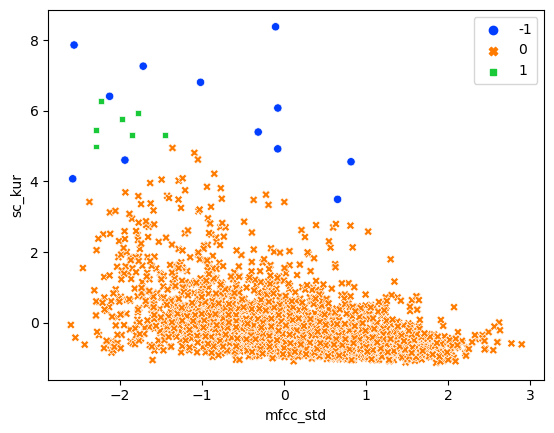

silhouette 0.5594122945781872


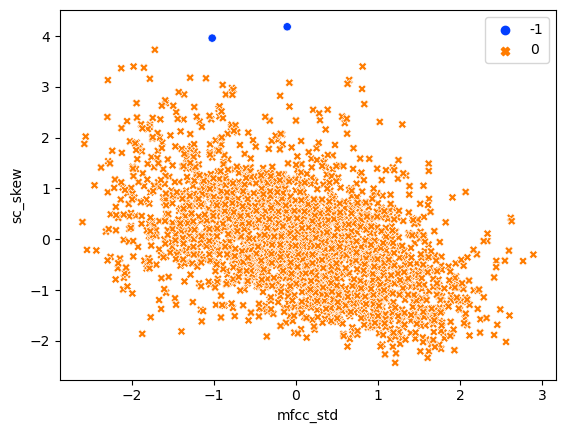

silhouette 0.4239047201131886


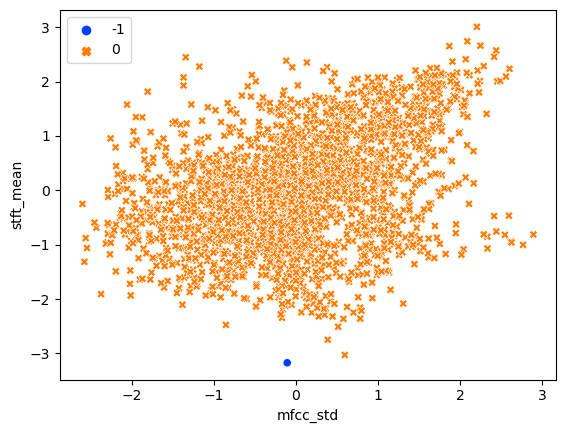

silhouette 0.6630932714685814


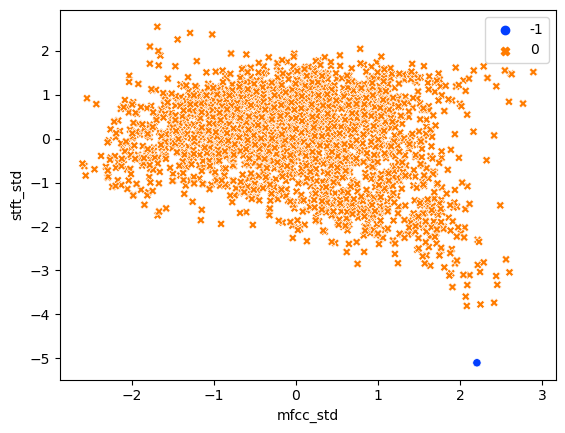

silhouette 0.7370332465362527


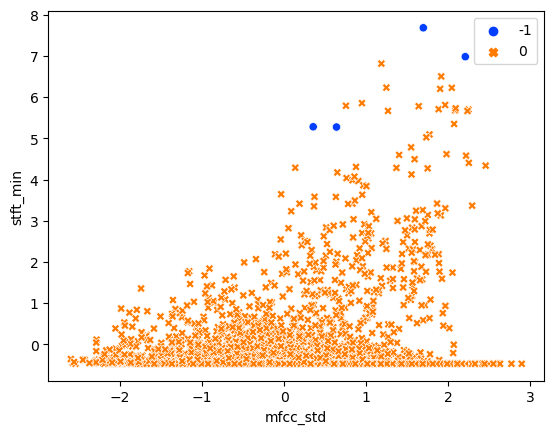

silhouette 0.6978259198081957


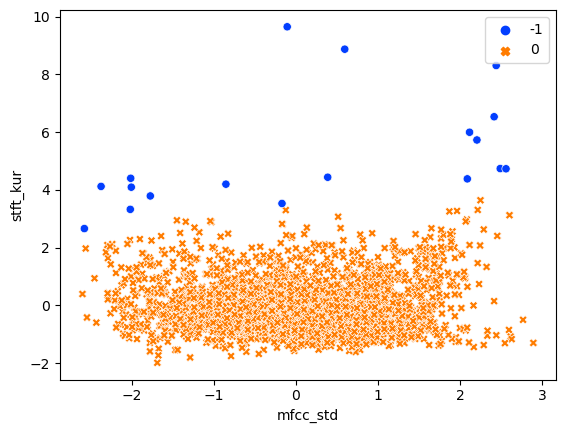

silhouette 0.513623132003954


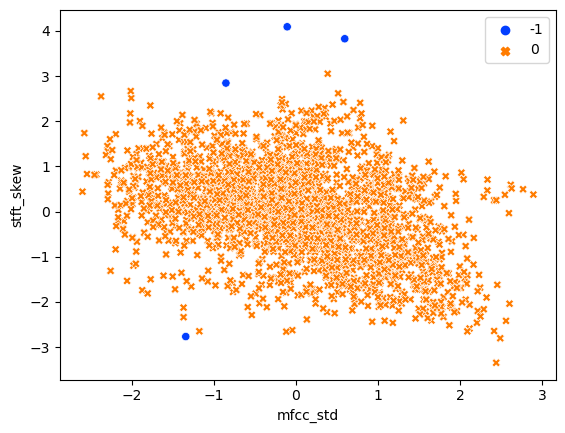

silhouette 0.7340412066200109


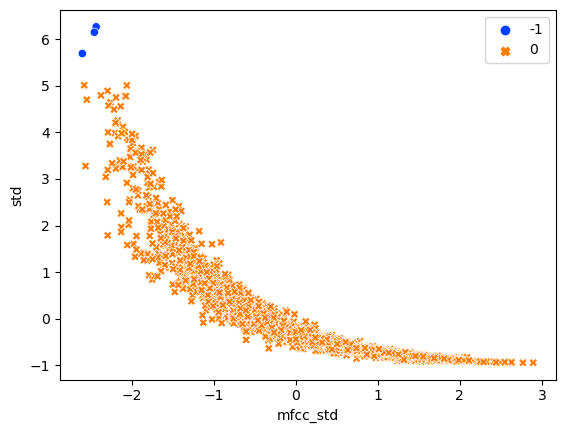

labels {-1: 0, 0: 2452}
labels {-1: 0, 0: 2452}
silhouette 0.569317008382302


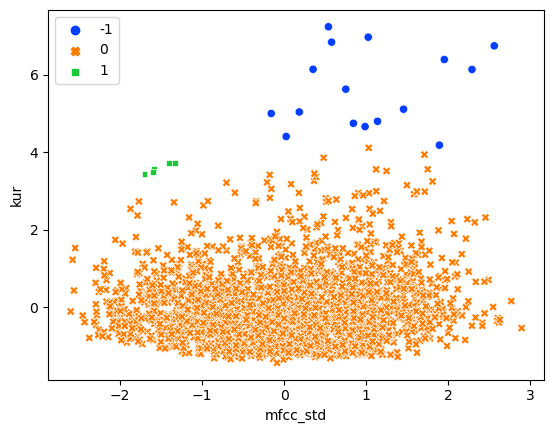

silhouette 0.6016408464583078


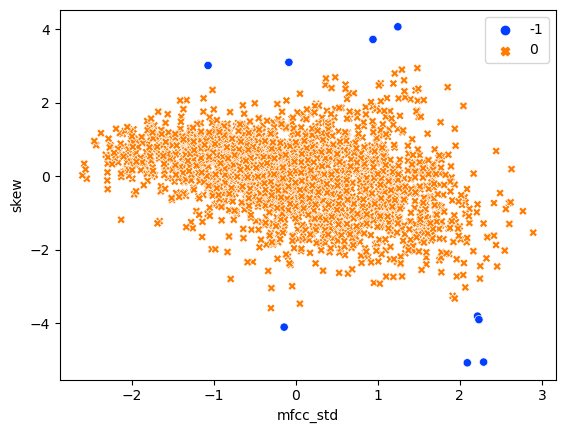

silhouette 0.4273923512308587


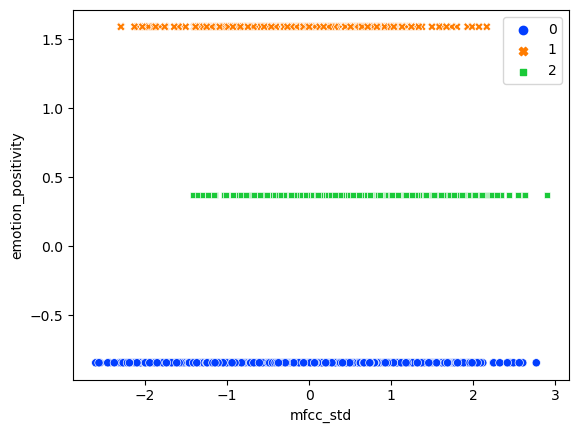

silhouette 0.4861014493262304


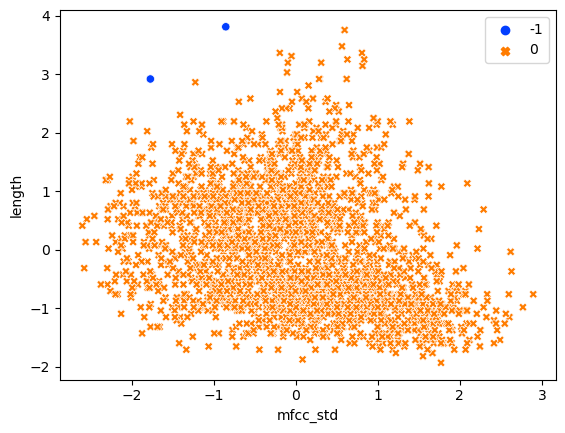

silhouette 0.5340400051731111


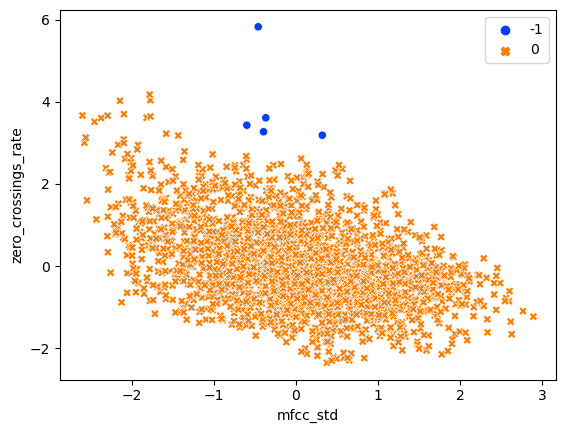

silhouette 0.42388690821926867


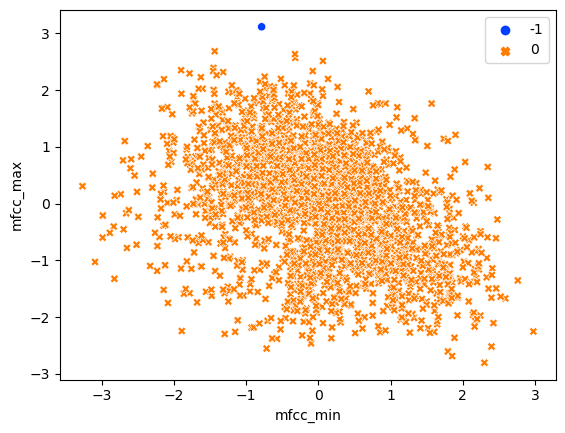

silhouette 0.46469989363880804


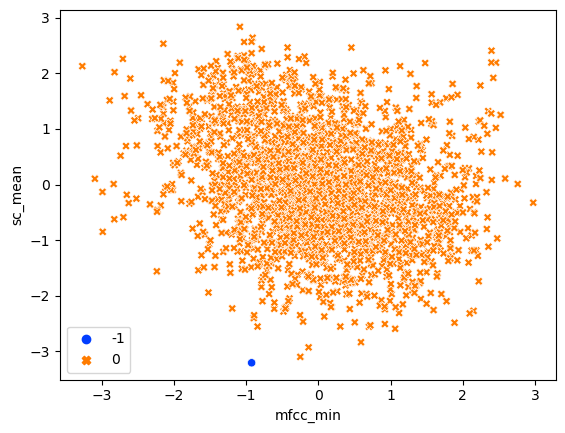

silhouette 0.49629701617203703


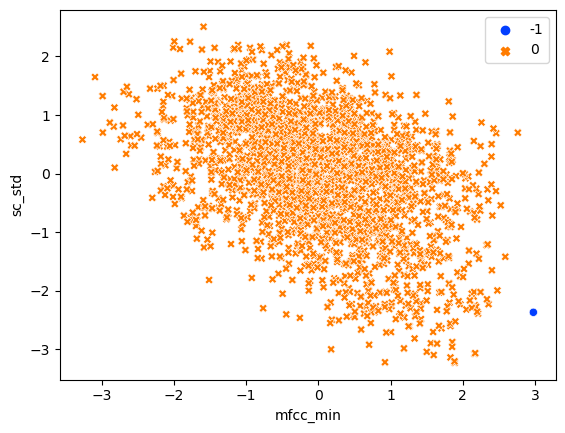

labels {-1: 0, 0: 2452}
silhouette 0.5350998640889351


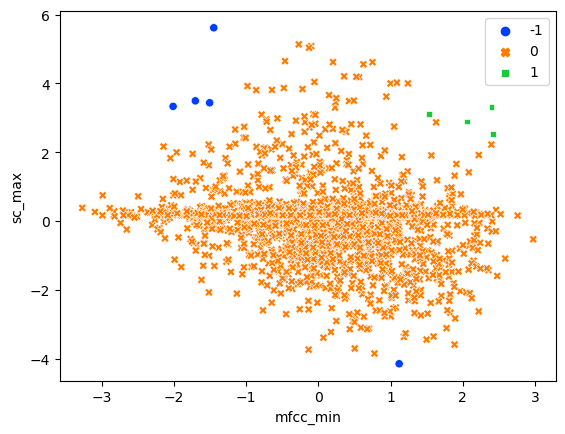

silhouette 0.7193658205571503


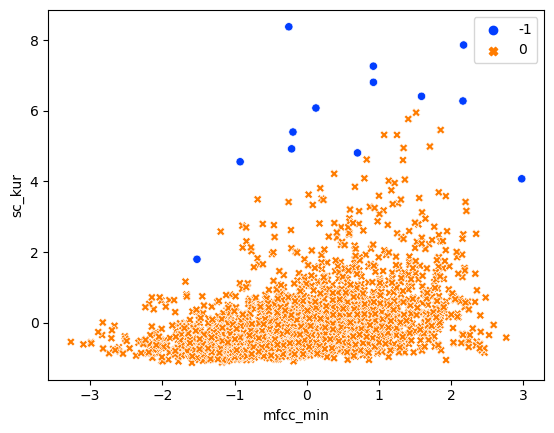

silhouette 0.5371458570520742


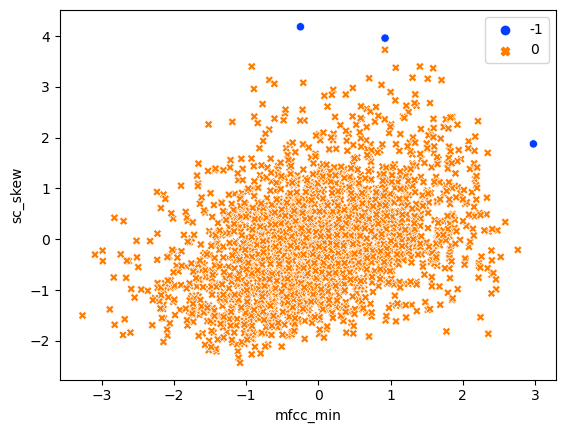

labels {-1: 0, 0: 2452}
silhouette 0.5854341307278899


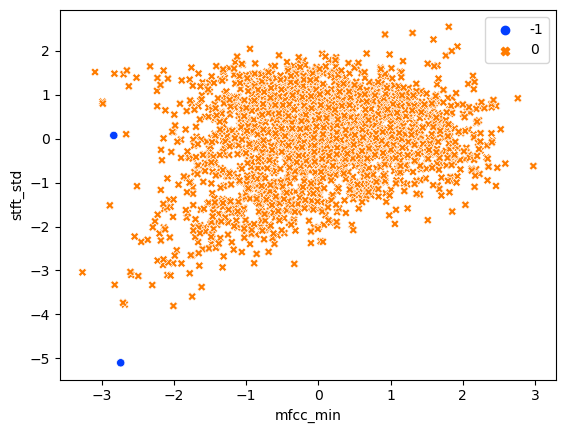

silhouette 0.687940302494674


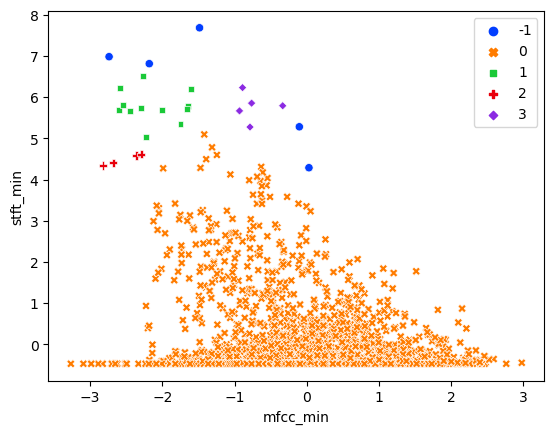

silhouette 0.6921375749755089


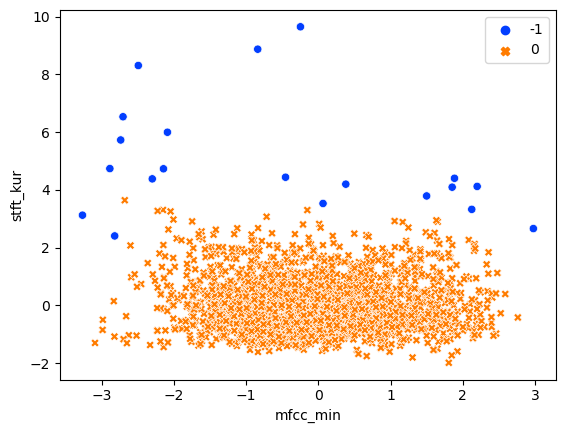

silhouette 0.5540408822533174


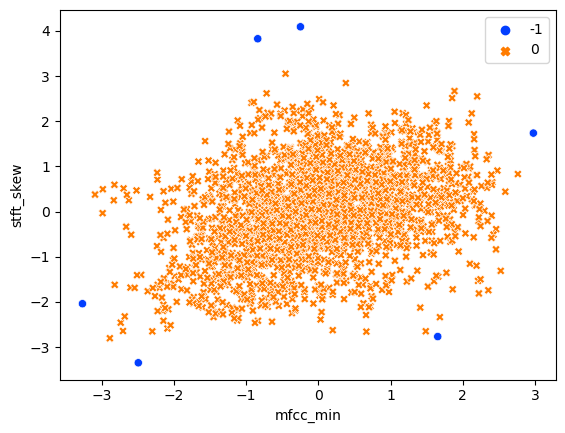

silhouette 0.7335438024779903


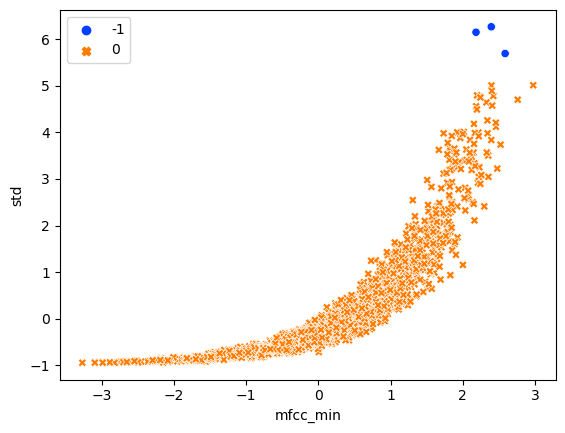

labels {-1: 0, 0: 2452}
labels {-1: 0, 0: 2452}
silhouette 0.571150270937651


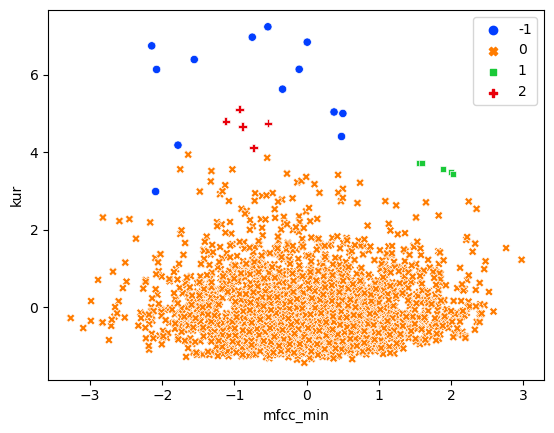

silhouette 0.5940397673799878


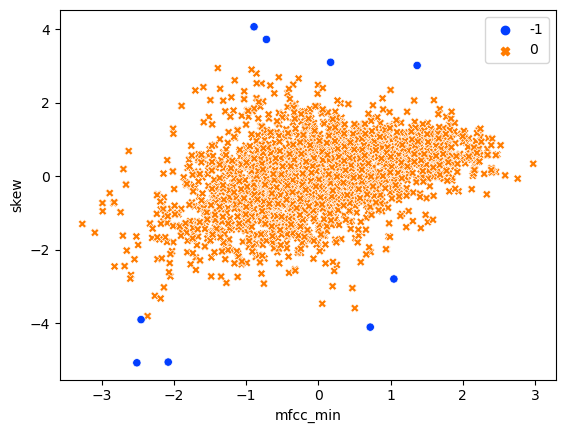

silhouette 0.444007536657296


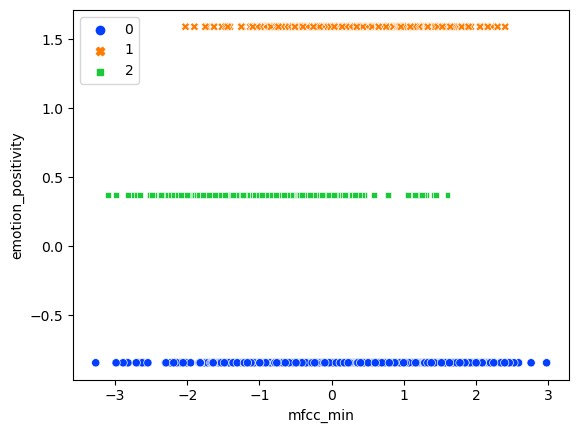

silhouette 0.42165893573883256


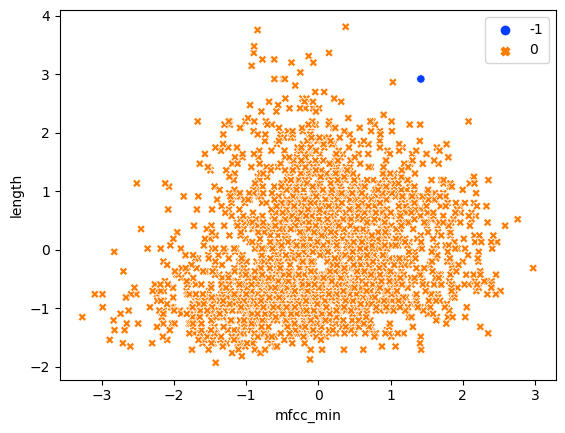

silhouette 0.5549876900420145


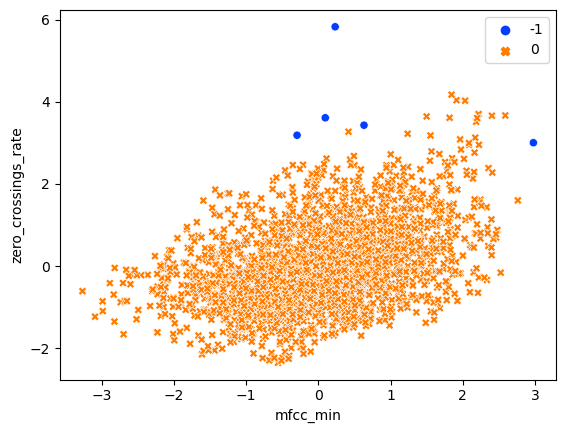

silhouette 0.4573173299803327


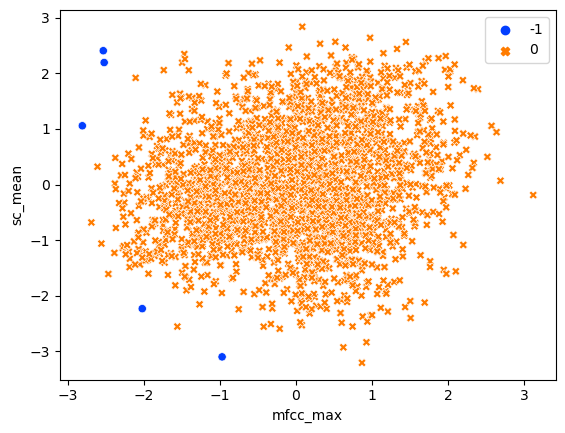

silhouette 0.5198364470522895


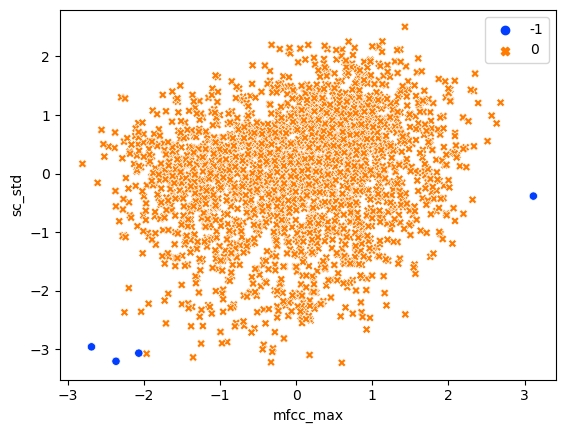

labels {-1: 0, 0: 2452}
silhouette 0.6245907214932965


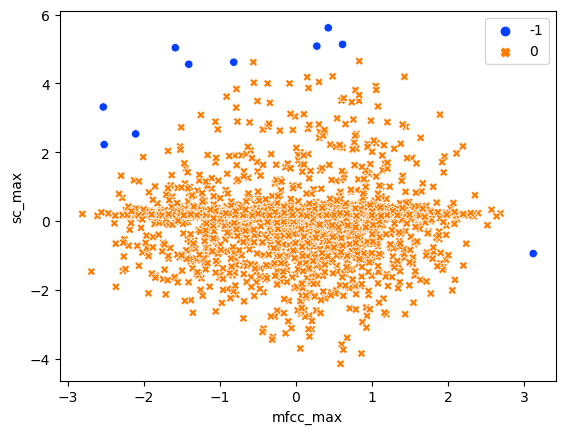

silhouette 0.705898213746199


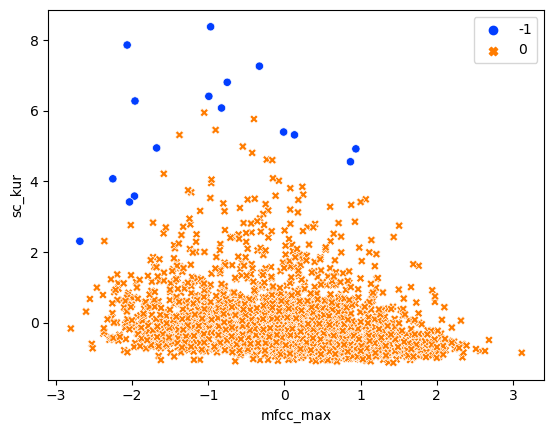

silhouette 0.5671070070426858


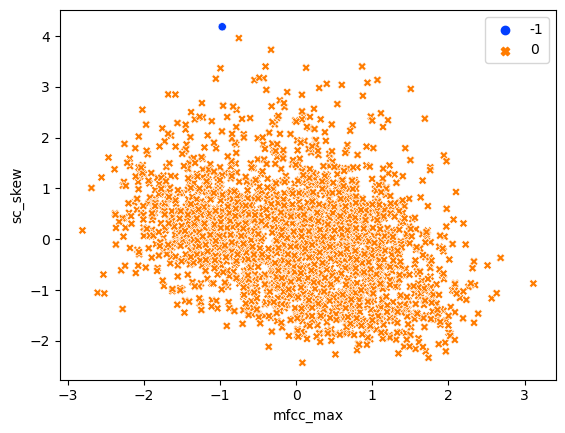

silhouette 0.4878467849372532


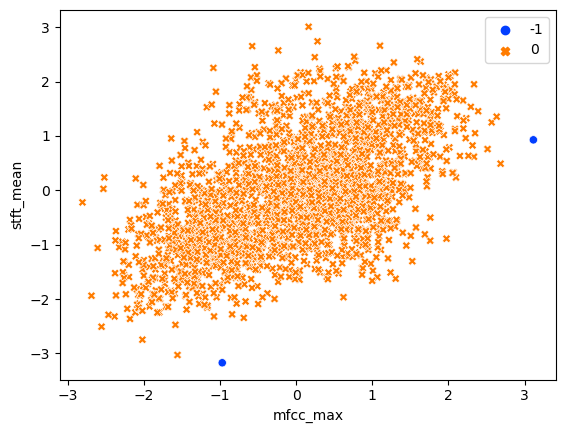

silhouette 0.5573952670043602


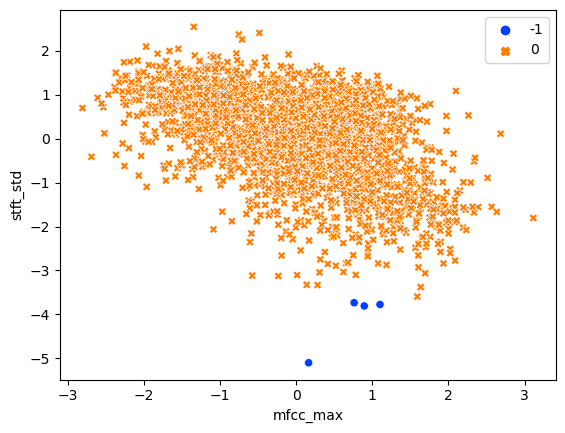

silhouette 0.7043620905324103


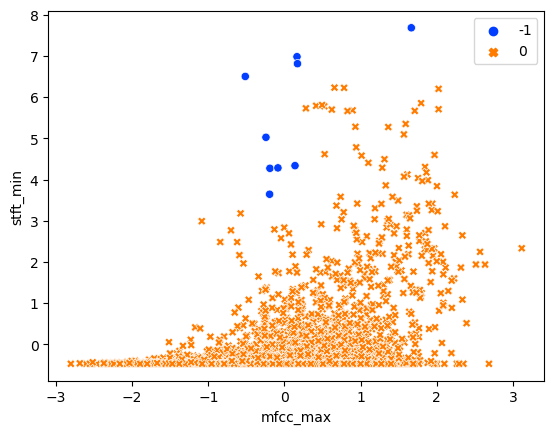

silhouette 0.6260963180926866


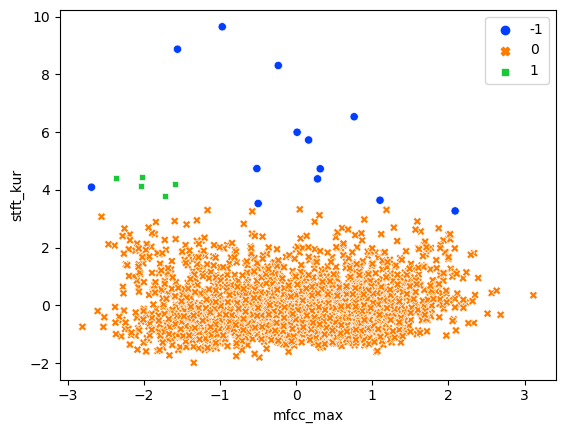

silhouette 0.5611328730582751


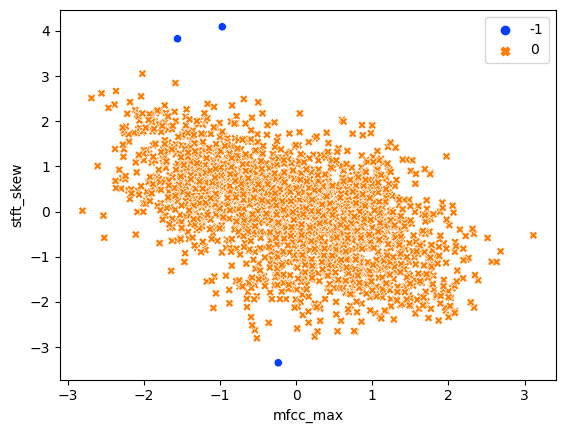

silhouette 0.6549171894907284


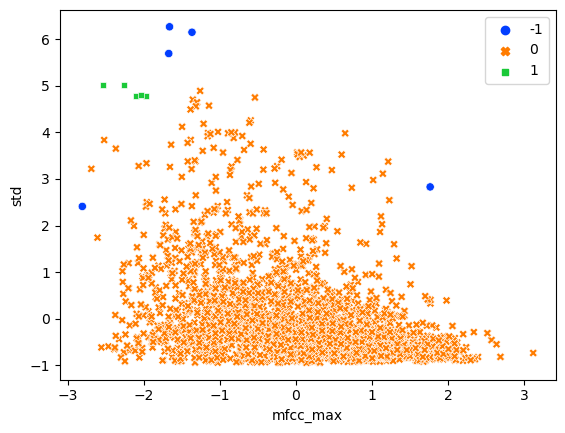

silhouette 0.4878840105645767


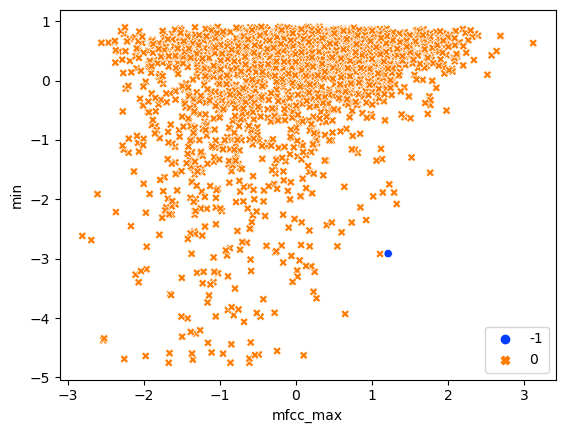

labels {-1: 0, 0: 2452}
silhouette 0.6913046579373796


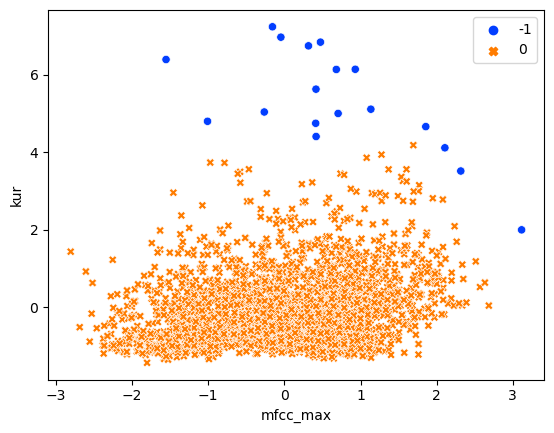

silhouette 0.5703456423939592


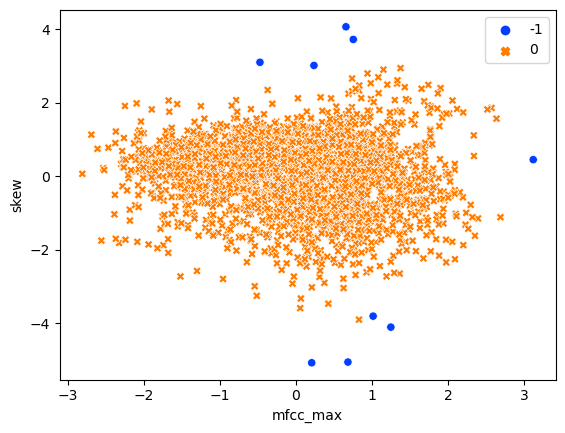

silhouette 0.3806551975989454


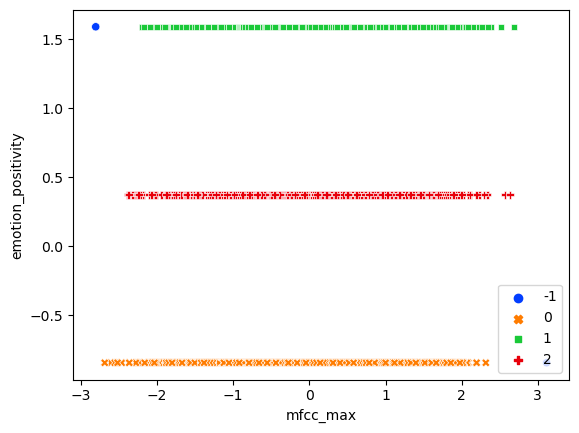

labels {-1: 0, 0: 2452}
silhouette 0.5707415558231859


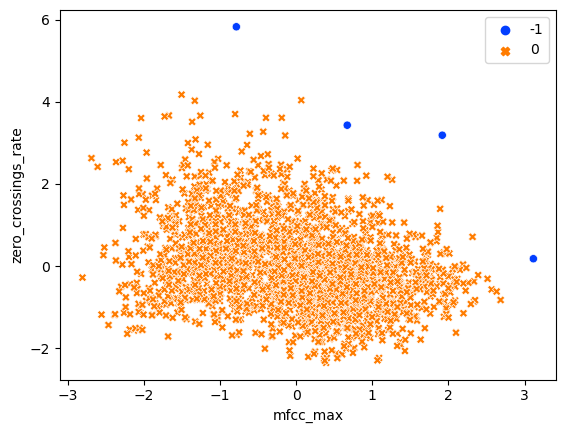

silhouette 0.3757713864850282


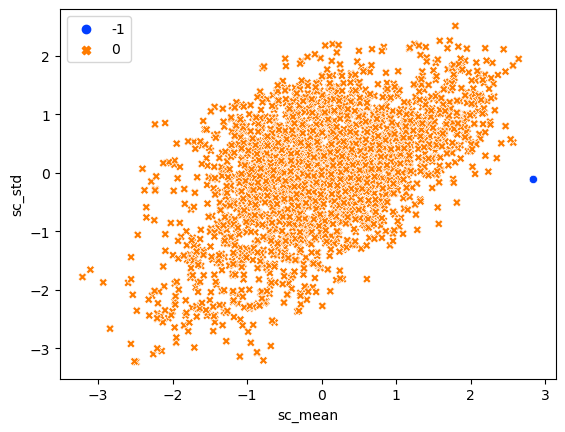

silhouette 0.444203533557795


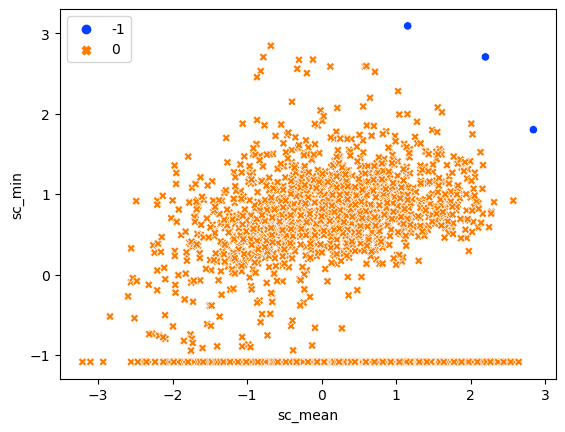

silhouette 0.6247346065014324


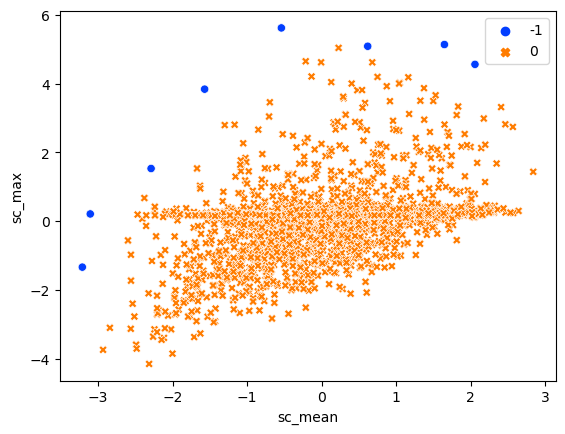

silhouette 0.7165858850384088


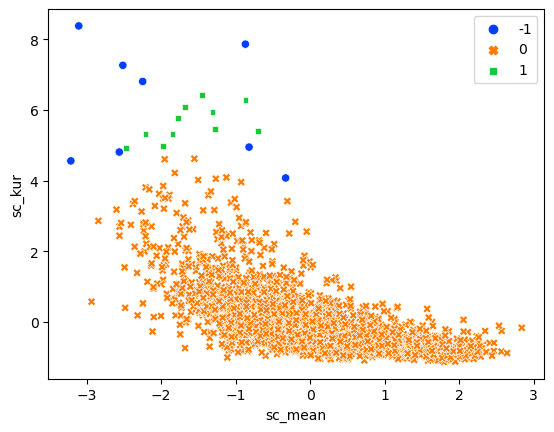

silhouette 0.6261710816099227


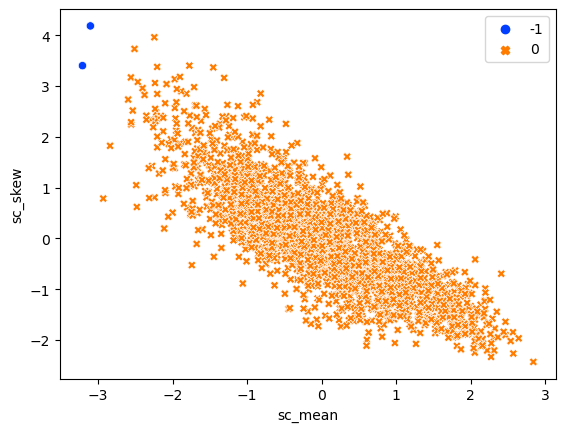

silhouette 0.5274833750067923


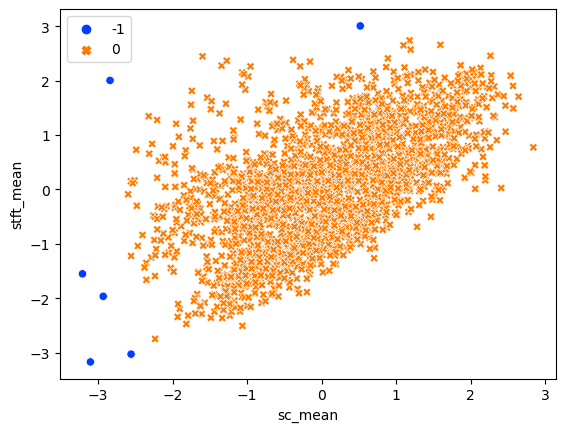

silhouette 0.5433564637563882


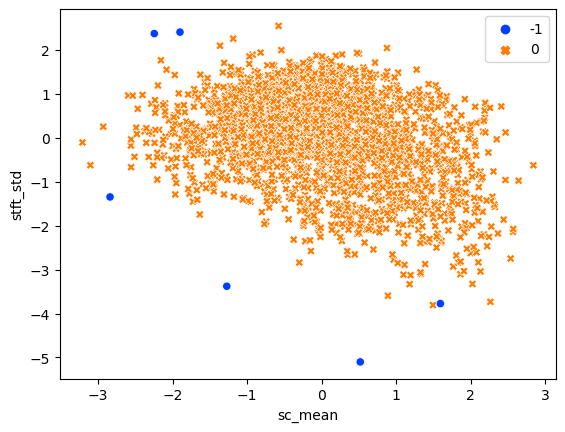

silhouette 0.6700480037798555


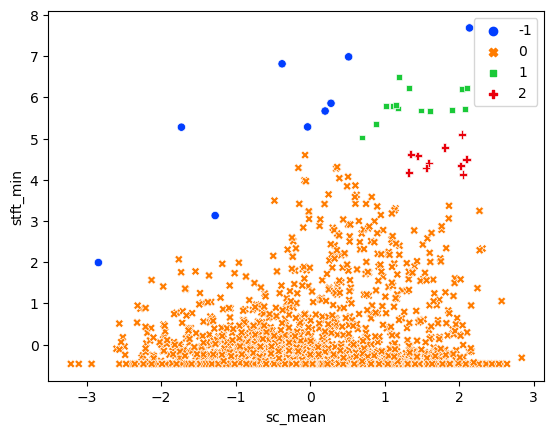

silhouette 0.6986197801257569


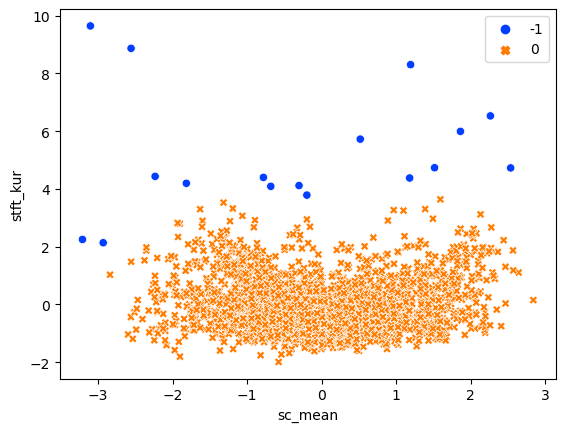

silhouette 0.5832994165028744


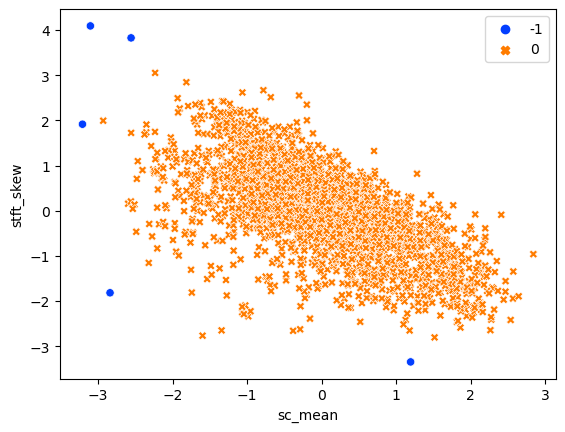

silhouette 0.6820640724087939


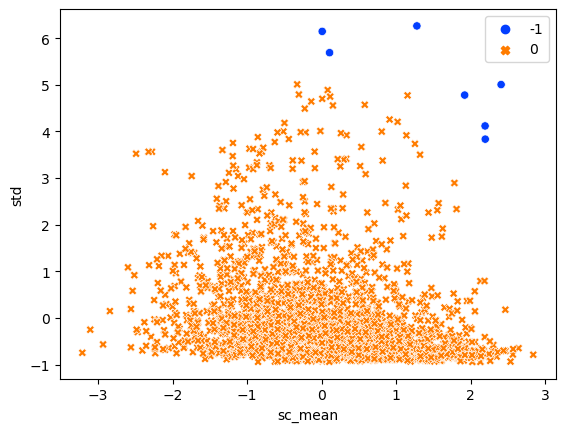

silhouette 0.6095155611720252


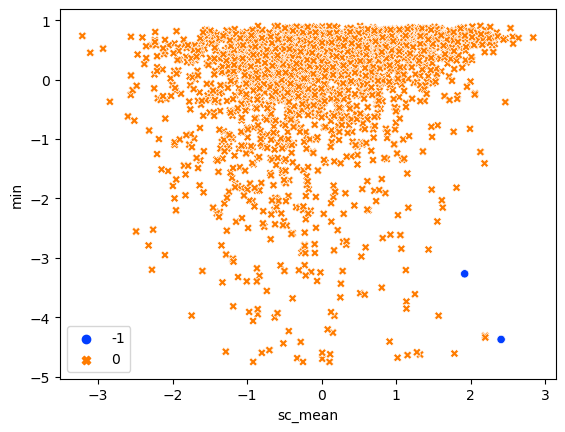

silhouette 0.6309491885683964


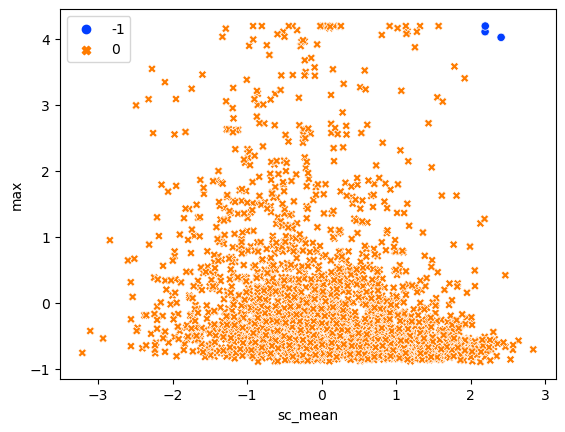

silhouette 0.6949471442488624


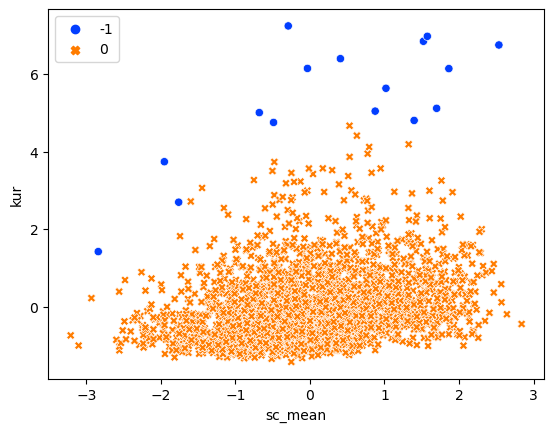

silhouette 0.5882828180300721


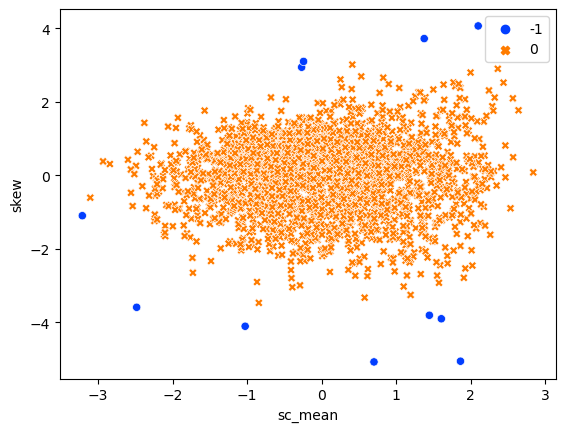

silhouette 0.35785763515552654


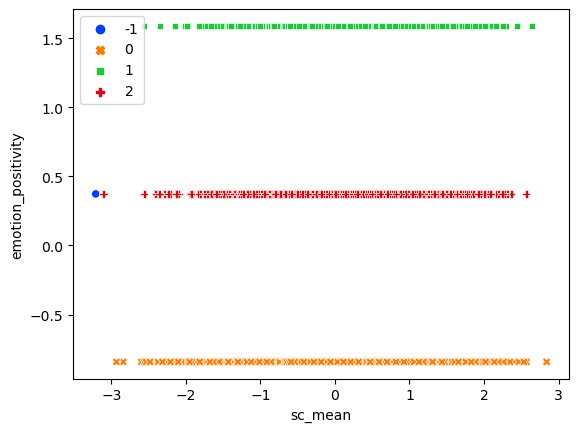

silhouette 0.5398303693763592


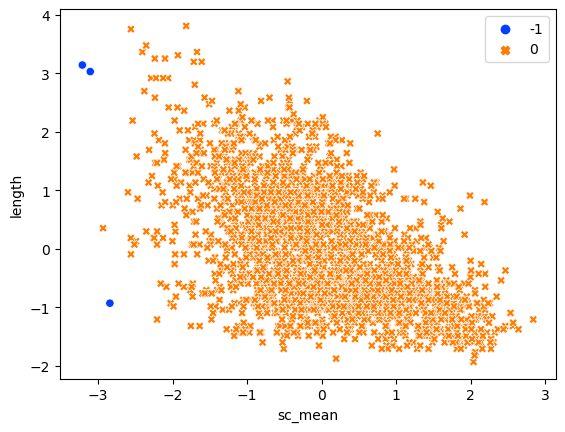

silhouette 0.6444145195057532


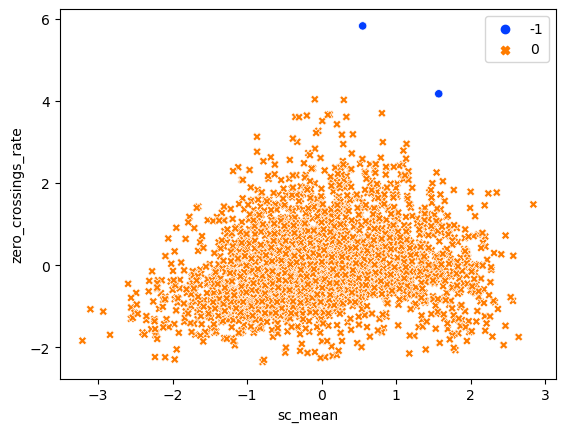

silhouette 0.4355829068130409


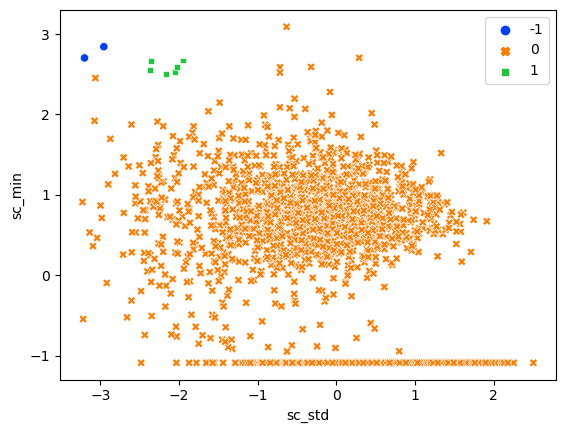

silhouette 0.6407276011530886


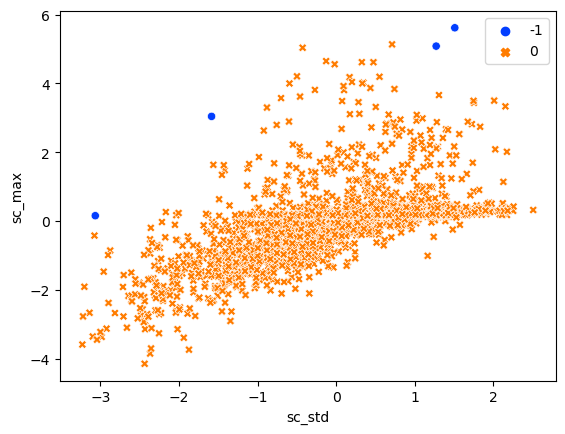

silhouette 0.7624053738523966


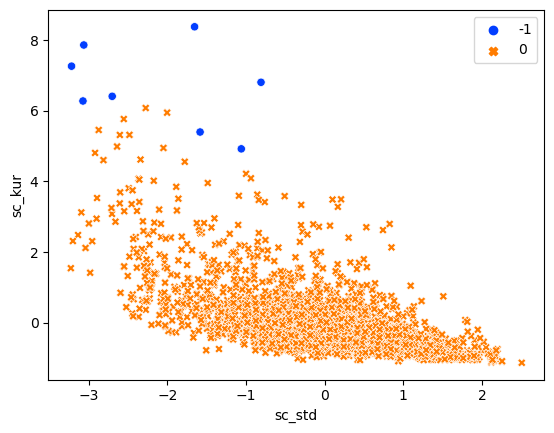

silhouette 0.5640593753666344


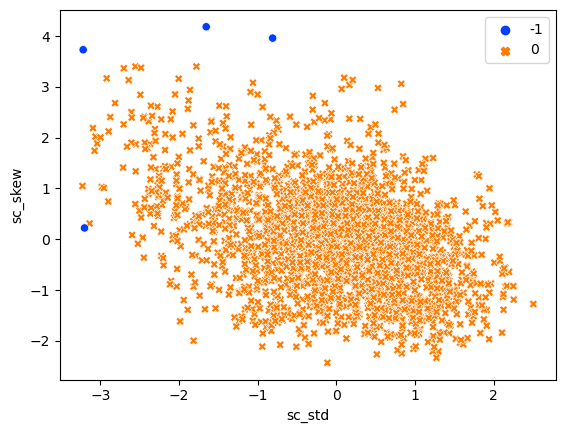

silhouette 0.4861792270877275


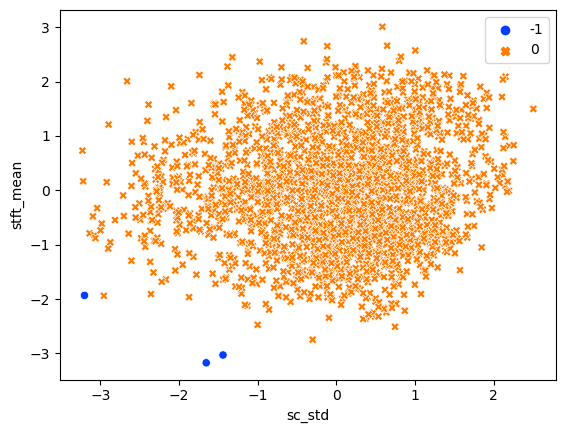

silhouette 0.5359587415791025


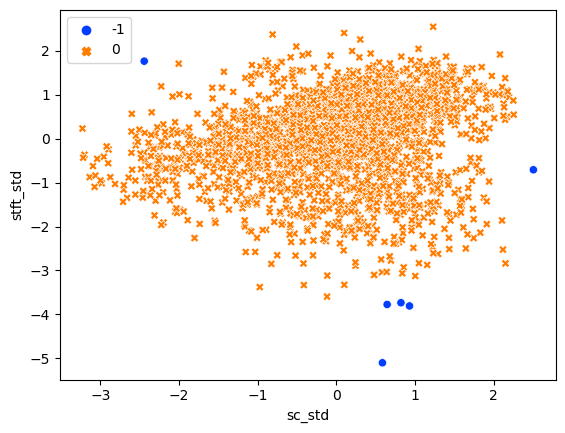

silhouette 0.7099023903009256


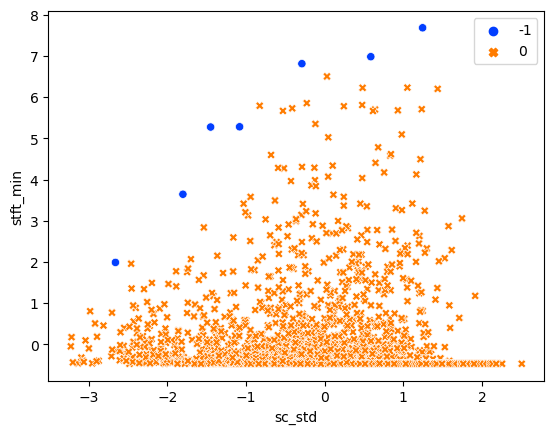

silhouette 0.7055282576508086


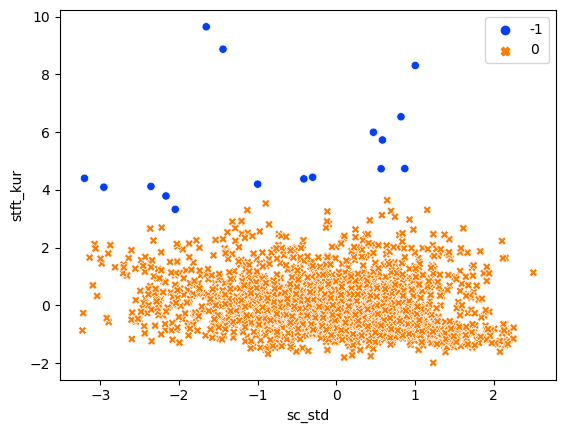

silhouette 0.5491989477030704


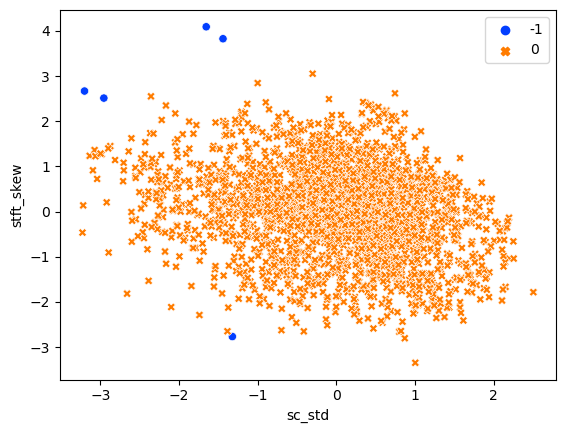

silhouette 0.6829393229189992


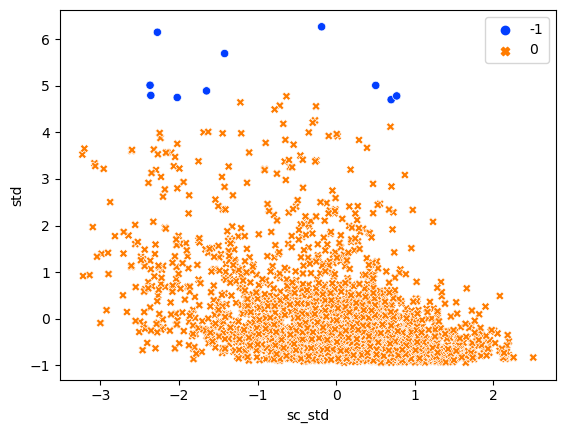

labels {-1: 0, 0: 2452}
labels {-1: 0, 0: 2452}
silhouette 0.6486981757268495


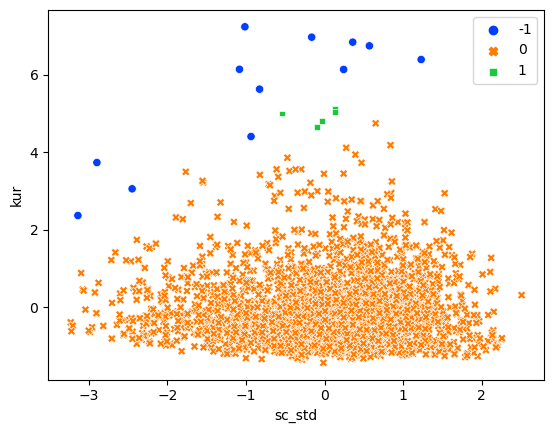

silhouette 0.5899679794781758


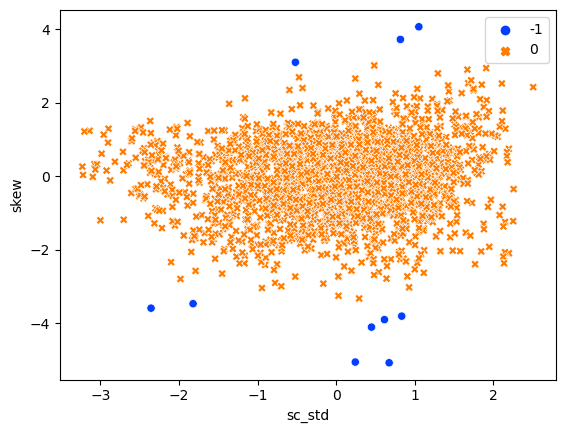

silhouette 0.38200659217378935


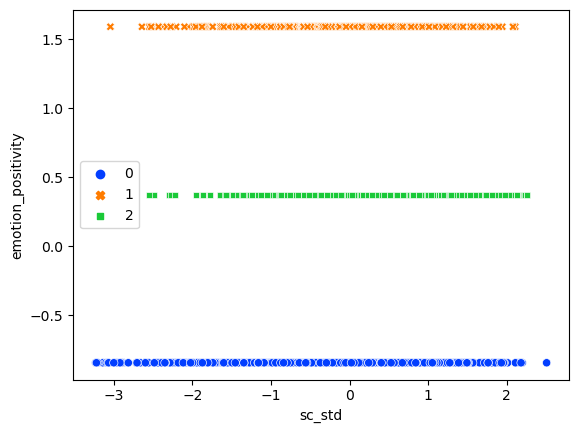

silhouette 0.4977831194287652


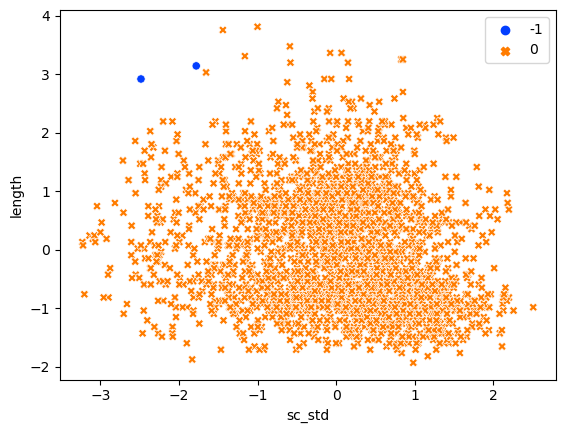

silhouette 0.5953243568289928


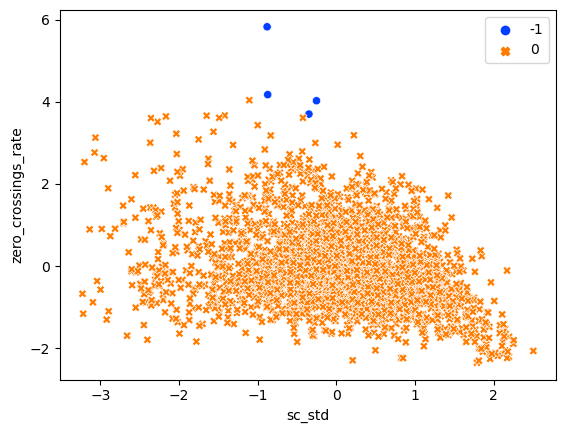

silhouette 0.6243131225953679


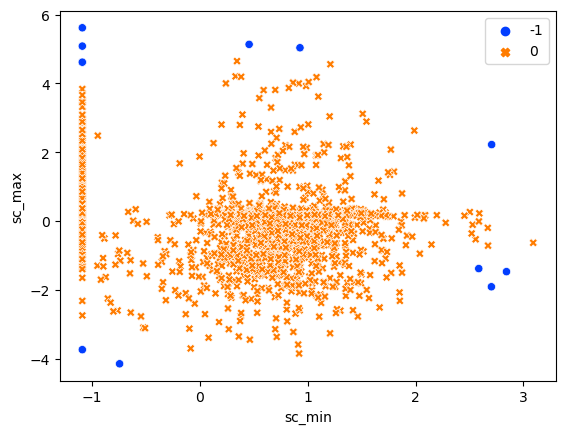

silhouette 0.6991131249011056


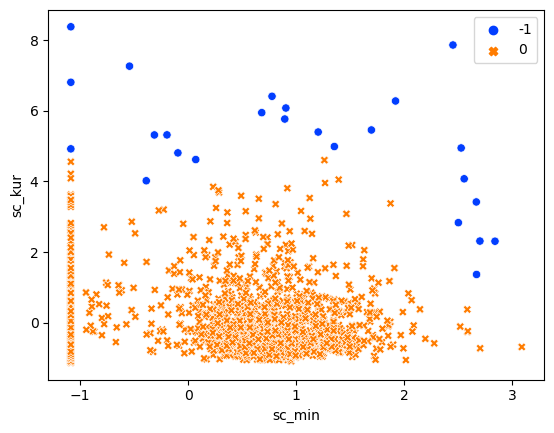

silhouette 0.5008522273240311


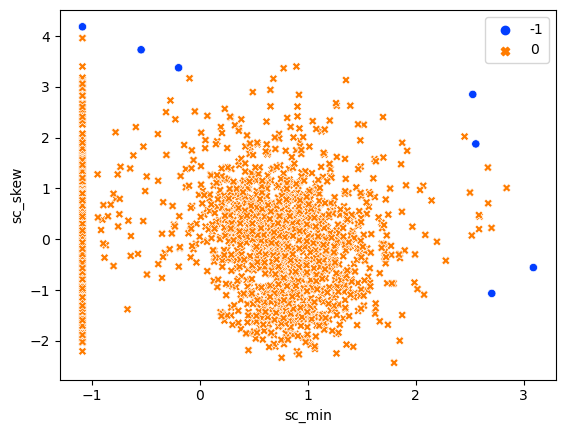

silhouette 0.4106159035210945


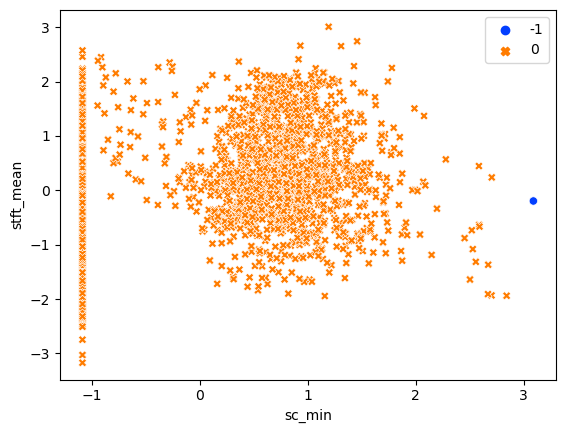

silhouette 0.6029298539017697


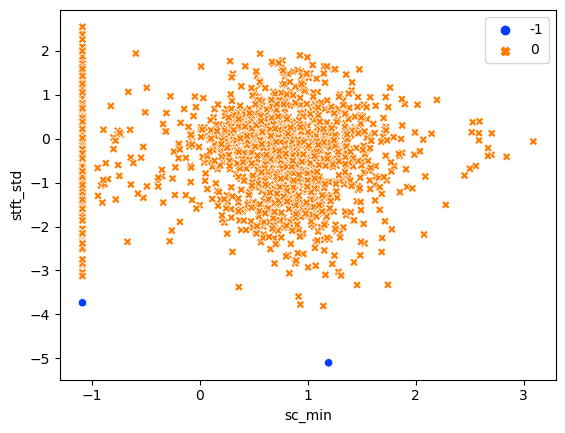

silhouette 0.7187414371271587


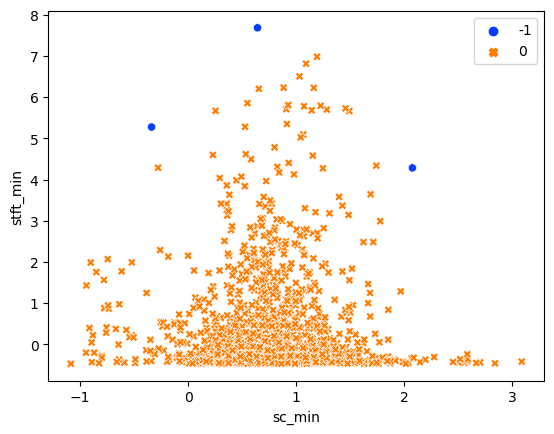

silhouette 0.695826399741579


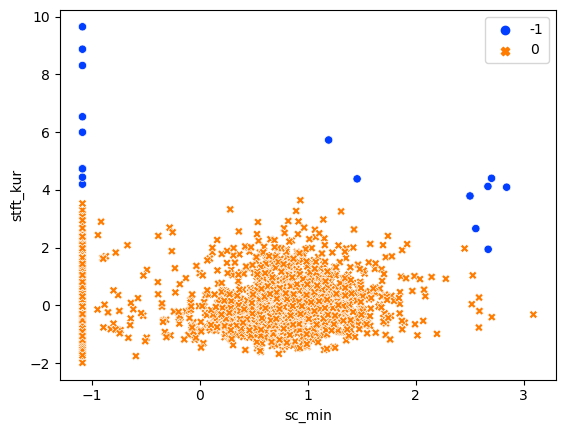

silhouette 0.5306617192642297


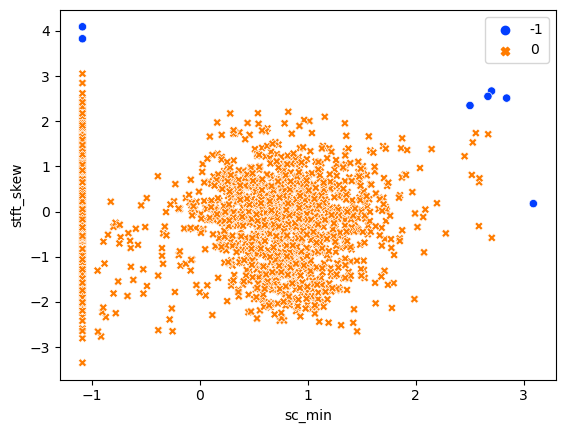

silhouette 0.6289588058284993


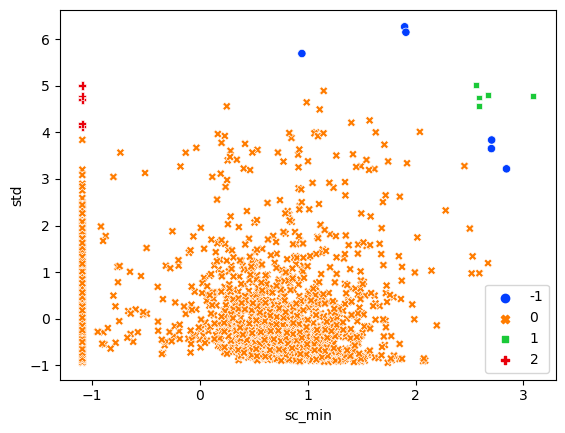

silhouette 0.6352978079795877


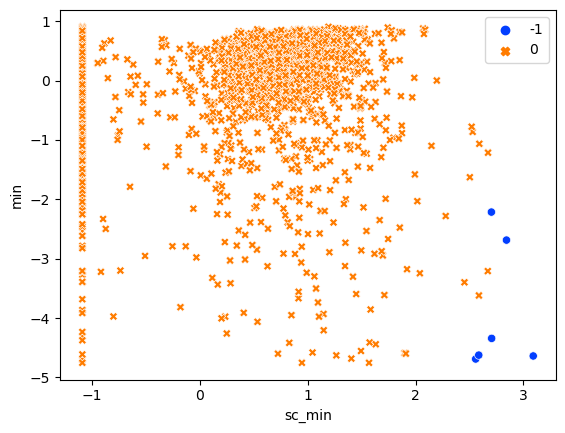

silhouette 0.5740867811910983


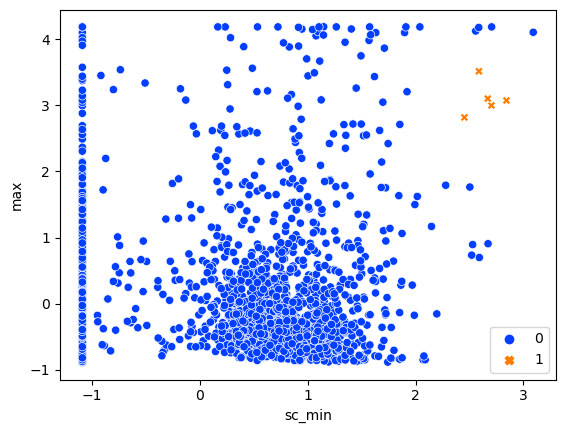

silhouette 0.7178953607732568


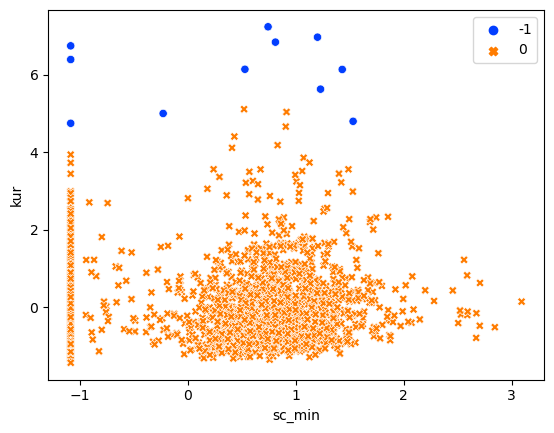

silhouette 0.5918057055776211


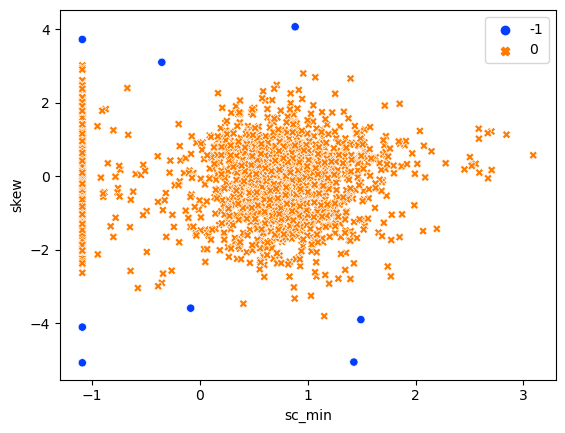

silhouette 0.31082549714824576


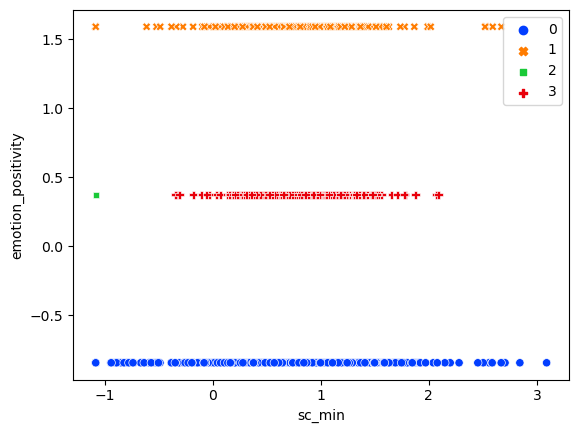

labels {-1: 0, 0: 2452}
silhouette 0.5972031793786572


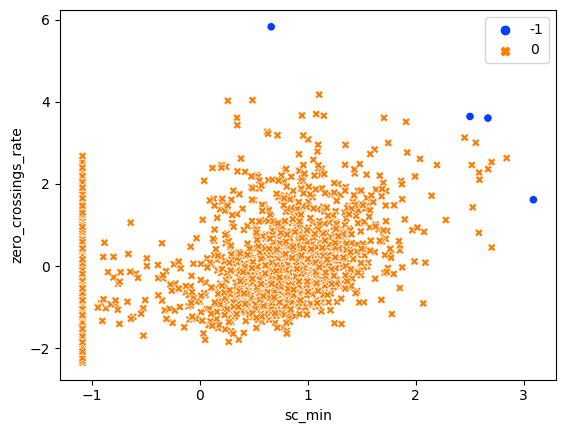

silhouette 0.7347587208218088


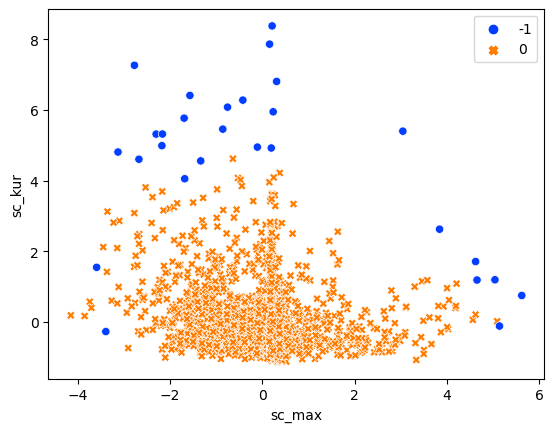

silhouette 0.5274803681226972


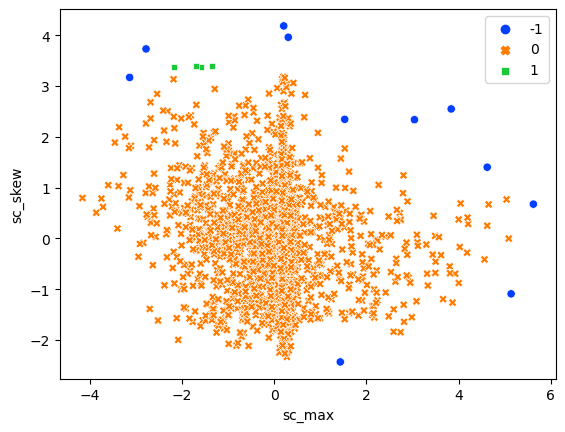

silhouette 0.6345770152180946


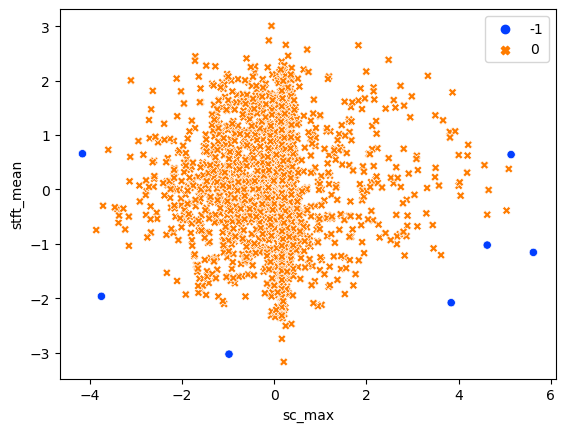

silhouette 0.6313041823494732


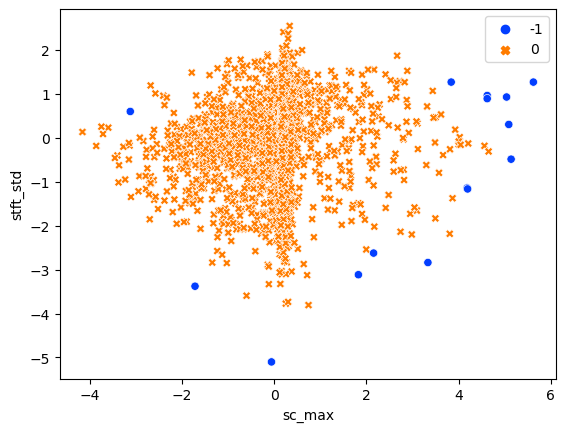

silhouette 0.6732777481708915


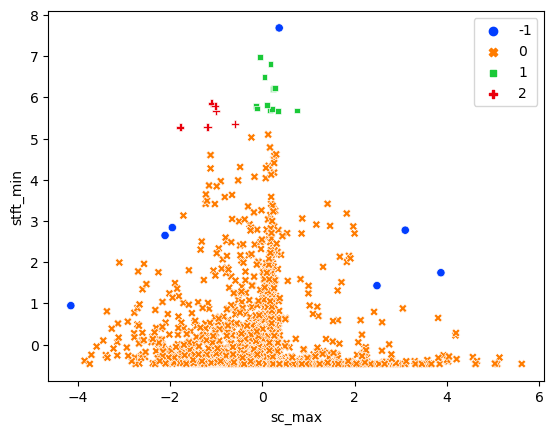

silhouette 0.6969057433705509


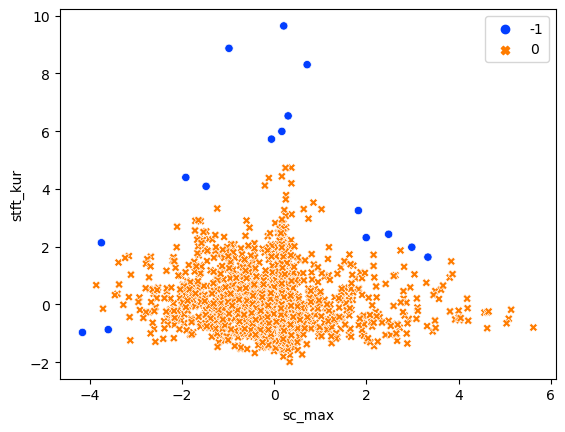

silhouette 0.6124130600738126


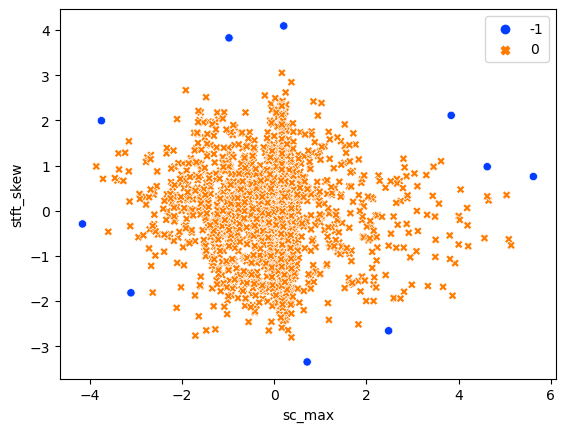

silhouette 0.6762717246980297


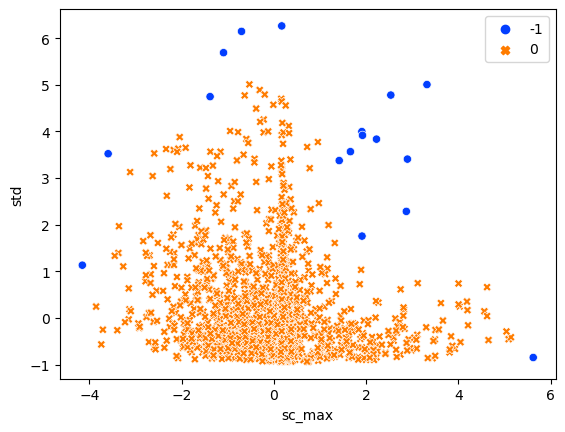

silhouette 0.6384253329794042


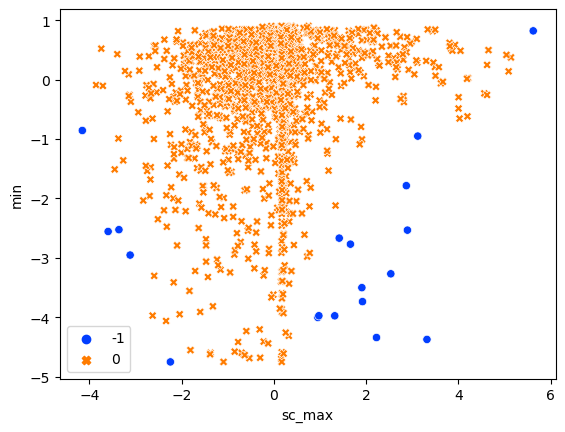

silhouette 0.6491623107278215


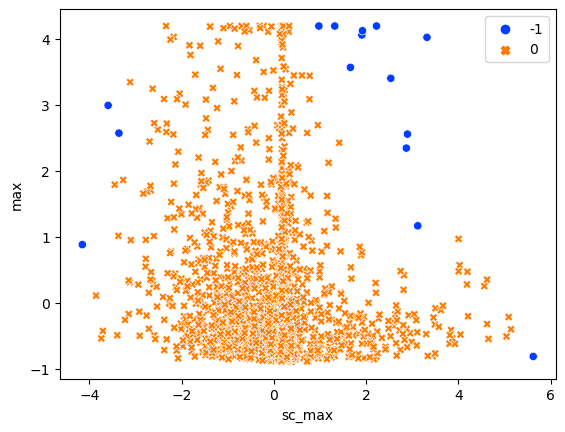

silhouette 0.6902579085550222


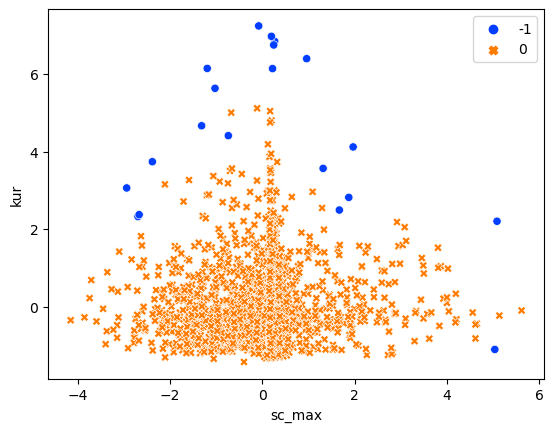

silhouette 0.6208677370895147


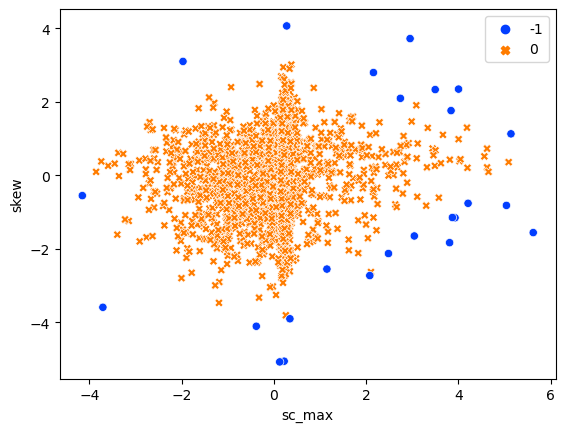

silhouette 0.4661894372268997


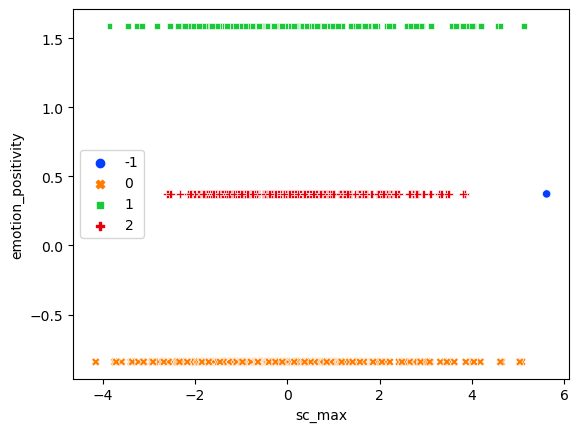

silhouette 0.5734756491765096


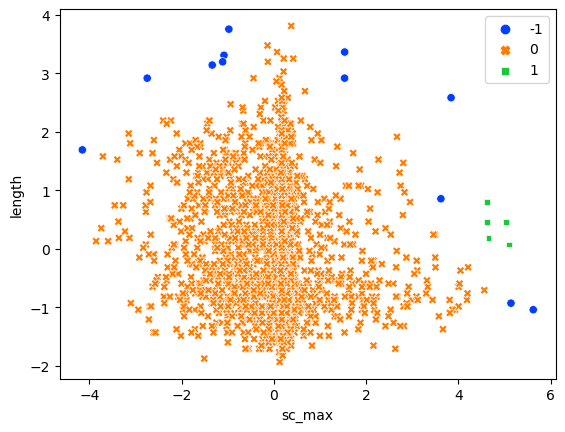

silhouette 0.6414040409561285


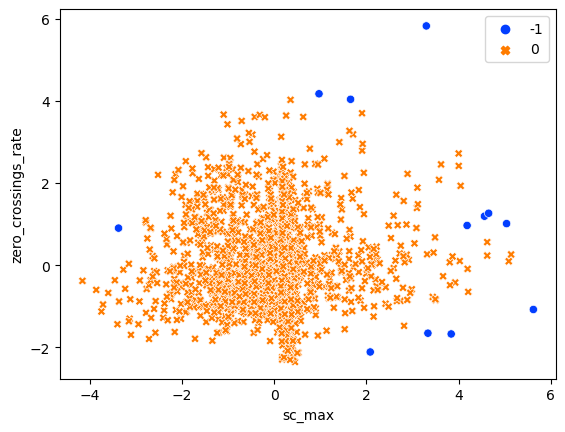

silhouette 0.7599081854229831


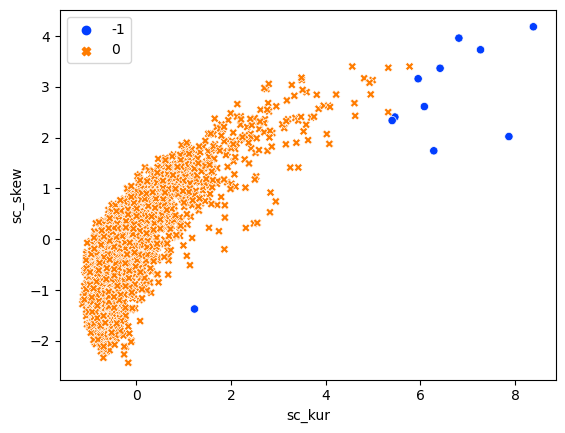

silhouette 0.6772431452857879


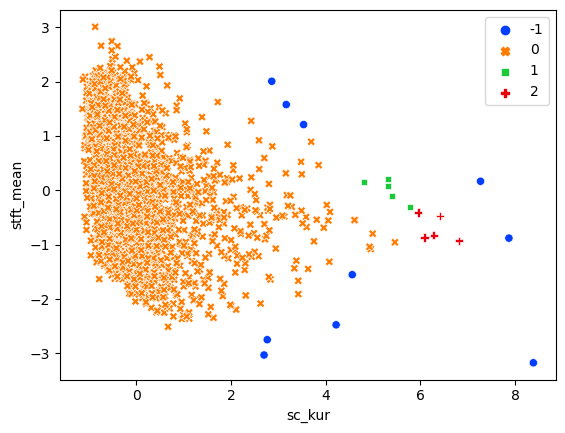

silhouette 0.7000710521243456


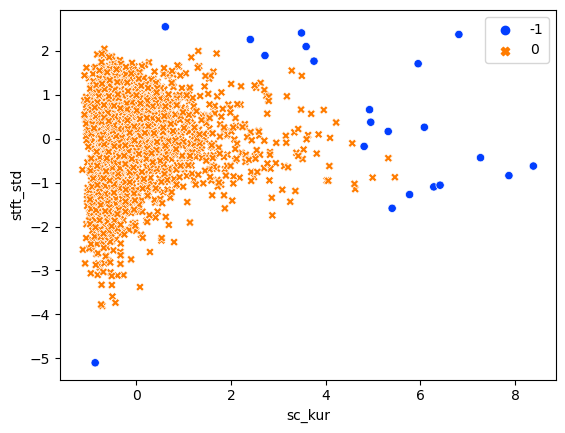

silhouette 0.7433214777833254


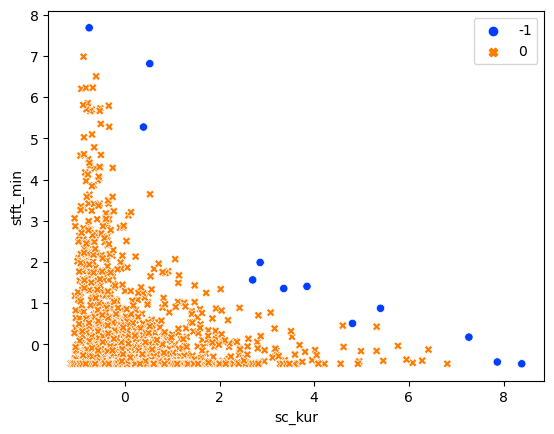

silhouette 0.683859873098348


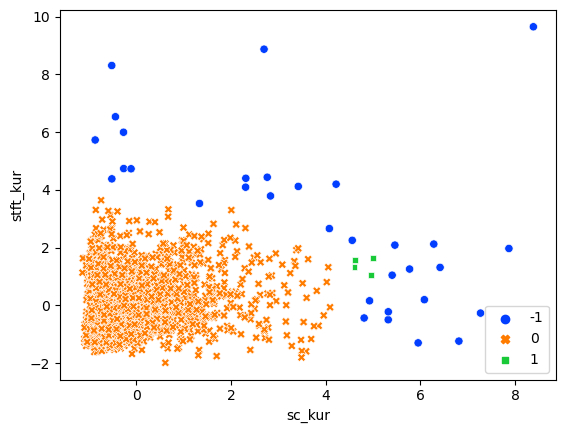

silhouette 0.6901894624211553


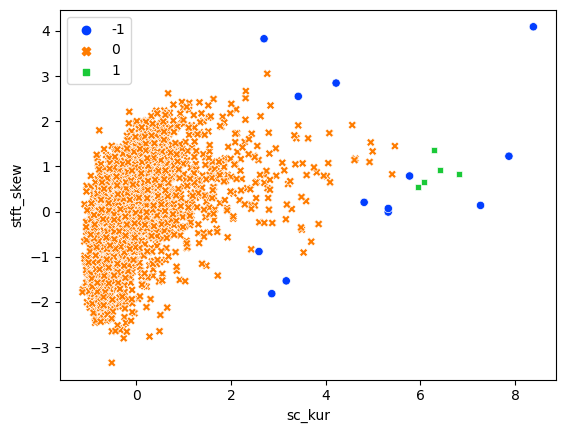

silhouette 0.7040243670331965


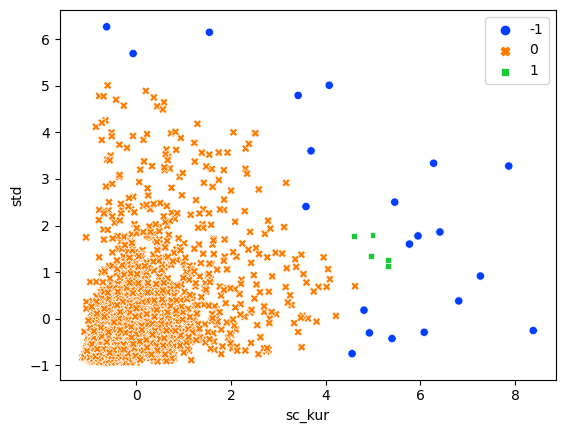

silhouette 0.7309535945347407


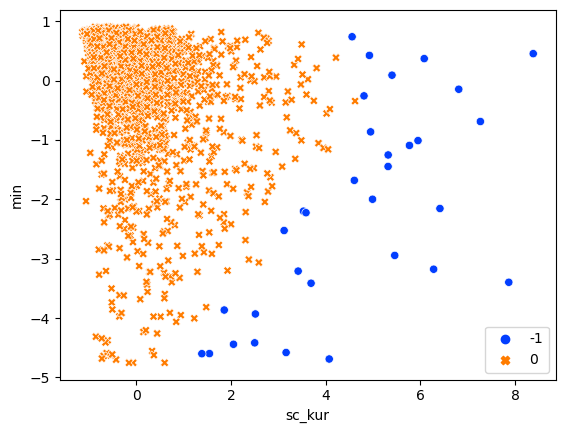

silhouette 0.7032105692390552


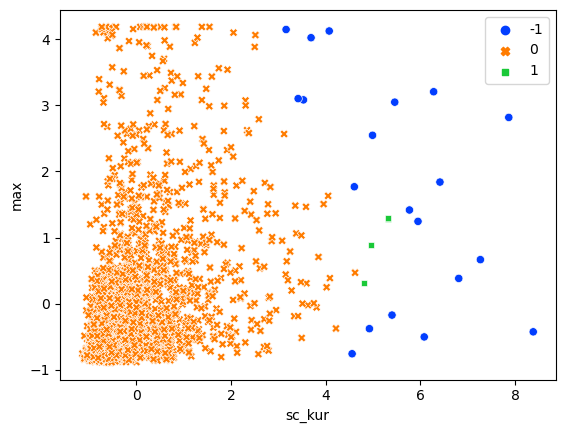

silhouette 0.7132324656141369


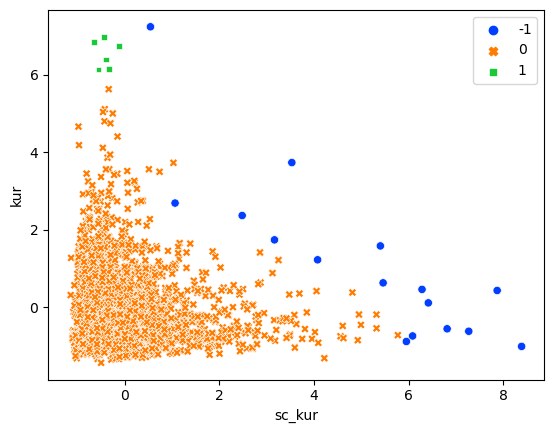

silhouette 0.7019767433301712


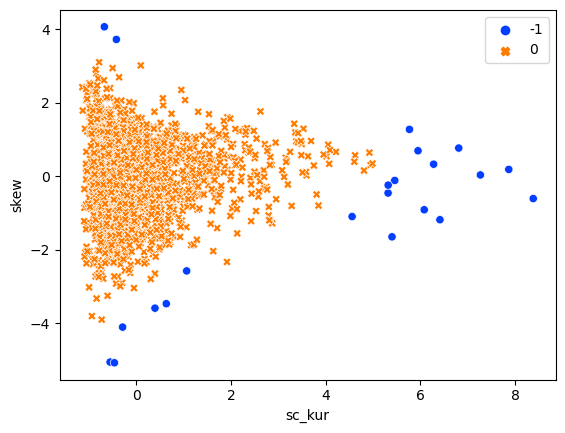

silhouette 0.46638274937906343


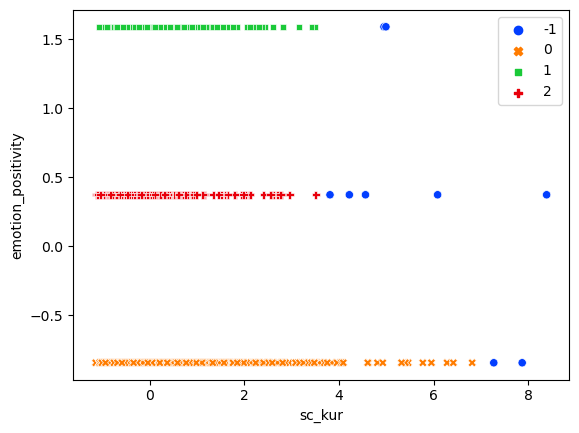

silhouette 0.6801727177656953


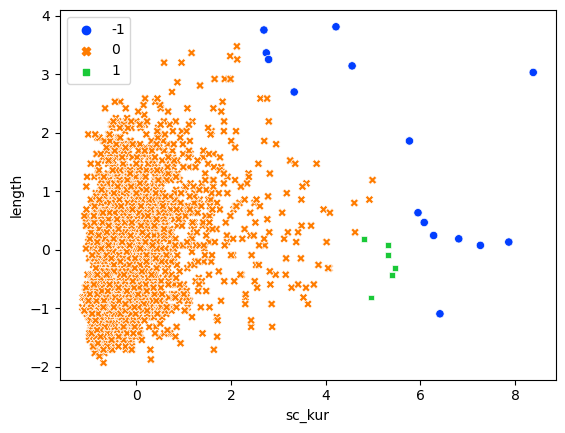

silhouette 0.7024521717047408


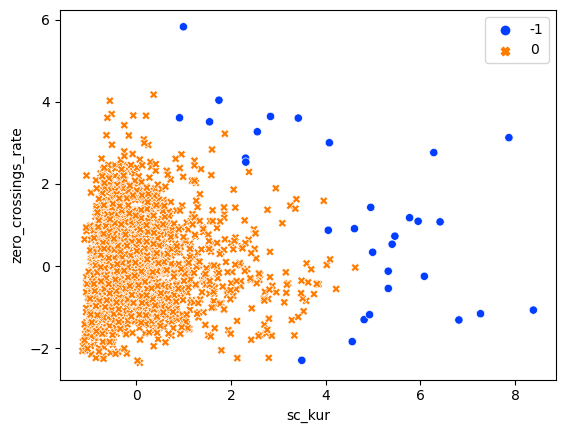

silhouette 0.5348518946882274


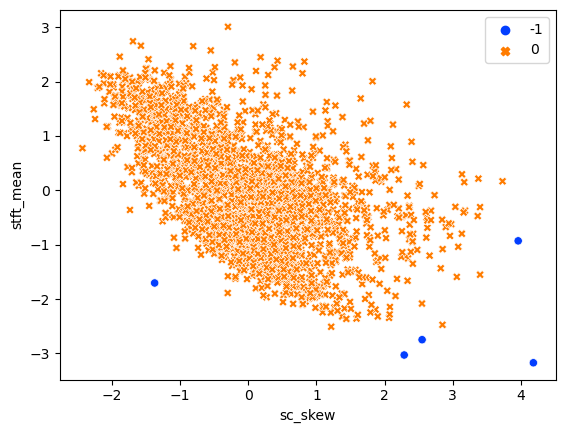

silhouette 0.6011744970443981


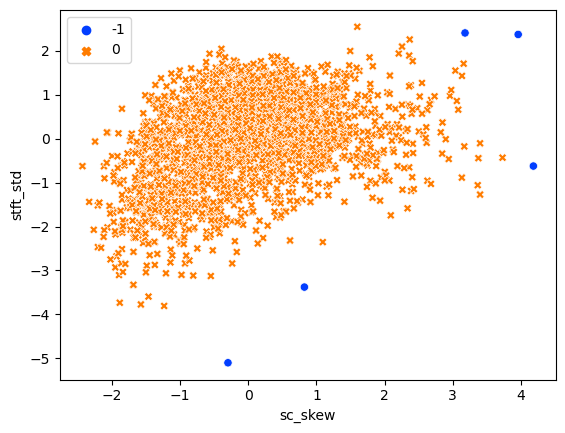

silhouette 0.7189573030315387


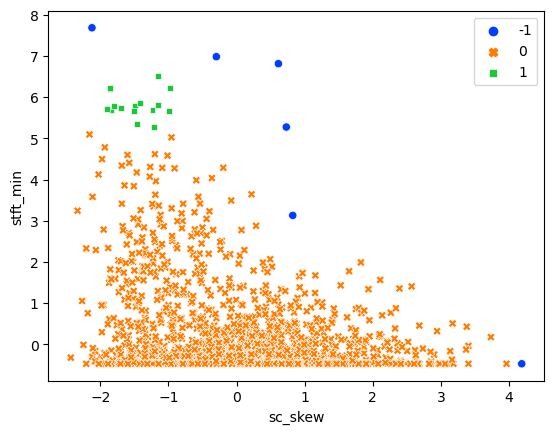

silhouette 0.7221195613106509


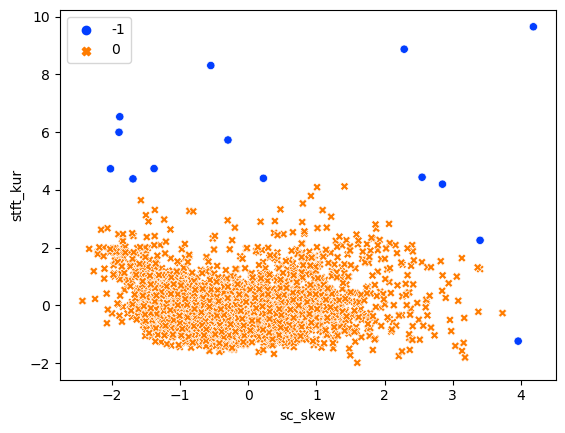

silhouette 0.5608172720091268


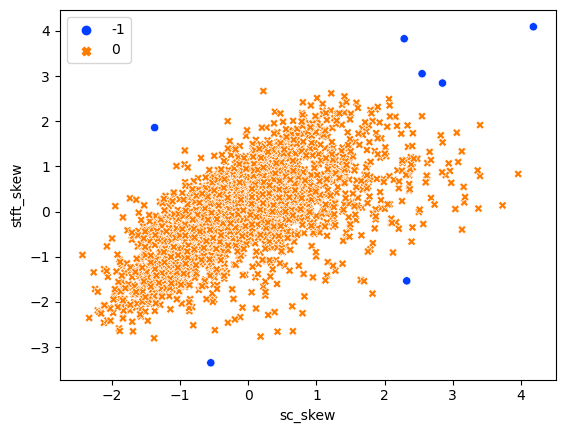

silhouette 0.6422291082918099


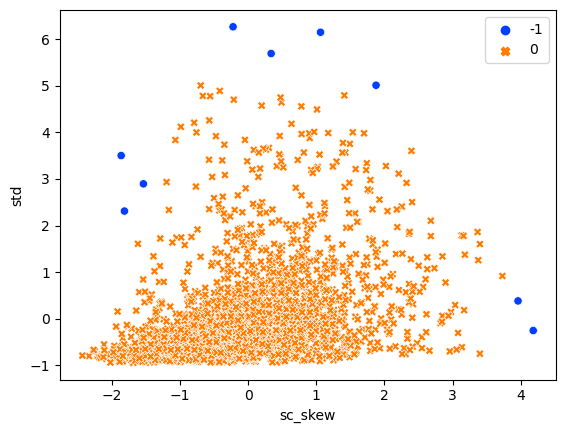

silhouette 0.6213810619430088


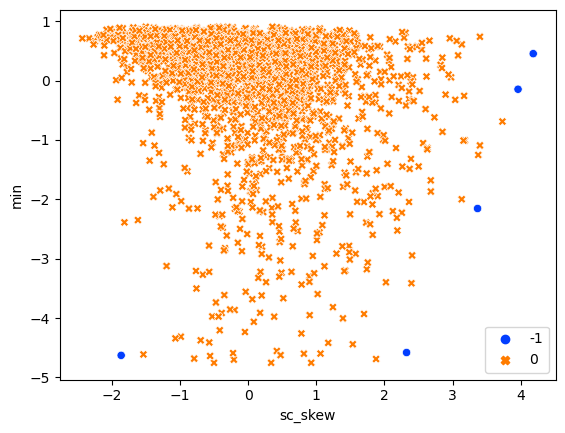

silhouette 0.5899492338667727


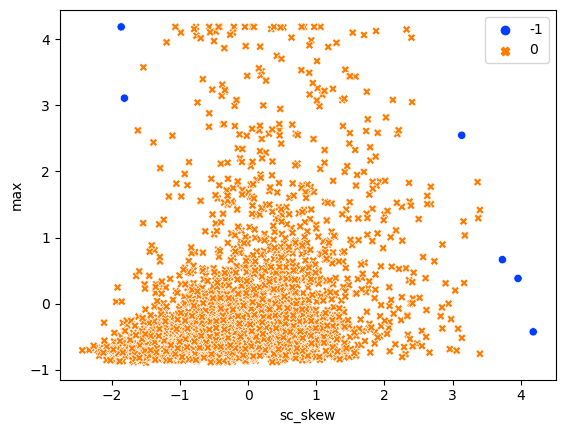

silhouette 0.6985786094532684


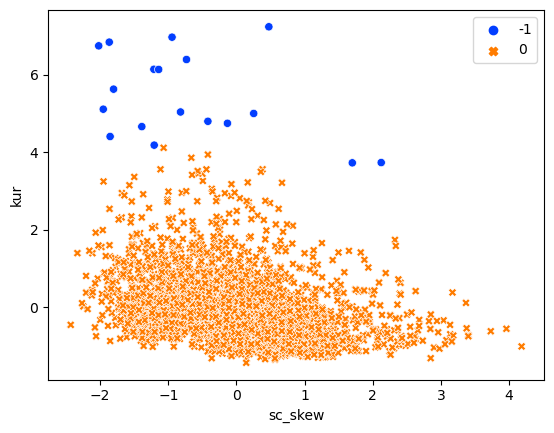

silhouette 0.5788977439607412


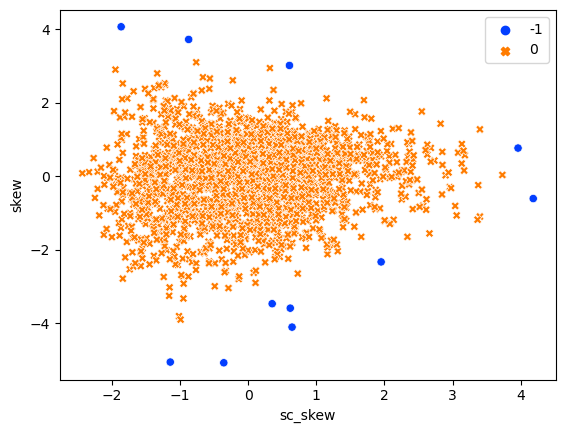

silhouette 0.3700201514227137


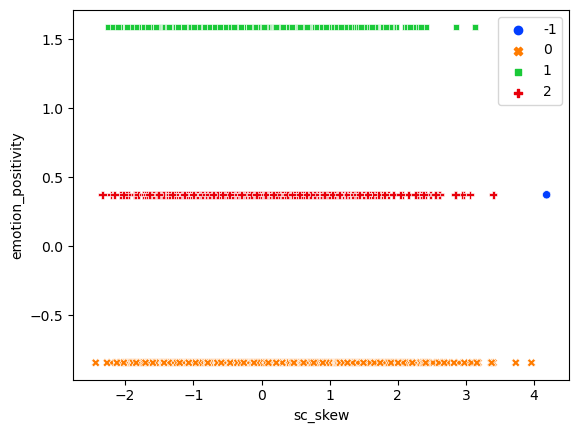

silhouette 0.6388952650425822


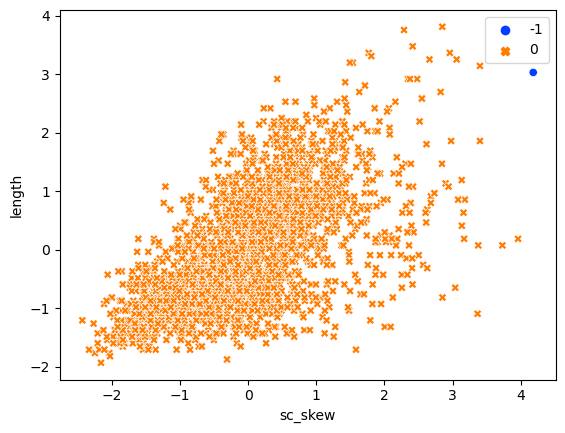

silhouette 0.6341974299458817


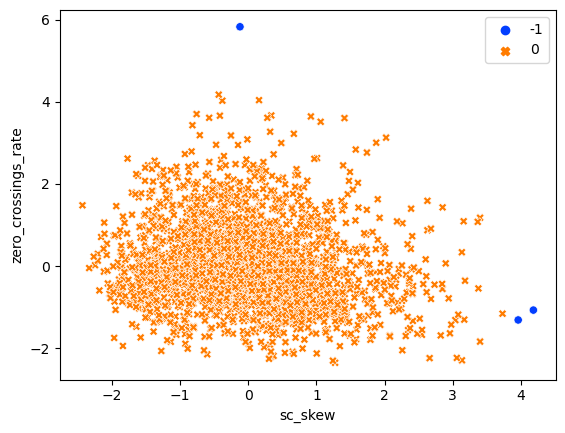

silhouette 0.5964976401944405


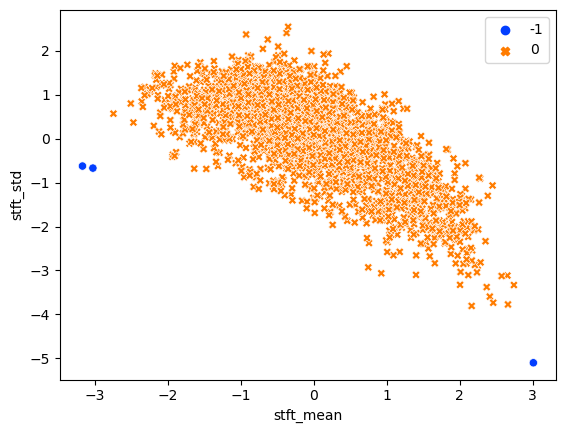

silhouette 0.7747797011833241


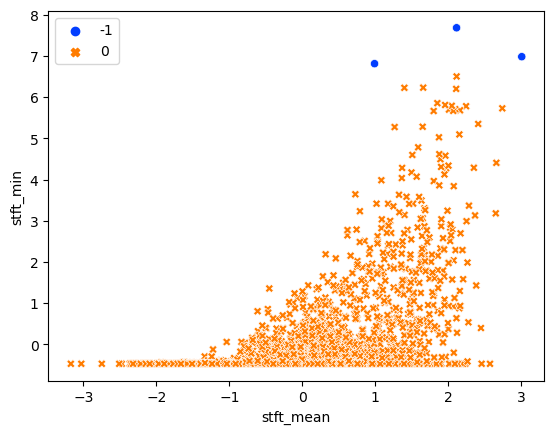

silhouette 0.7441593673705916


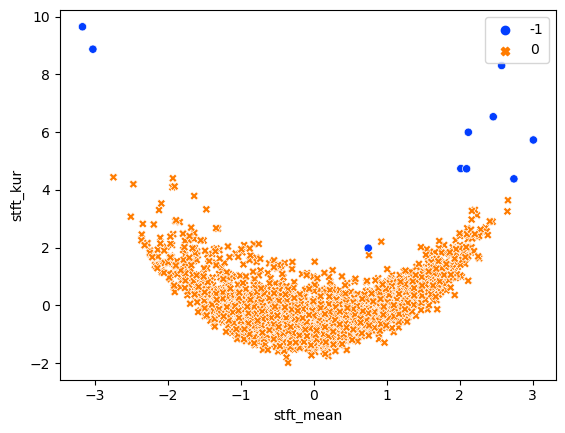

silhouette 0.6446622452107929


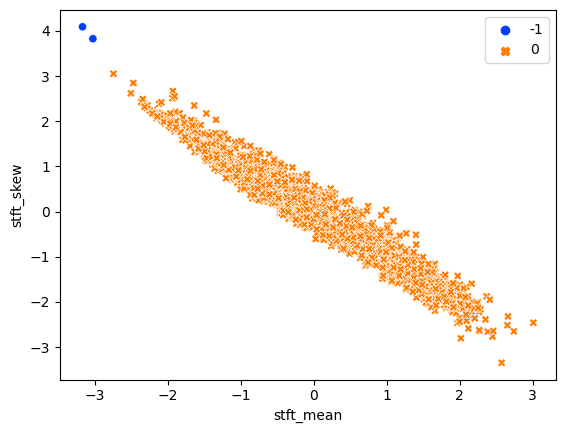

silhouette 0.6066779426901462


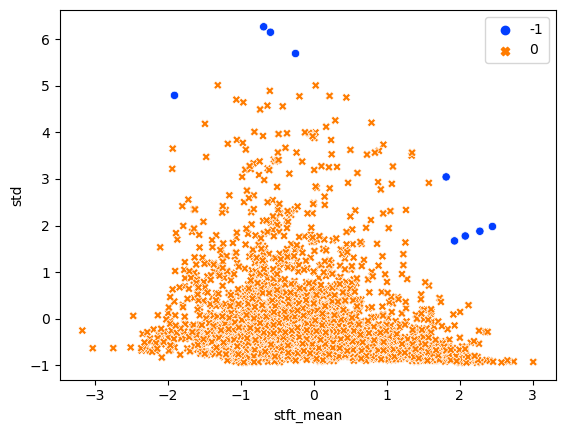

silhouette 0.5634145425646835


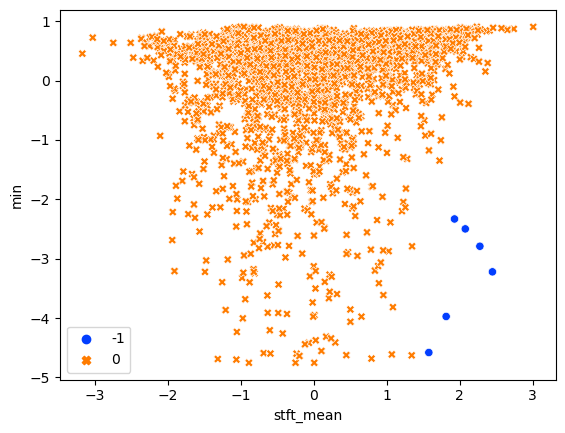

silhouette 0.48666516745280286


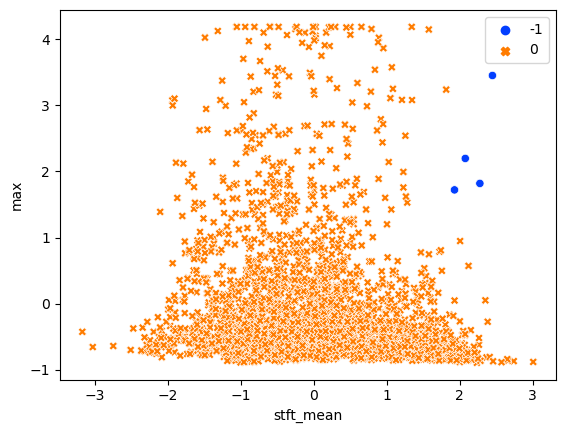

silhouette 0.707004515237835


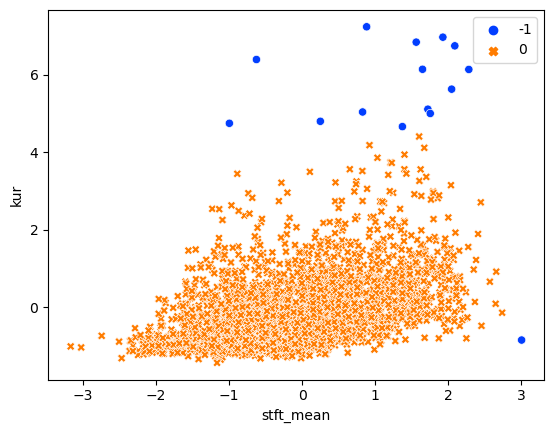

silhouette 0.6013622472904276


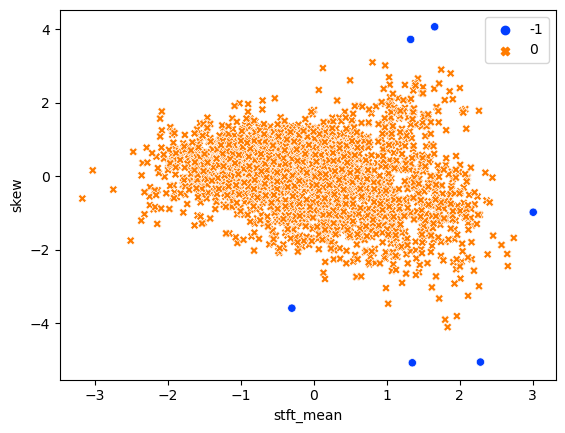

silhouette 0.3915695546391218


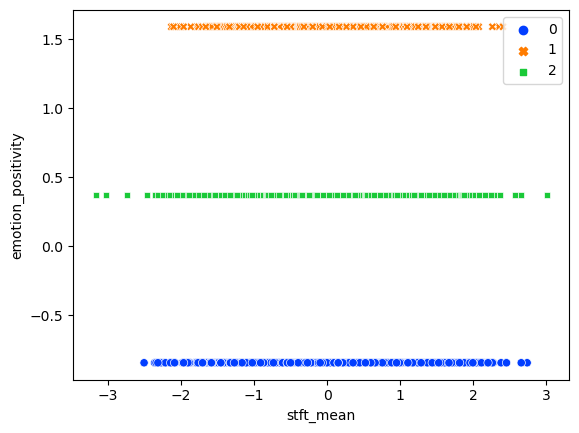

silhouette 0.586866998675712


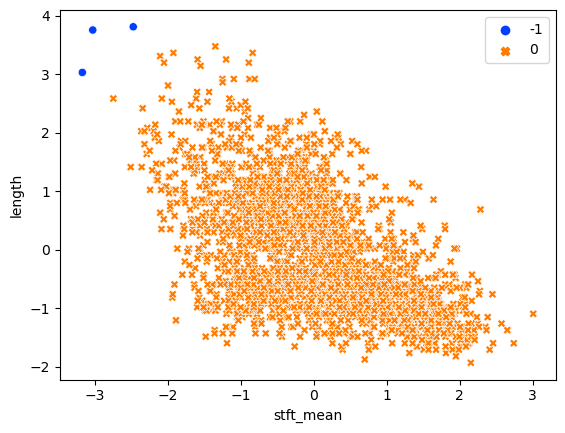

silhouette 0.566011593086766


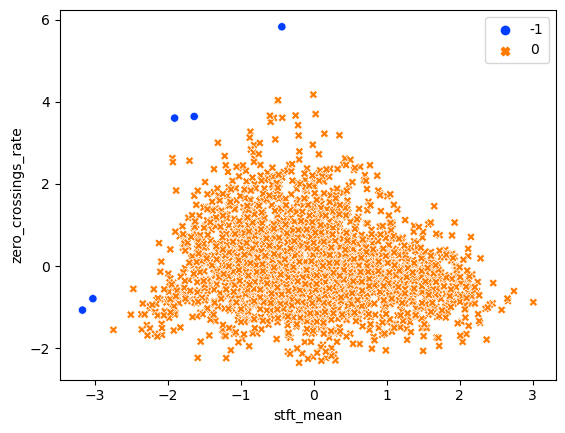

silhouette 0.7519444440738876


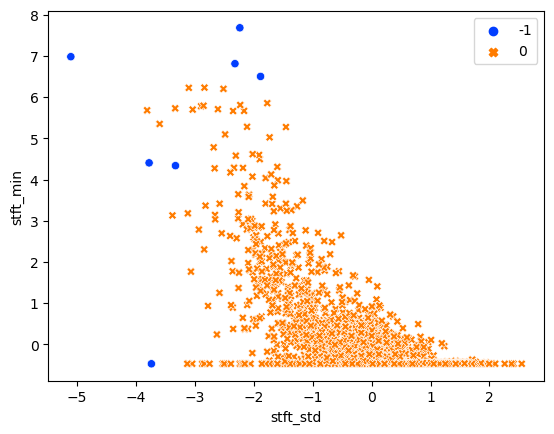

silhouette 0.7216074608162814


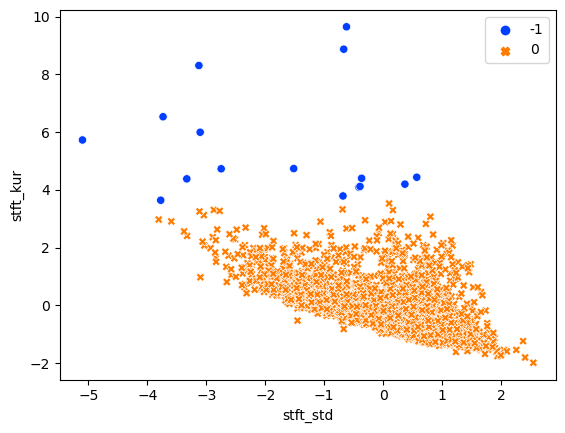

silhouette 0.6271495696090866


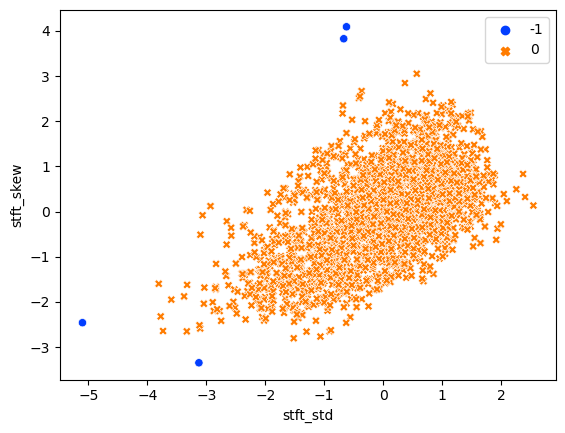

silhouette 0.7060358561907447


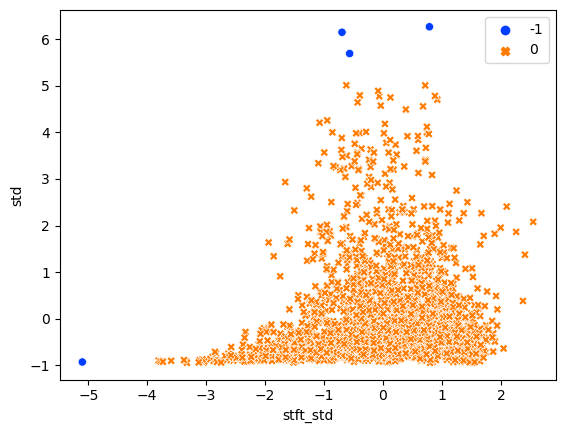

silhouette 0.5498543336930799


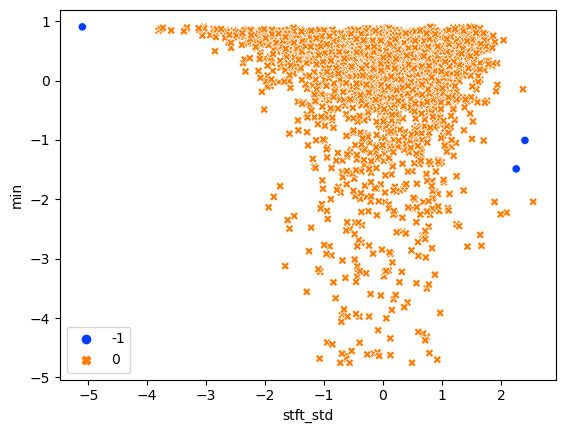

silhouette 0.6162824093796284


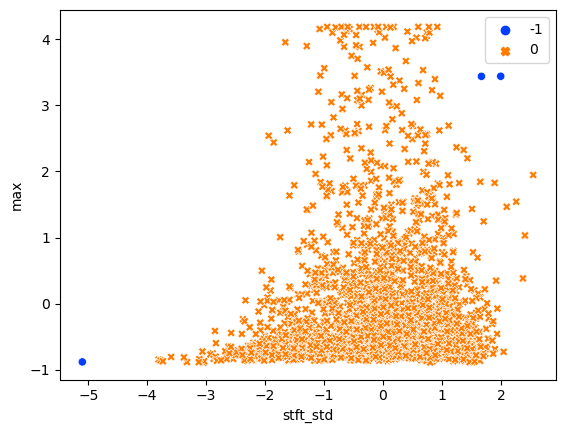

silhouette 0.6899377207293603


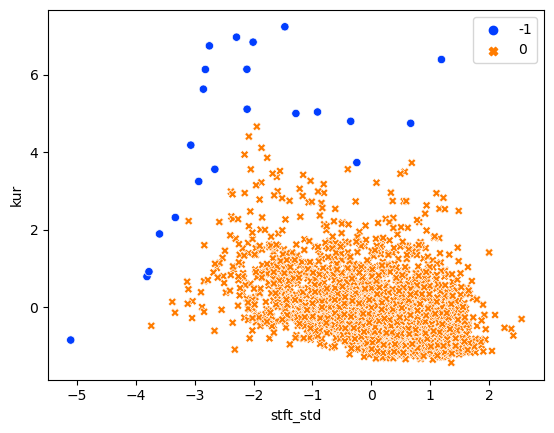

silhouette 0.6001304121251152


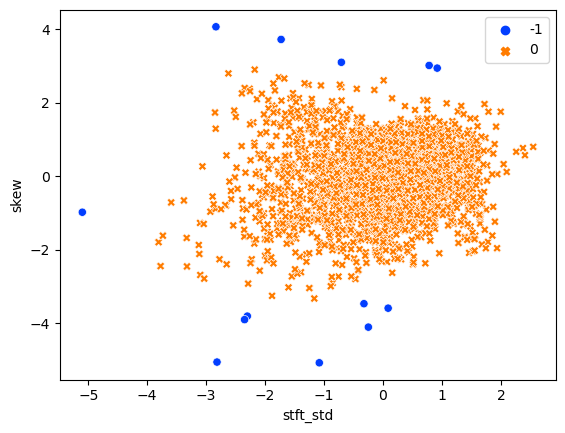

silhouette 0.3987434111373885


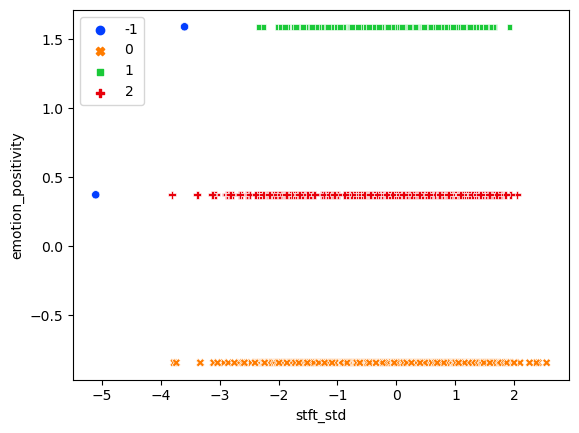

silhouette 0.5711348216756816


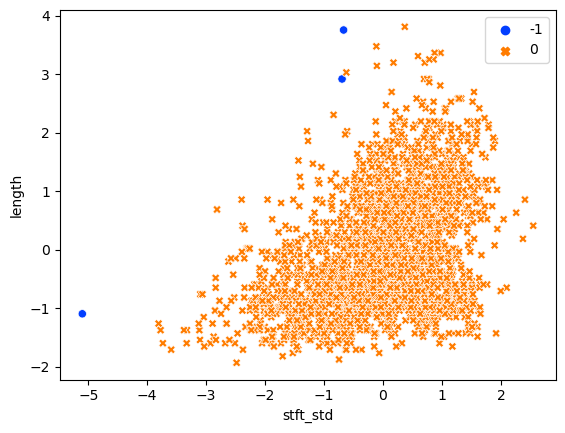

silhouette 0.6142160643902986


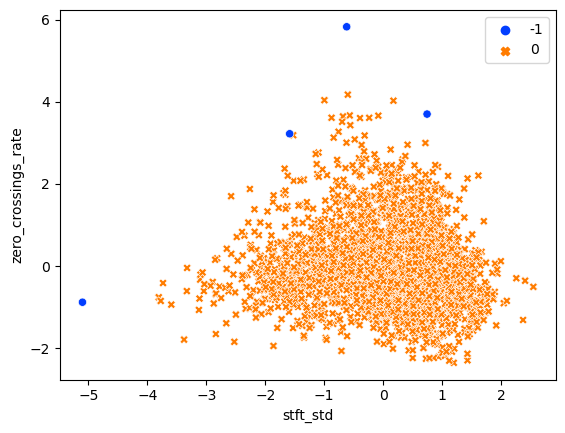

silhouette 0.7414417958019086


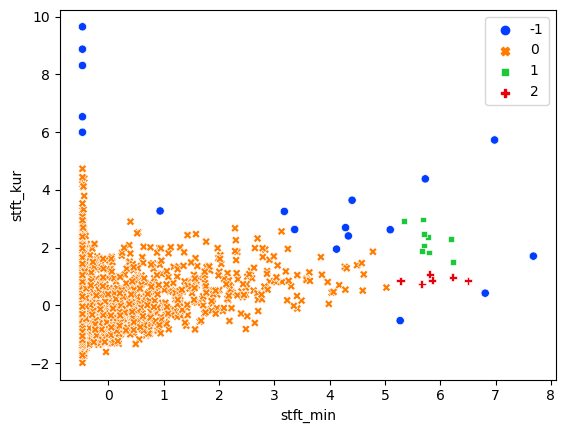

silhouette 0.7350000936243319


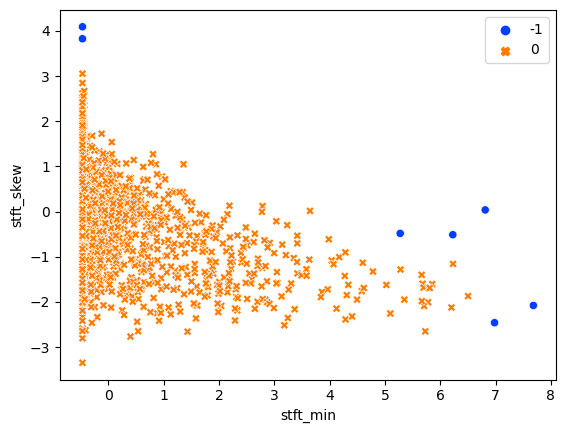

silhouette 0.7647880396975362


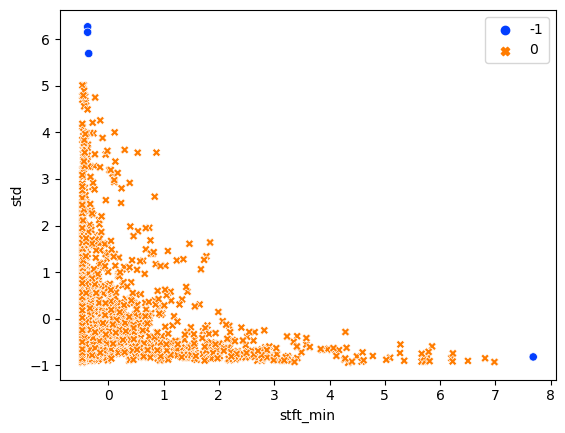

silhouette 0.6409852083985951


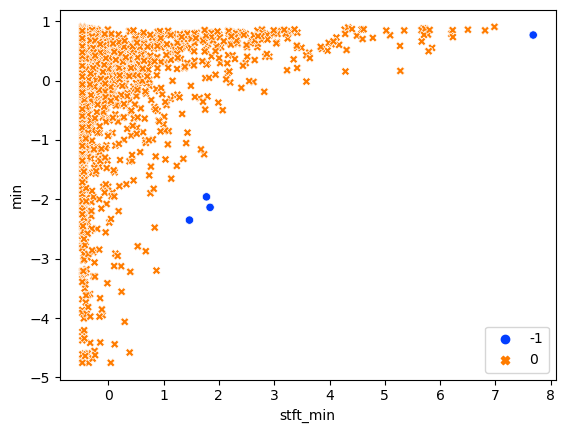

silhouette 0.6550600102337856


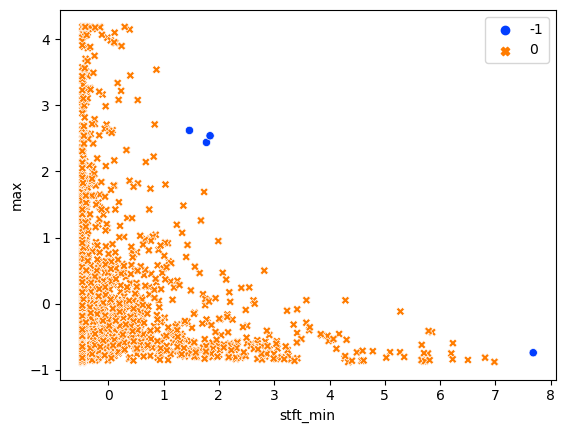

silhouette 0.6880396489455478


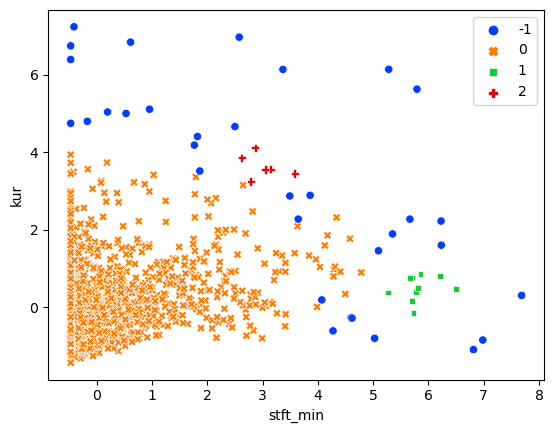

silhouette 0.7206924208866246


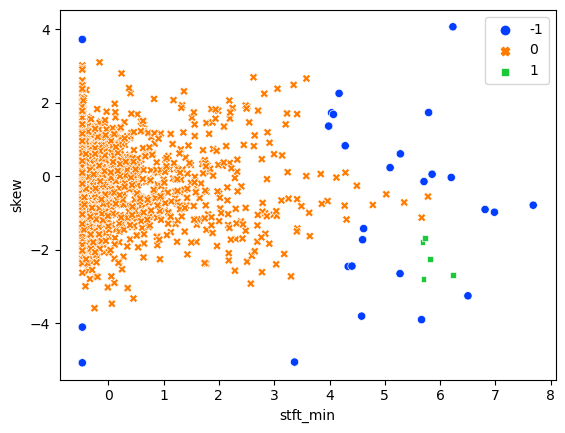

silhouette 0.5988767579252368


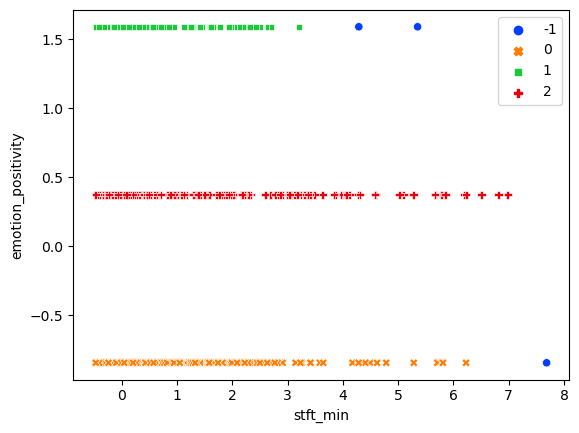

silhouette 0.6870988748036219


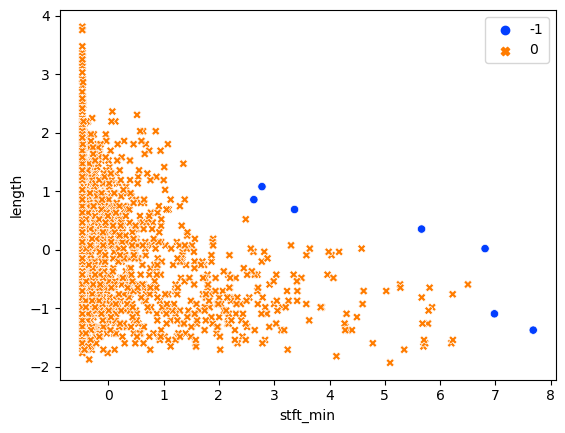

silhouette 0.6895694572474731


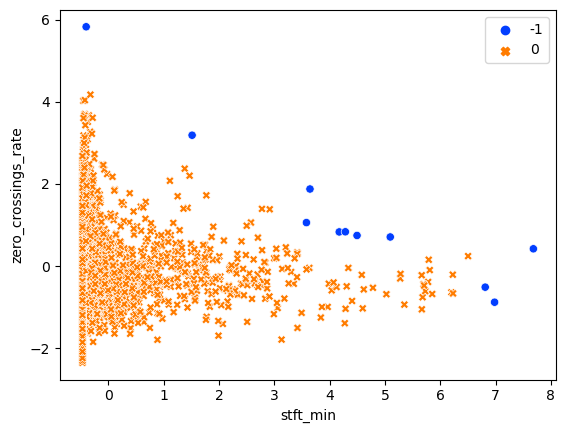

silhouette 0.7371365218586662


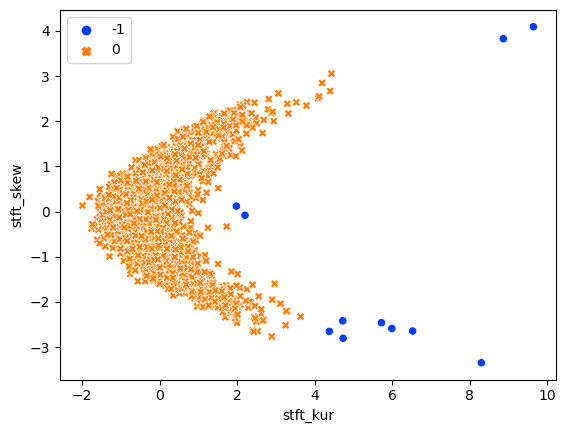

silhouette 0.725505771154107


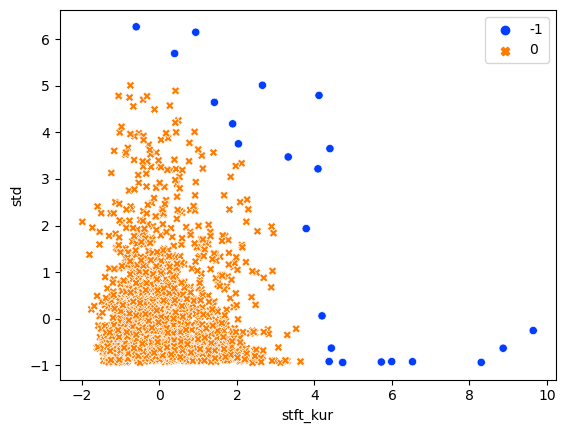

silhouette 0.6457265411727684


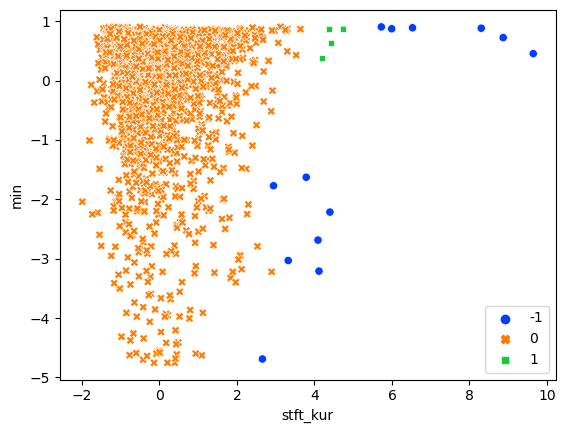

silhouette 0.6451196234699185


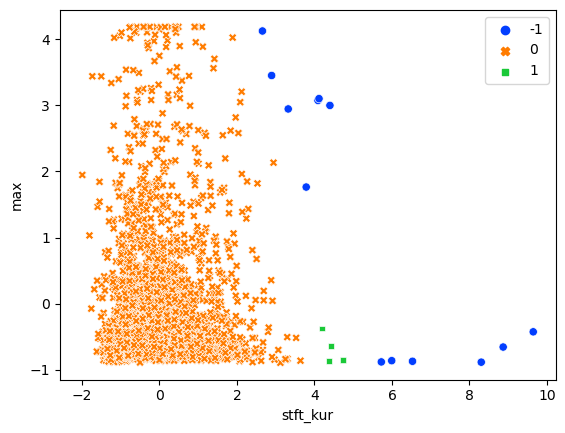

silhouette 0.6230803881029213


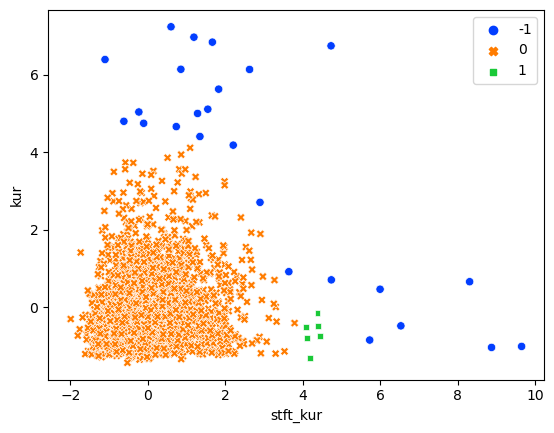

silhouette 0.6023683887904691


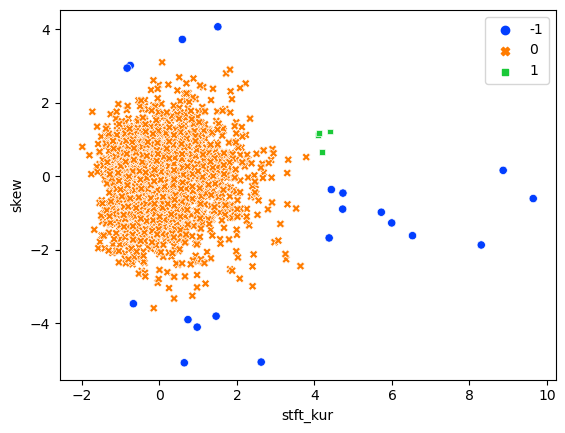

silhouette 0.4388931679423008


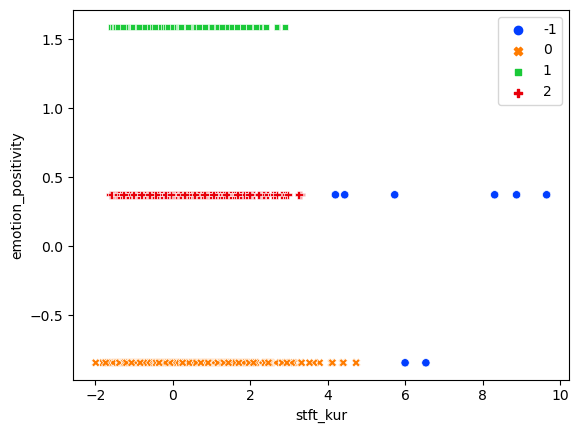

silhouette 0.7067851118333269


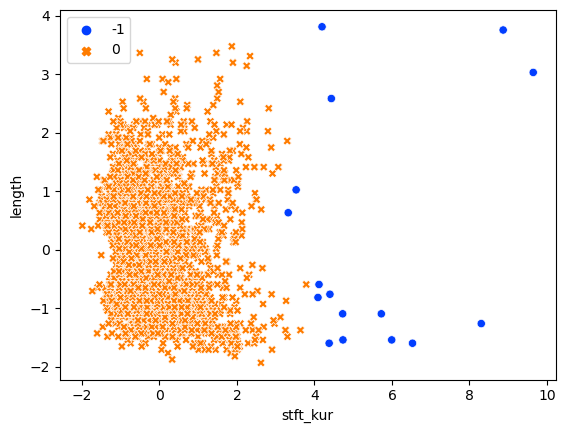

silhouette 0.6967617485296278


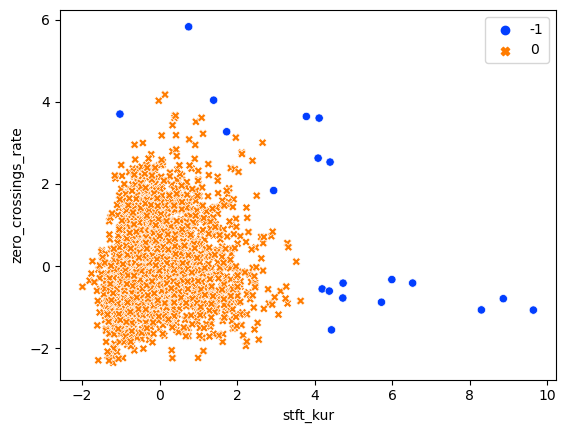

silhouette 0.6176417060112438


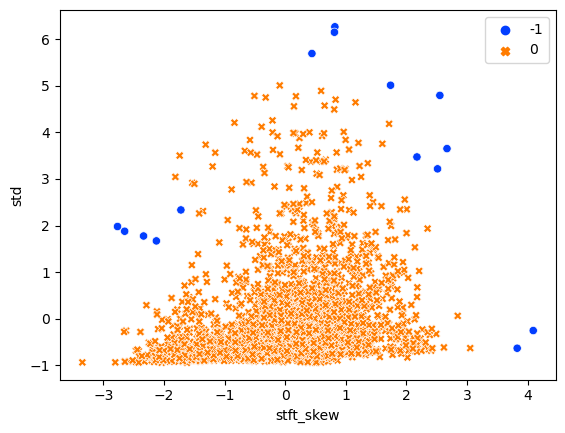

silhouette 0.6015396561821648


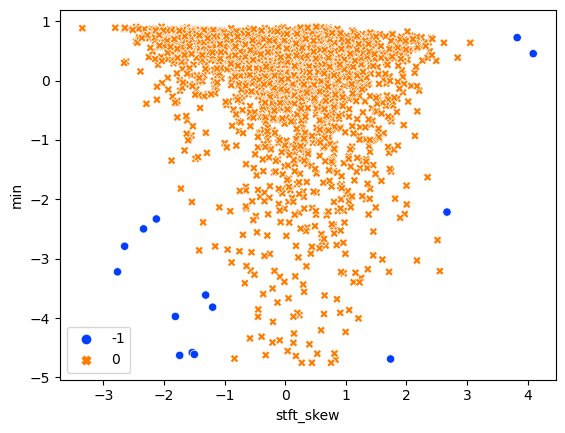

silhouette 0.5785156197840888


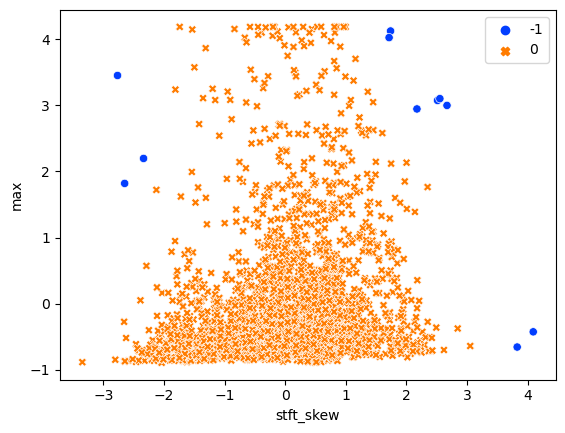

silhouette 0.6974114799405262


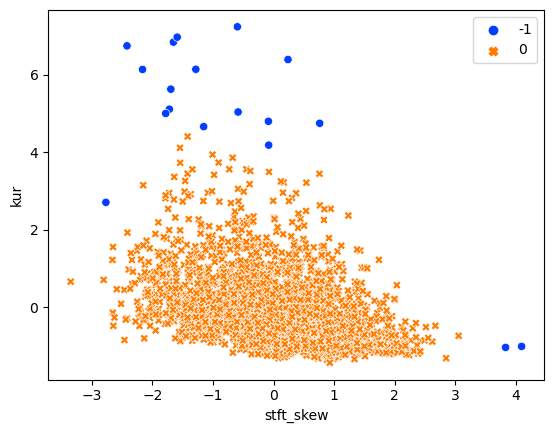

silhouette 0.5913551861939278


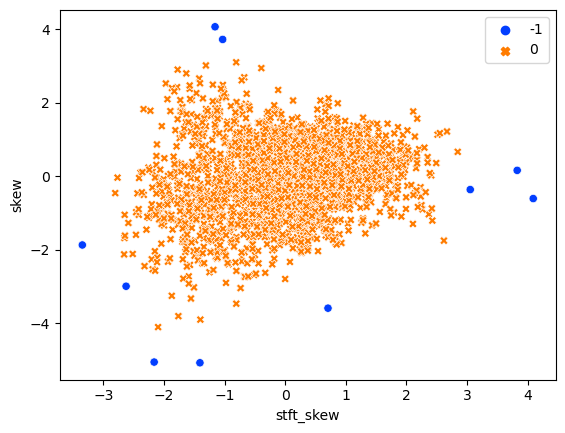

silhouette 0.3909906822943889


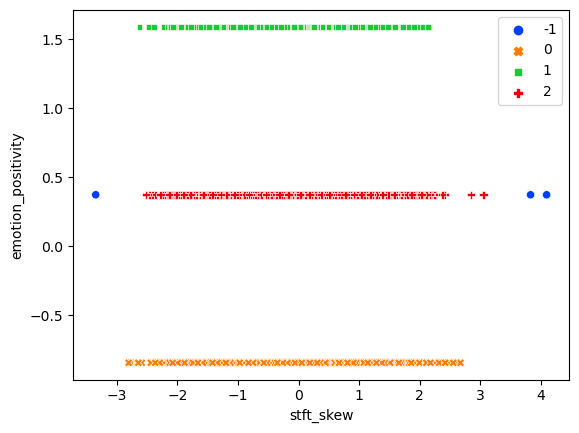

silhouette 0.6269442911702531


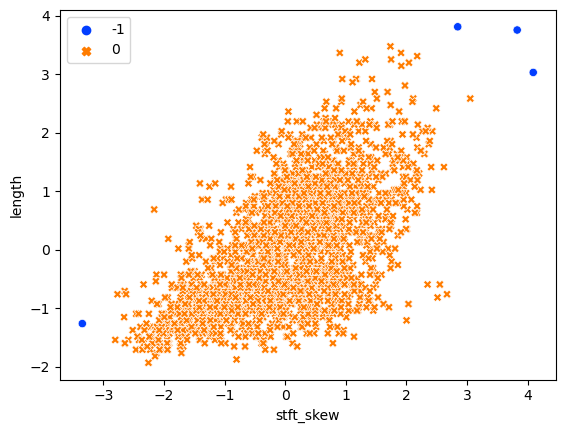

silhouette 0.5790653771575971


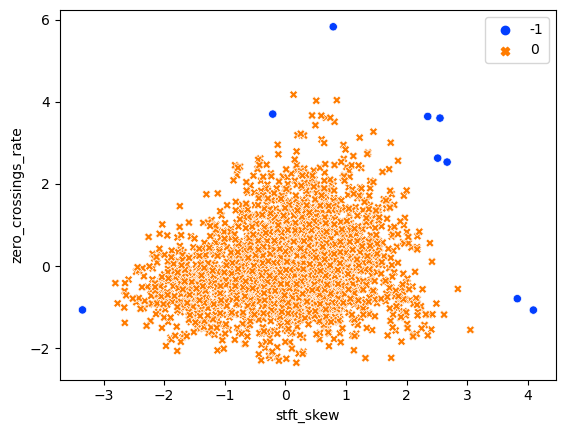

silhouette 0.7664705260808287


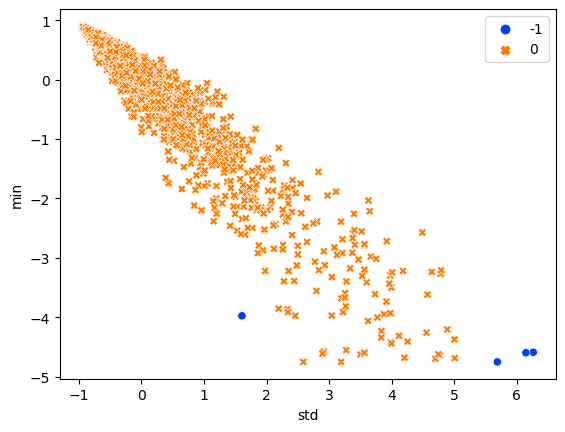

silhouette 0.7801420179152054


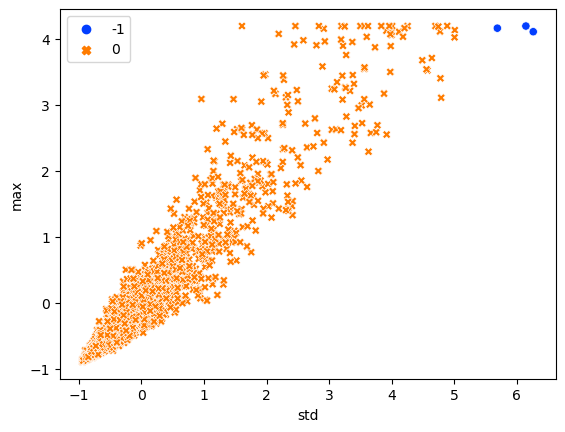

silhouette 0.6440823146572772


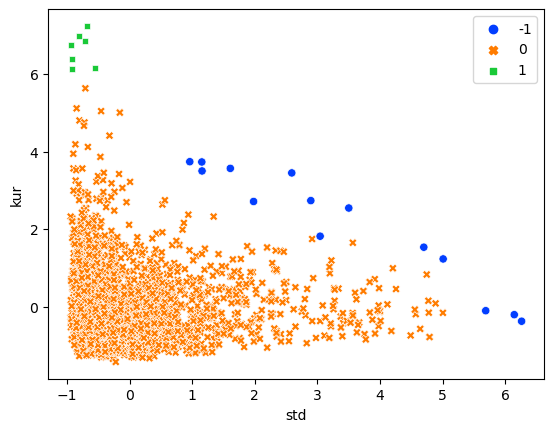

silhouette 0.6560842627935044


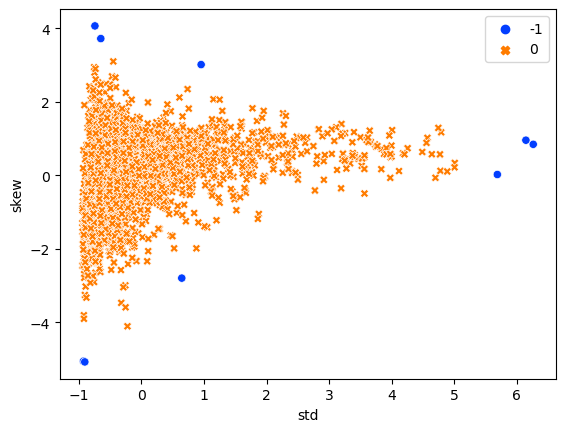

silhouette 0.4645232037100792


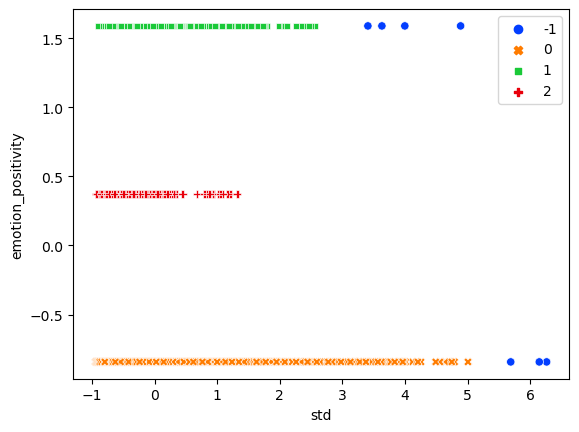

silhouette 0.630543379708565


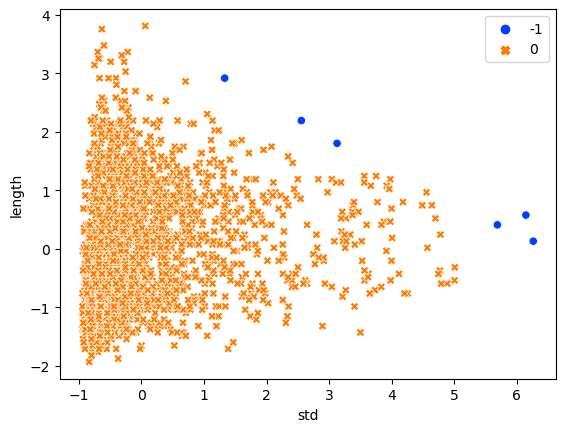

silhouette 0.6796688989472413


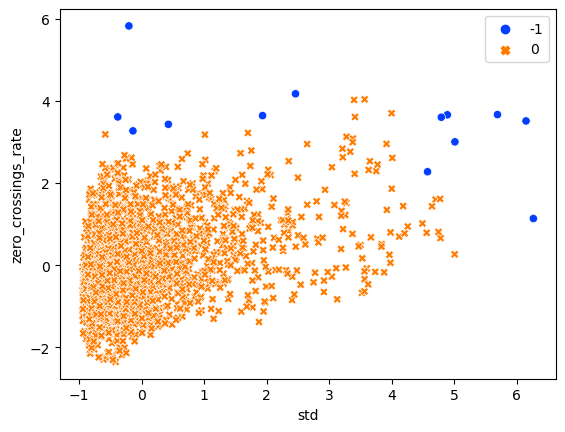

labels {-1: 0, 0: 2452}
silhouette 0.7173377100707163


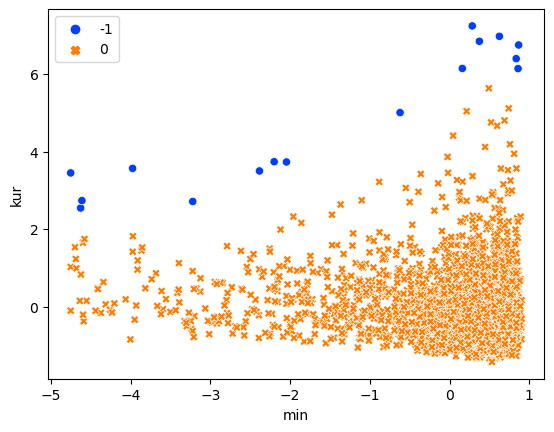

silhouette 0.5971614090619987


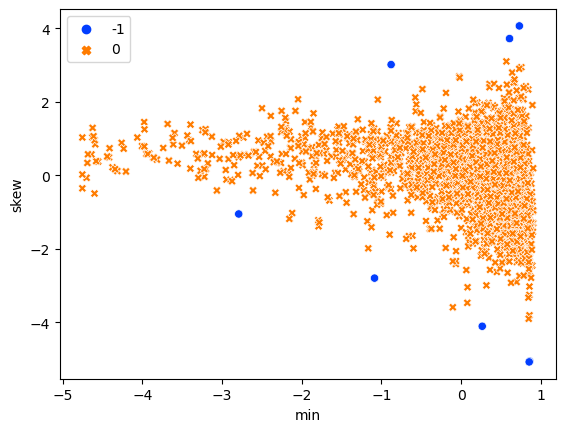

silhouette 0.4727135387667427


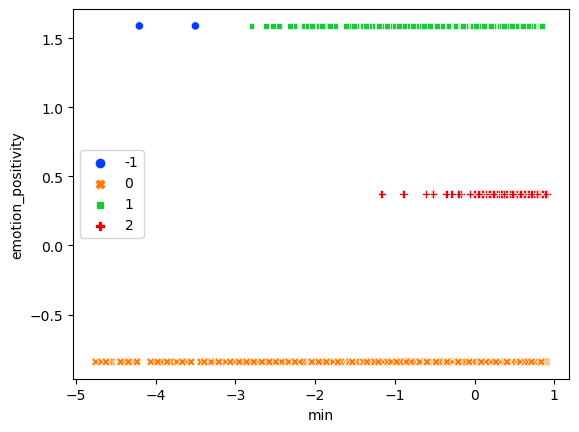

silhouette 0.5479519938878633


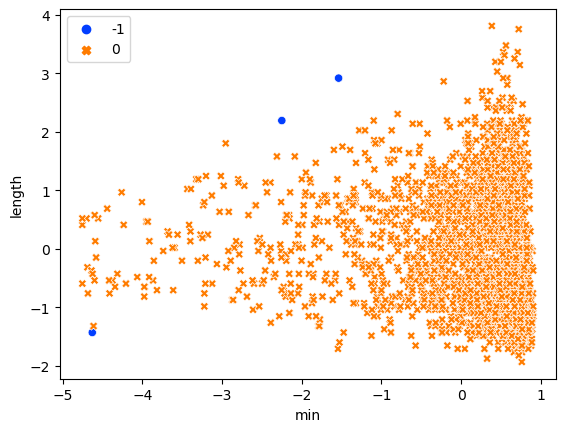

silhouette 0.6803453584884505


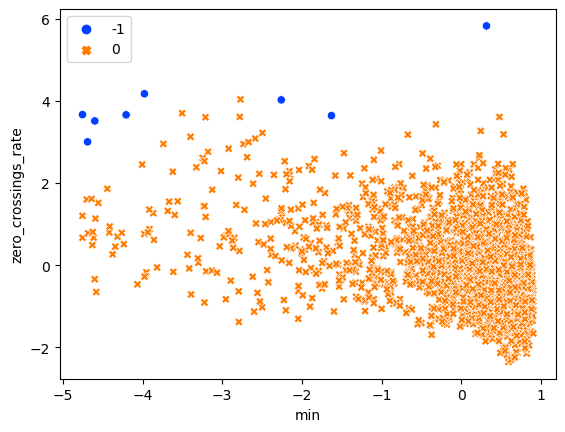

silhouette 0.6680382388028885


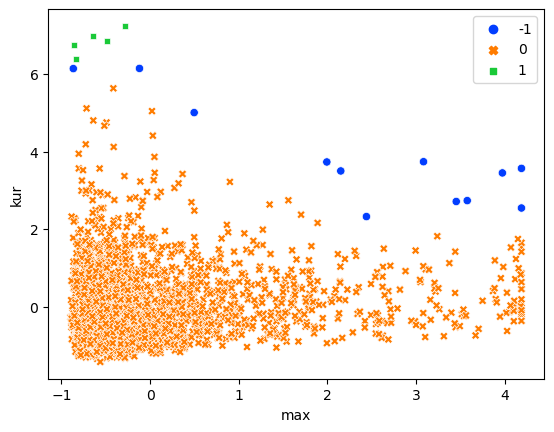

silhouette 0.610020428331474


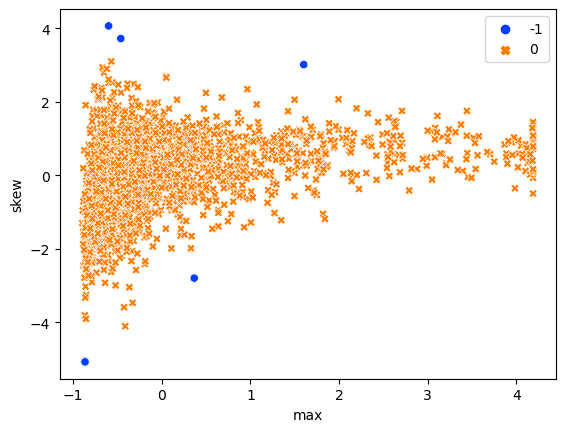

silhouette 0.4719121568754025


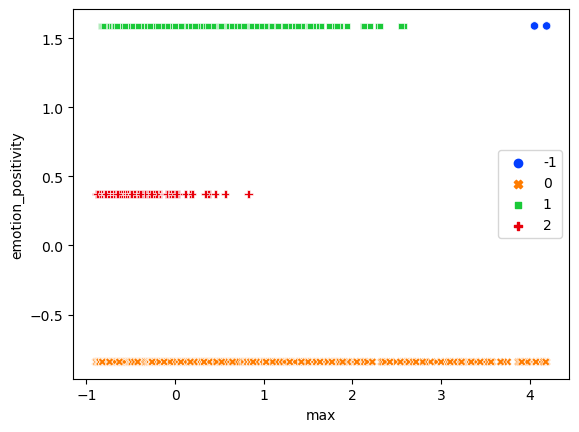

silhouette 0.5623579783895569


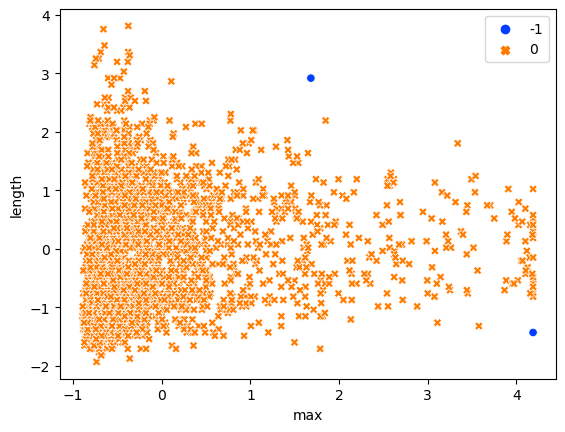

silhouette 0.6530400197473202


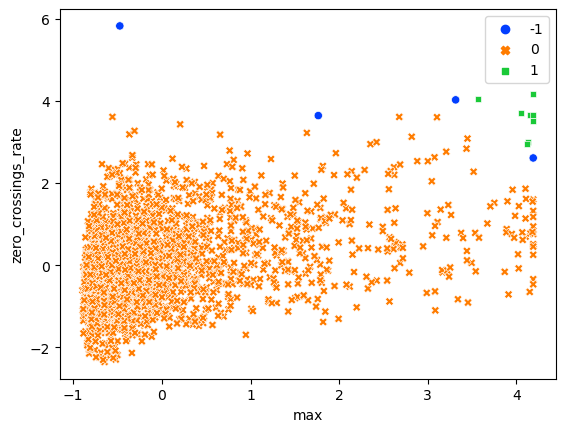

silhouette 0.6786796170078402


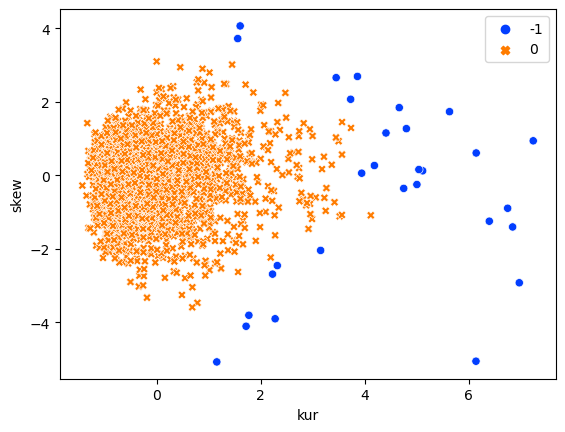

silhouette 0.44240153214773303


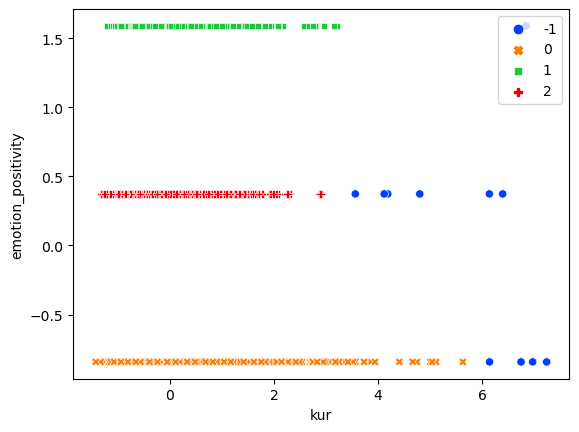

silhouette 0.7110562977454415


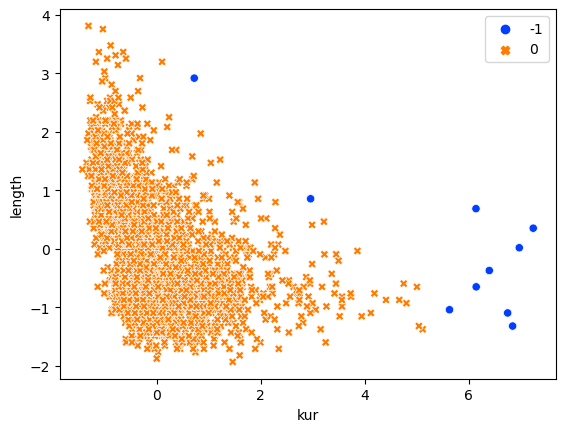

silhouette 0.6961841122172655


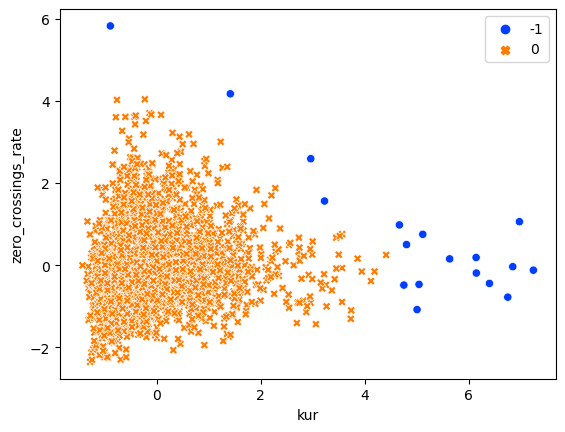

silhouette 0.41636777215319787


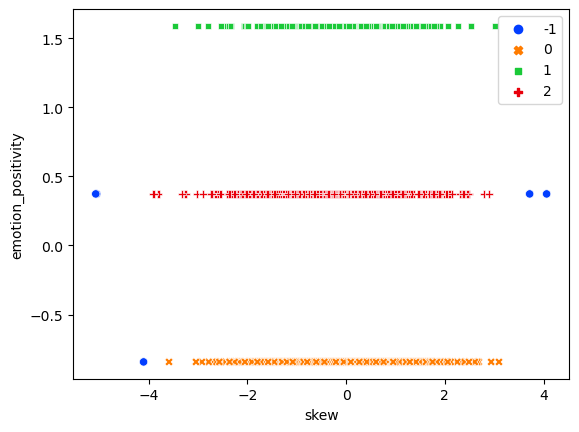

silhouette 0.5984631109119858


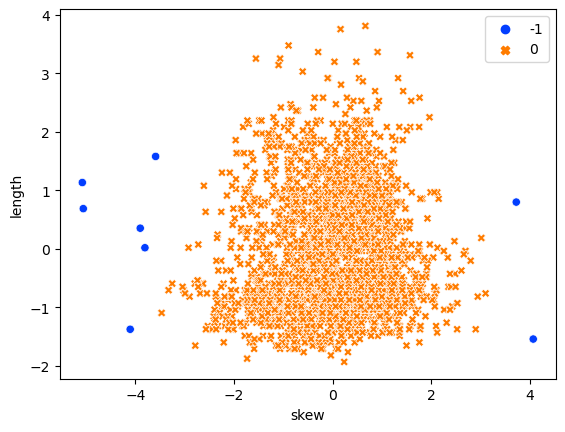

silhouette 0.5950680423810012


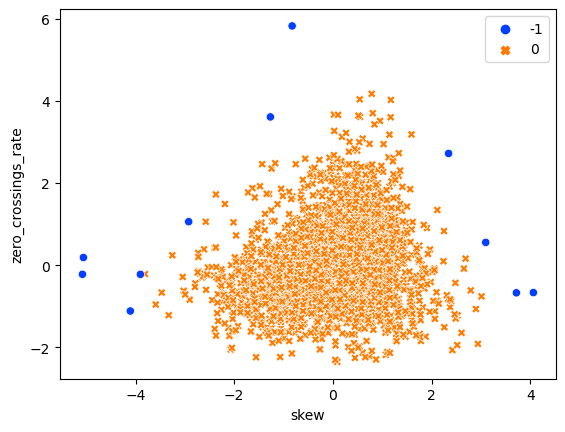

silhouette 0.4038471850664606


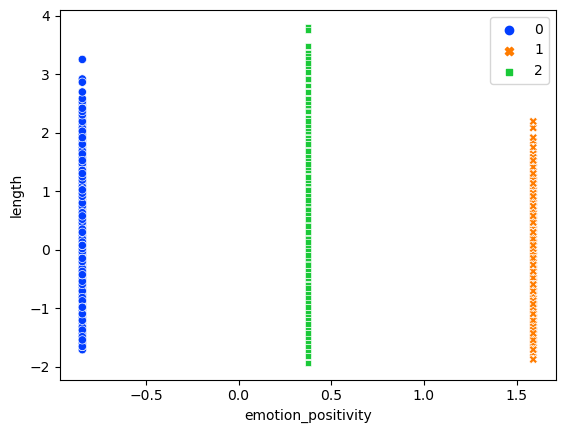

silhouette 0.40034416794161914


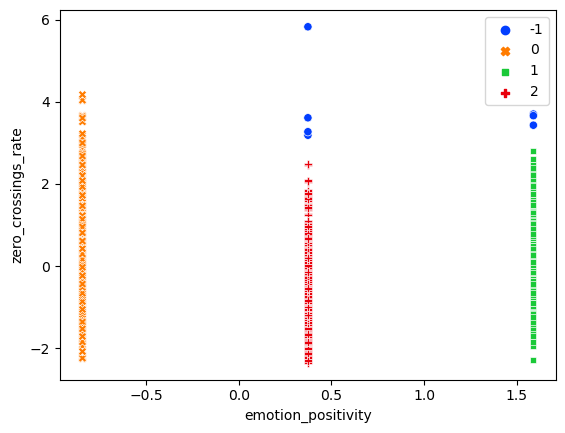

silhouette 0.6057594402555722


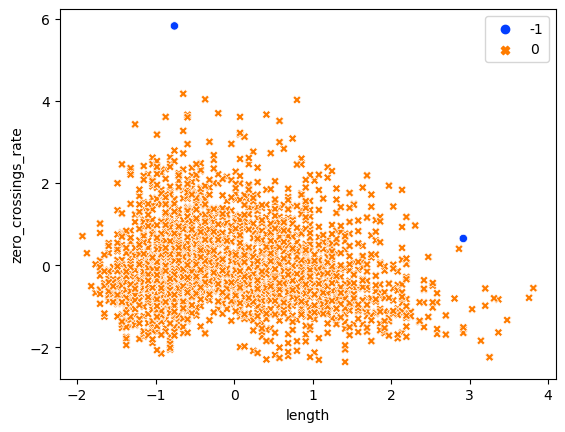

In [72]:
columns_v = stdDf.columns.tolist()
l = len(columns_v)
for i in range(l):
    for j in range(i+1,l):
        DBScanTest(columns_v[i],columns_v[j])

In [ ]:
#DBScan for the df without intensity normalizing
def DBScanTest(var1,var2):
    df_train = df_copy[[var1,var2]]
    
    dbscan = DBSCAN(eps=4, min_samples=5, metric='euclidean')
    dbscan.fit(df_train)

    hist, bins = np.histogram(dbscan.labels_, bins=range(-1, len(set(dbscan.labels_)) + 1))

    labels_c = dict(zip(bins, hist))
#    print(labels_c)
#    val_silh = silhouette_score(df_train, dbscan.labels_)
    
    df_clusters = df_train.copy()
    df_clusters['Labels'] = dbscan.labels_
#    print(df_clusters)
    
    if len(labels_c)!= 2:
        print('silhouette', silhouette_score(df_train, dbscan.labels_))
        sns.scatterplot(data=df_clusters, x=var1, y=var2, hue=dbscan.labels_, 
        style=dbscan.labels_, palette="bright")
        plt.show()
#        return 1
    else:
        print('labels', labels_c)
#        return 0

In [ ]:
#DBScan for the df with intensity
def DBScanTesti(var1,var2):
    df_train = df_num2[[var1,var2]]
    
    dbscan = DBSCAN(eps=0.2, min_samples=5, metric='euclidean')
    dbscan.fit(df_train)

    hist, bins = np.histogram(dbscan.labels_, bins=range(-1, len(set(dbscan.labels_)) + 1))

    labels_c = dict(zip(bins, hist))
#    print(labels_c)
#    val_silh = silhouette_score(df_train, dbscan.labels_)
    
    df_clusters = df_train.copy()
    df_clusters['Labels'] = dbscan.labels_
#    print(df_clusters)
    
    if len(labels_c)!= 2:
        print('silhouette', silhouette_score(df_train, dbscan.labels_))
        sns.scatterplot(data=df_clusters, x=var1, y=var2, hue=dbscan.labels_, 
        style=dbscan.labels_, palette="bright")
        plt.show()
#        return 1
    else:
        print('labels', labels_c)
#        return 0

In [ ]:
columns_v = df_num2.columns.tolist()
l = len(columns_v)
for i in range(l):
    for j in range(i+1,l):
        DBScanTesti(columns_v[i],columns_v[j])

It's not good idea to replace the missing values of intensity with the mean, because the clustering shows that this damage the polynomial correlation of intensity with the other variables. So, for now we will work only without intensity. 

In [ ]:
df_train = df_copy
for i in [3, 5, 10,11, 15, 18, 20, 25, 28, 32, 41, 57, 77, 110, 200] :
    neighbors = NearestNeighbors(n_neighbors=i,metric='euclidean')
    neighbors_fit = neighbors.fit(df_train)
    distances, indices = neighbors_fit.kneighbors(df_train)
    distances = np.sort(distances, axis=0)
    distances = distances[:,1]
    plt.xlabel('ordered points')
    plt.ylabel('{} nearest distance'.format(i))
    plt.plot(distances)
    plt.grid()
    plt.show()

In [ ]:
df_train = df_copy
neighbors = NearestNeighbors(n_neighbors=2000,metric='minkowski')
neighbors_fit = neighbors.fit(df_train)
distances, indices = neighbors_fit.kneighbors(df_train)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.xlabel('ordered points')
plt.ylabel('200 nearest distance')
plt.plot(distances)
plt.grid()
plt.show()

In [ ]:
df_train = df_copy
neighbors = NearestNeighbors(n_neighbors=2000,metric='minkowski')
neighbors_fit = neighbors.fit(df_train)
distances, indices = neighbors_fit.kneighbors(df_train)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.xlabel('ordered points')
plt.ylabel('200 nearest distance')
plt.plot(distances)
plt.grid()
plt.show()

### OPTICS

In [ ]:
from sklearn.cluster import OPTICS

In [ ]:
df_train = df_copy[["stft_std","mfcc_std"]]

In [ ]:
optics = OPTICS(eps=0.3, min_samples=10, metric='euclidean')
optics.fit(df_train)

hist, bins = np.histogram(optics.labels_, bins=range(-1, len(set(dbscan.labels_)) + 1))

print('labels', dict(zip(bins, hist)))
print('silhouette', silhouette_score(df_train, optics.labels_))

In [ ]:
df_clusters = df_train.copy()
df_clusters['Labels'] = optics.labels_

In [ ]:
sns.scatterplot(data=df_clusters, x="stft_std", y="mfcc_std", hue=optics.labels_, 
                style=optics.labels_, palette="bright")
plt.show()